In [332]:
import glob
import cv2
import cv2.cv2
import numpy as np
from mmocr.utils.ocr import MMOCR
import matplotlib.pyplot as plt
import time
import numpy as np
import argparse
import time
import cv2
import pytesseract
import numpy as np
import cv2
from imutils.object_detection import non_max_suppression
import pytesseract
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
import math

In [333]:
ocr = MMOCR(det='TextSnake', recog='CRNN_TPS')

# Inference
# for filename in glob.glob("./data/*.jpeg"):
#     print(filename)
#     results = ocr.readtext(filename, output = "./results")

Use load_from_http loader
Use load_from_http loader


In [334]:
files = glob.glob("data/*.jpg")
file = files[3]

In [335]:
def show_image(image):
	figure(figsize = (8,6), dpi = 200)
	plt.imshow(image)
	plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
	plt.show()

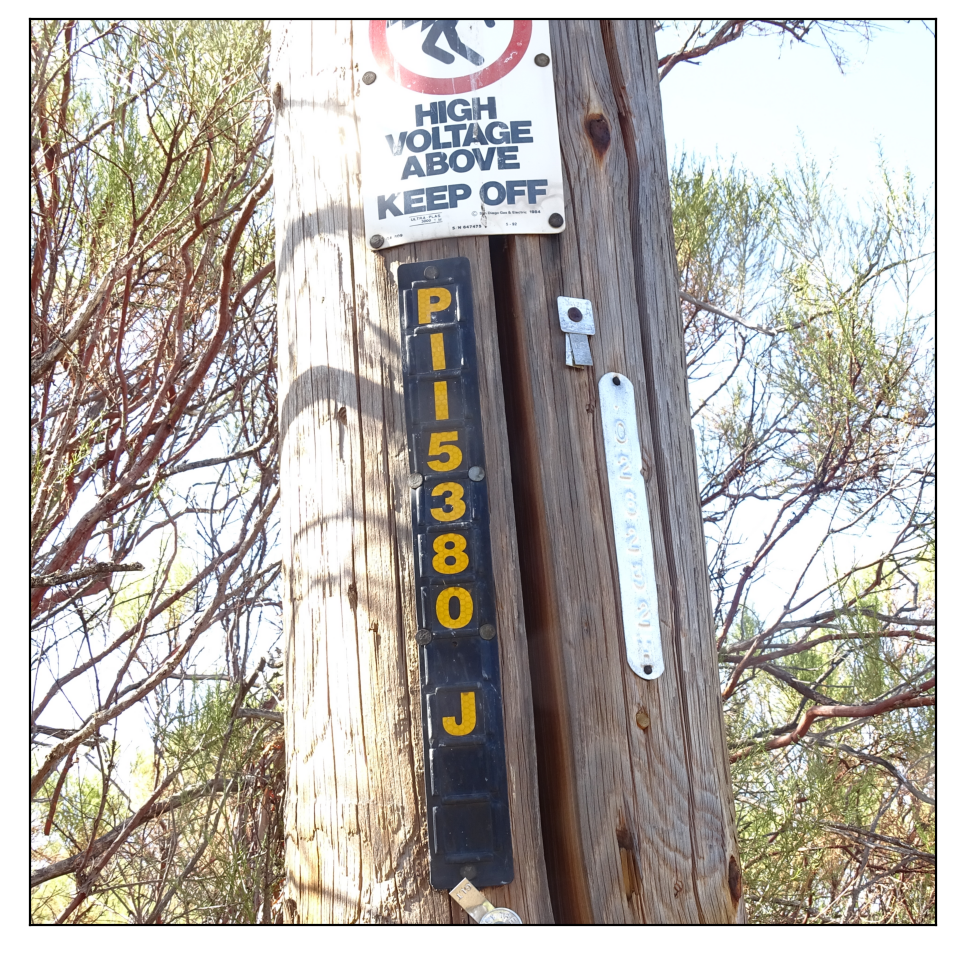

In [336]:
best_image = cv2.imread(file)
img = cv2.imread(file)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
show_image(img)

In [337]:
def crop_image(img_c, scale=1.0):
    center_x, center_y = img_c.shape[1] / 2, img_c.shape[0] / 2
    width_scaled, height_scaled = img_c.shape[1] * scale, img_c.shape[0] * scale
    left_x, right_x = center_x - width_scaled / 2, center_x + width_scaled / 2
    top_y, bottom_y = center_y - height_scaled / 2, center_y + height_scaled / 2
    img_cropped = img_c[int(top_y):int(bottom_y), int(left_x):int(right_x)]
    return img_cropped

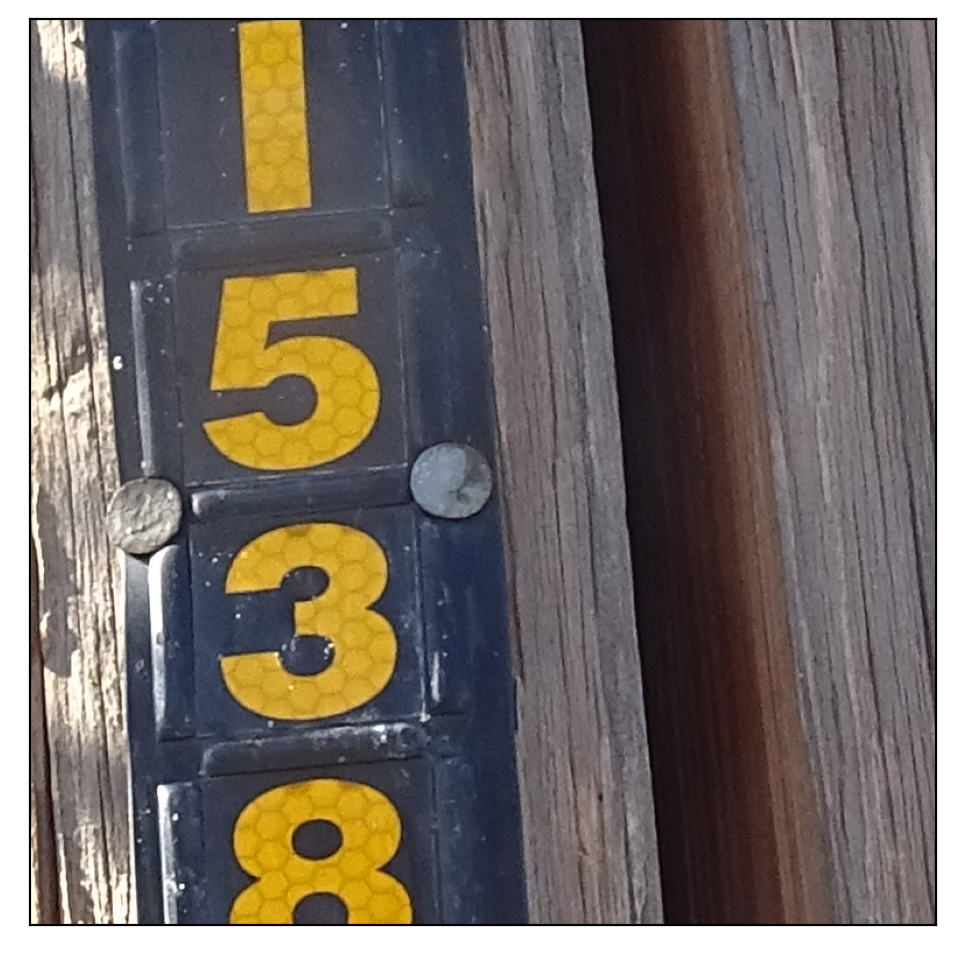

In [338]:
crop = crop_image(img, 0.2)
show_image(crop)

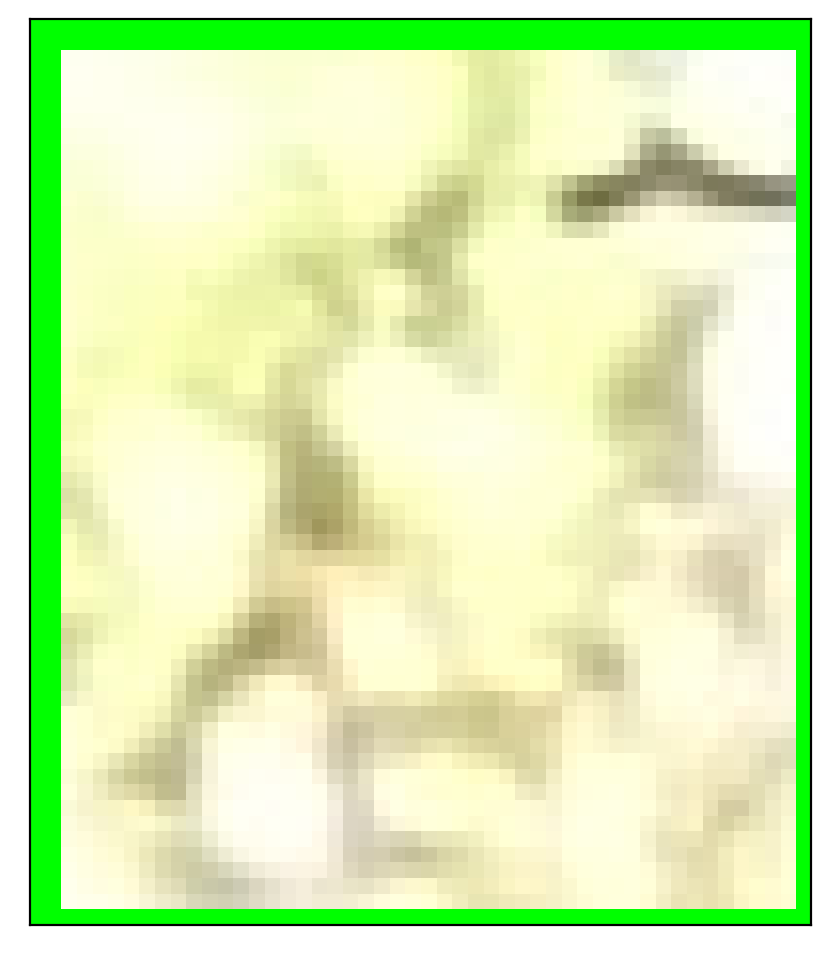

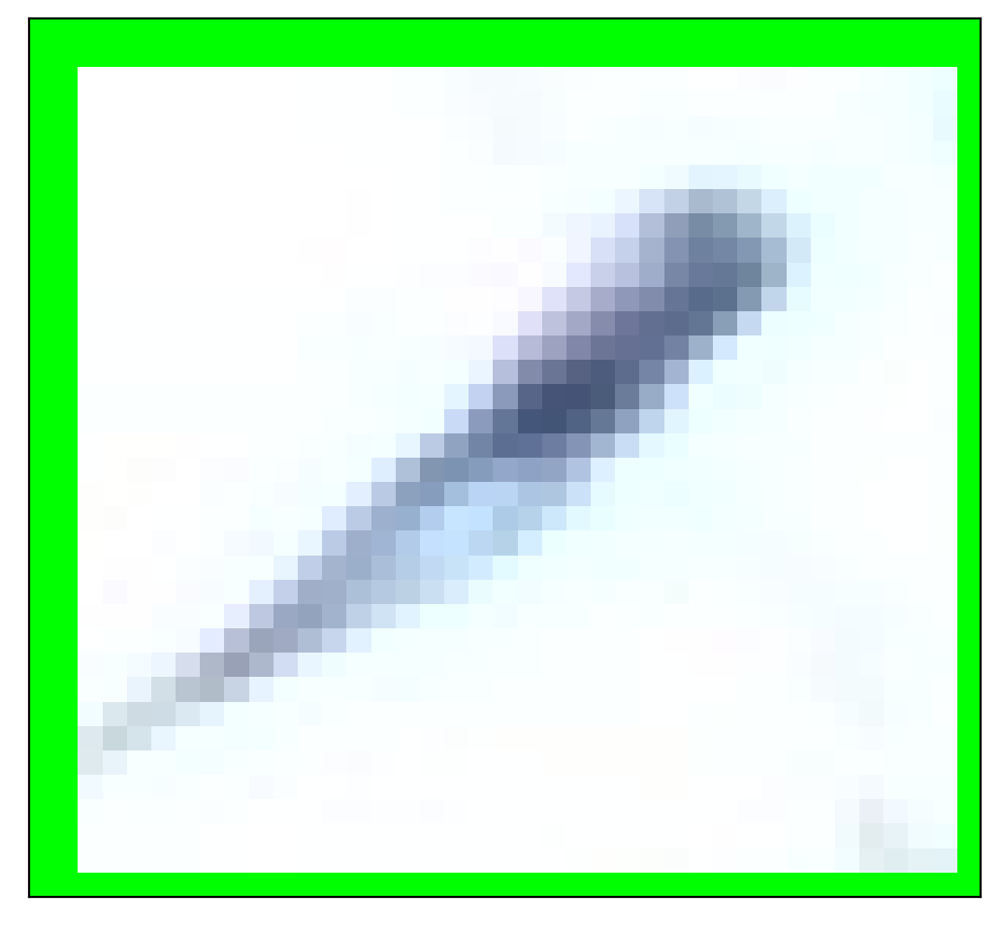

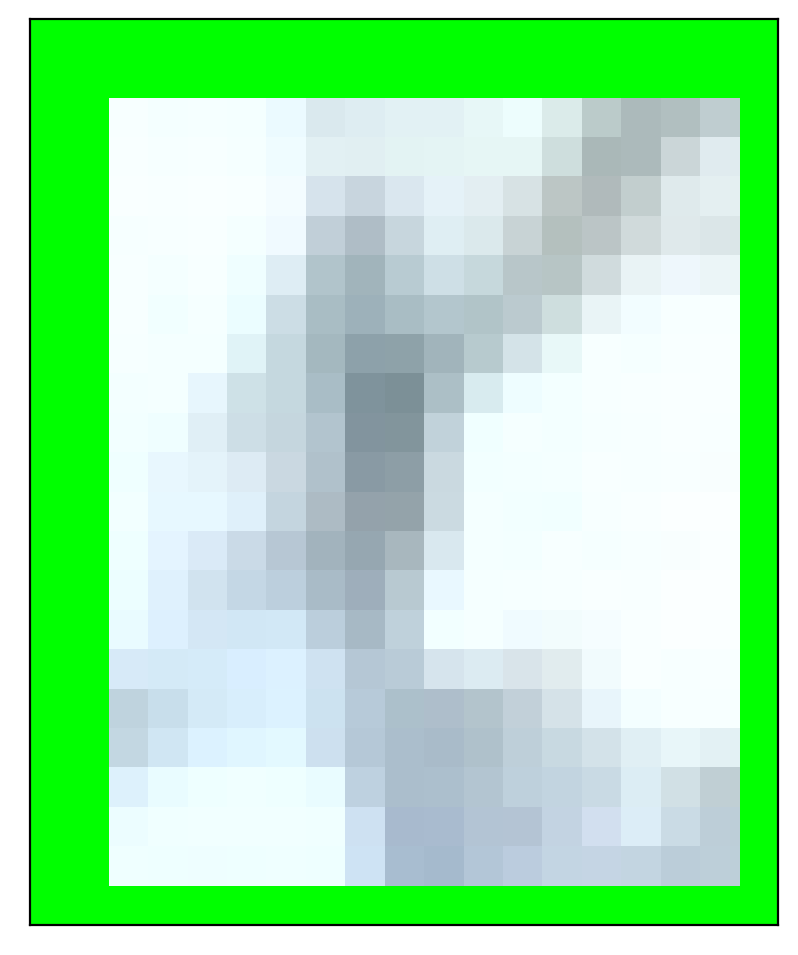

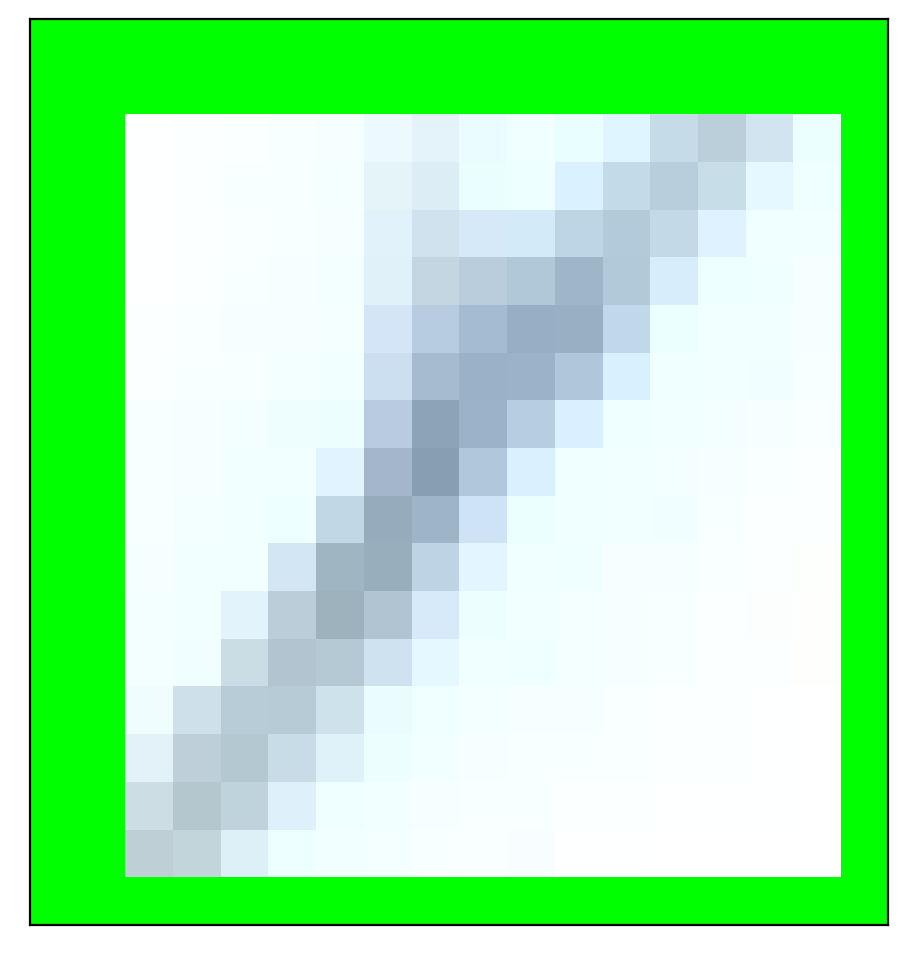

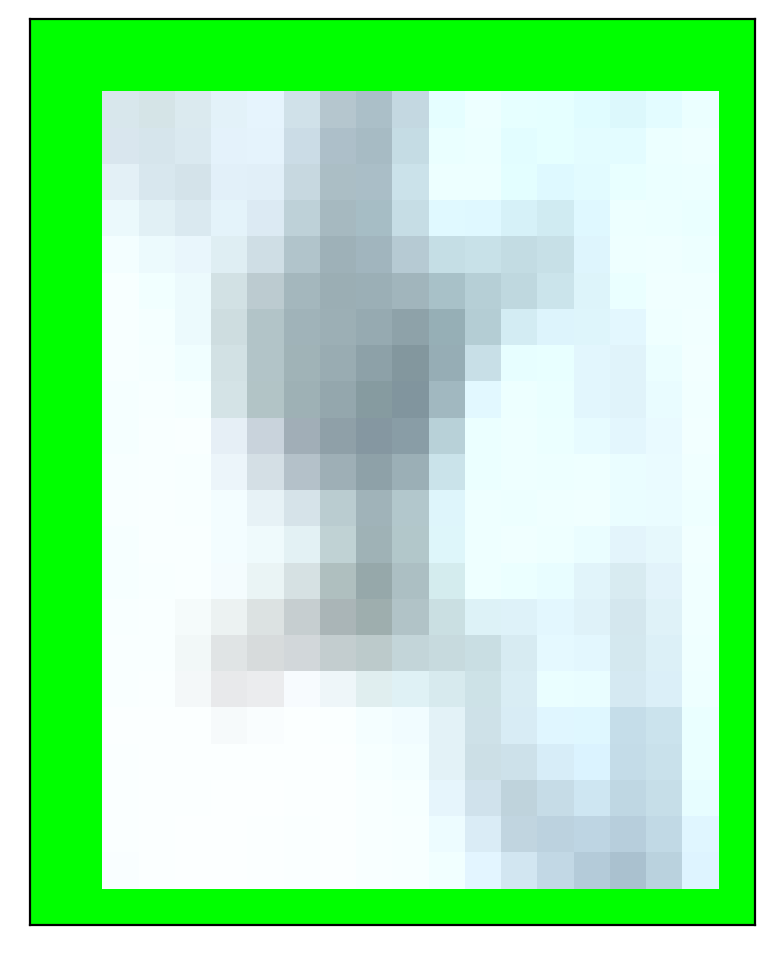

...

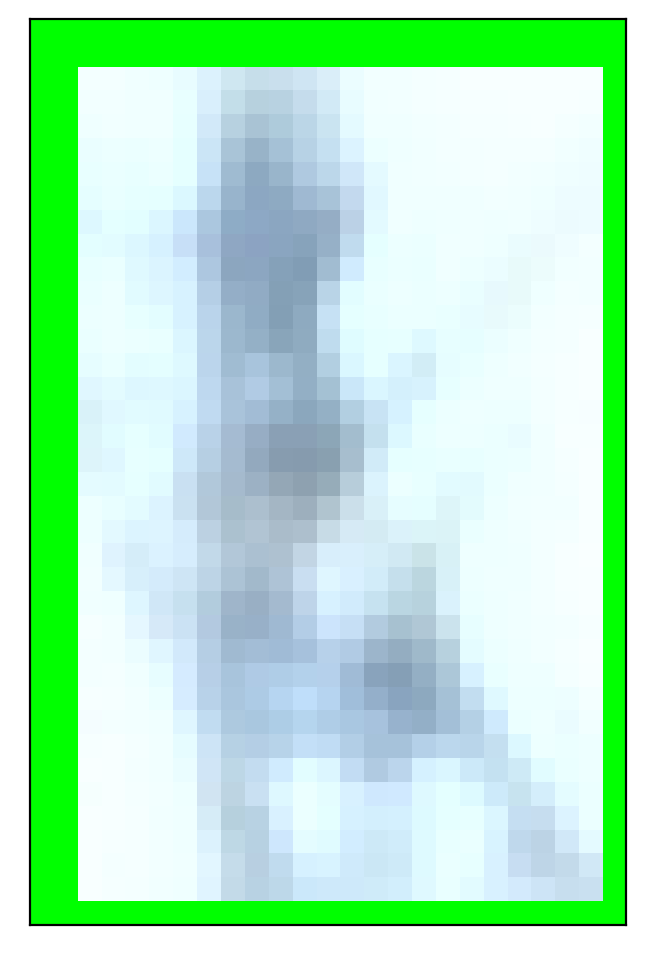

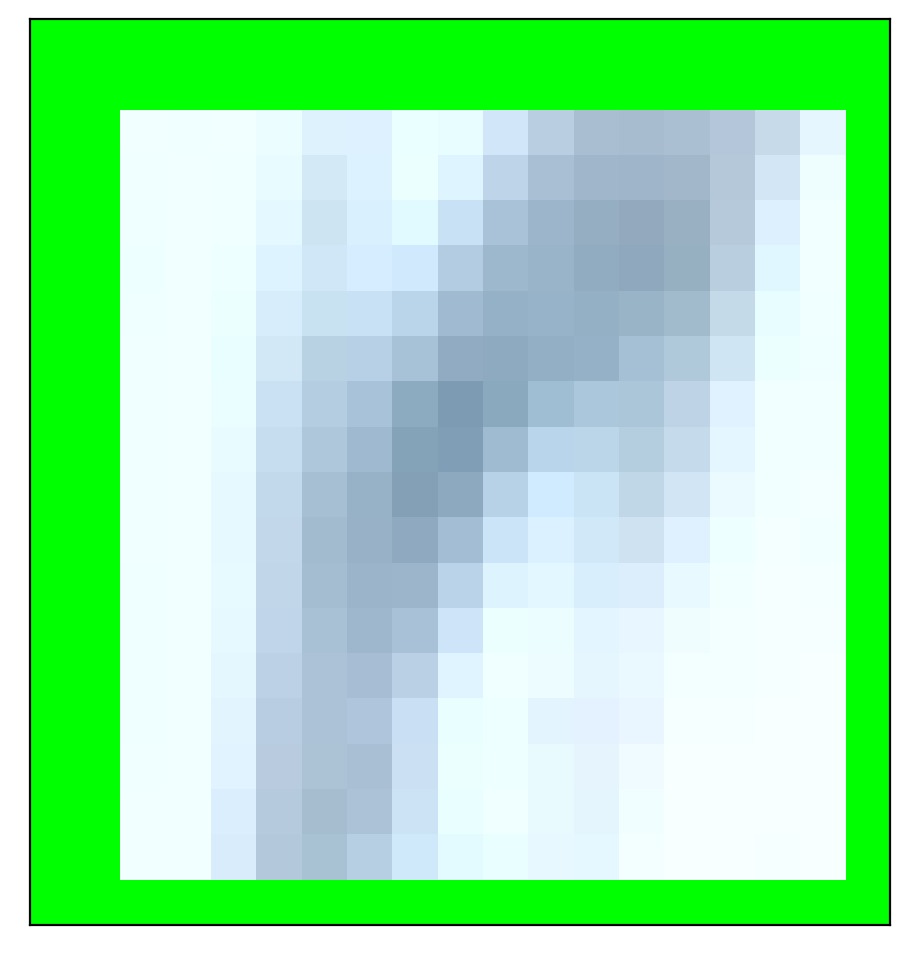

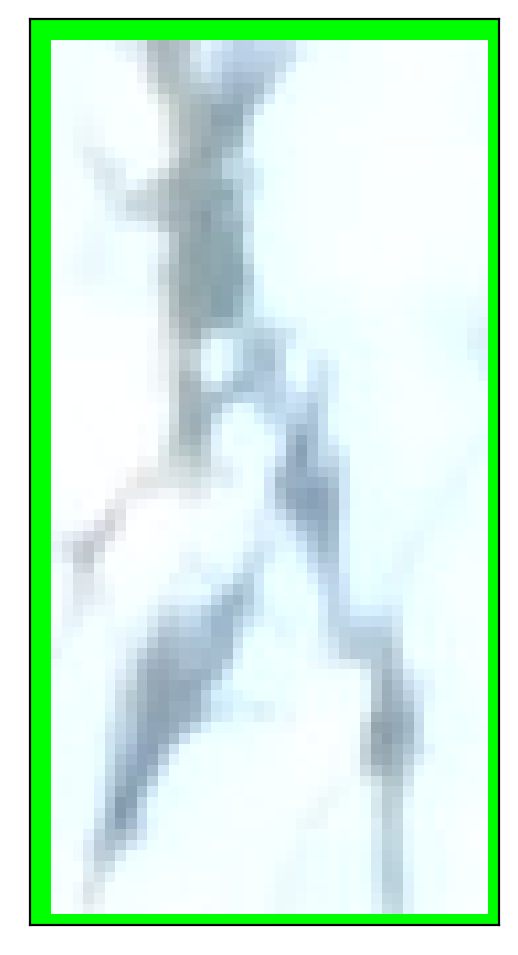

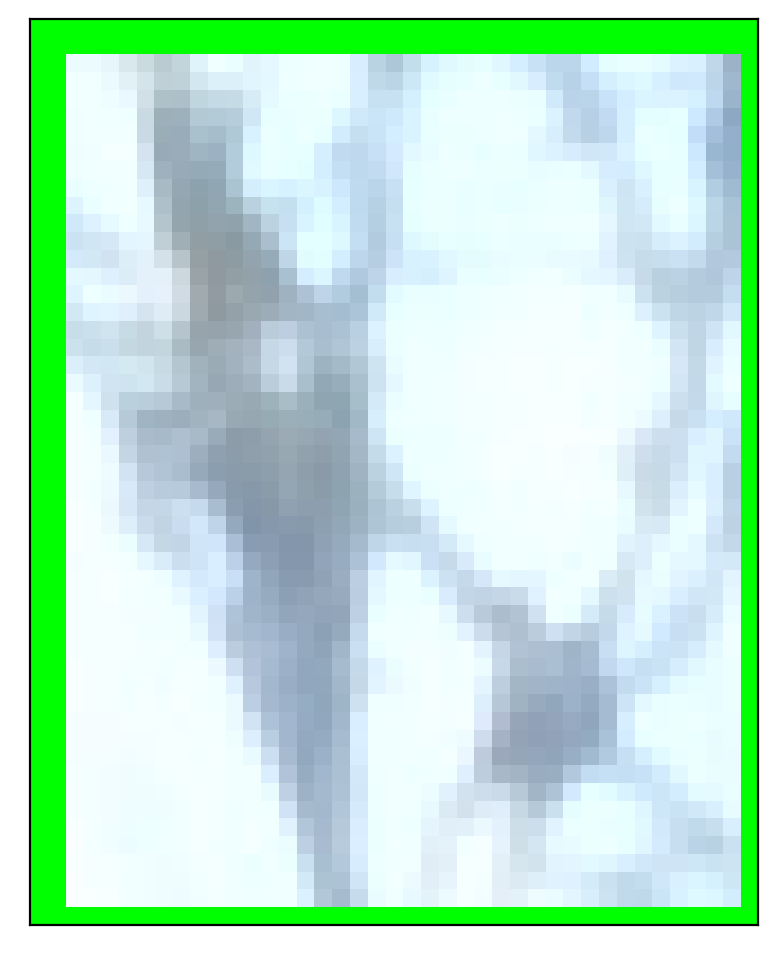

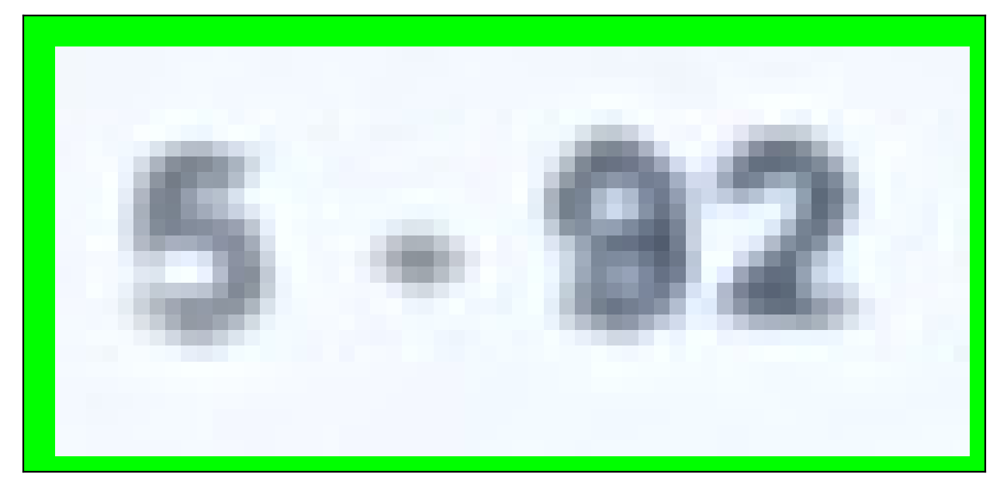

 

 

5-92

 

 



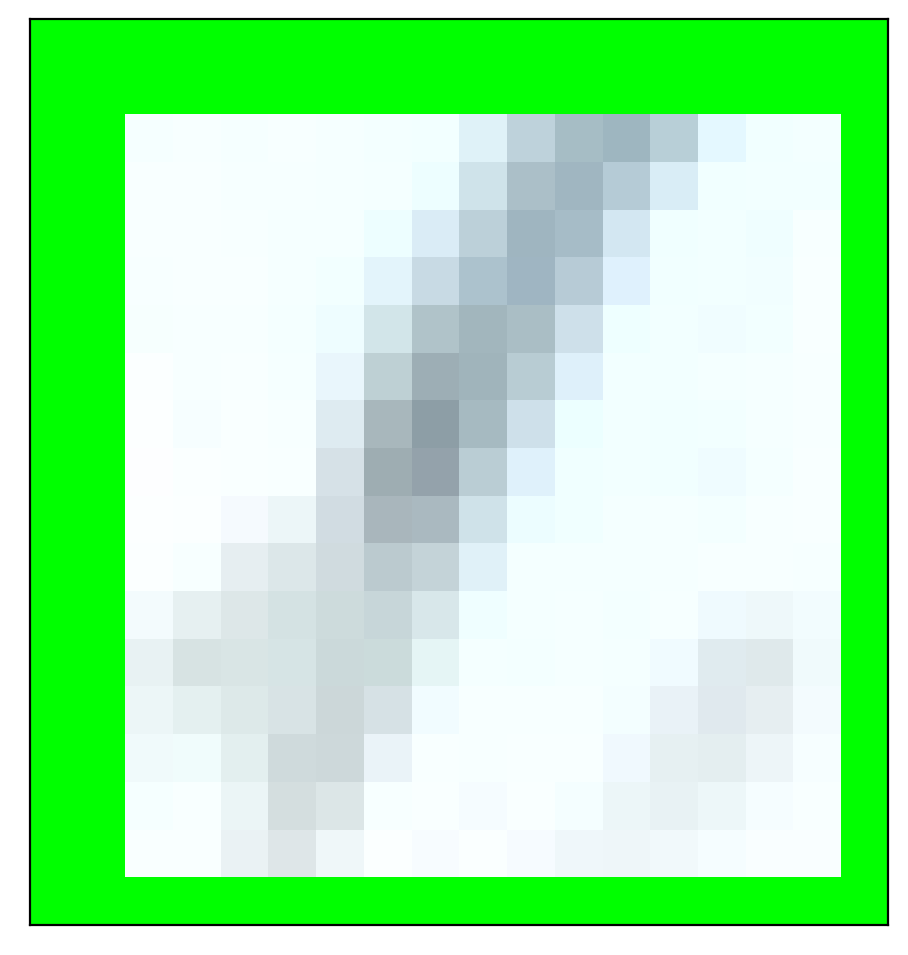

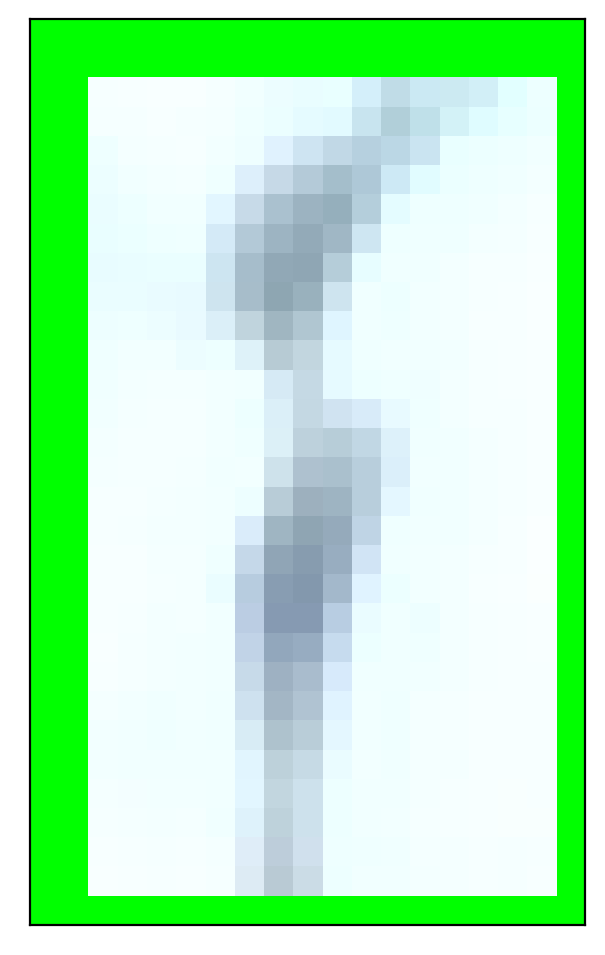

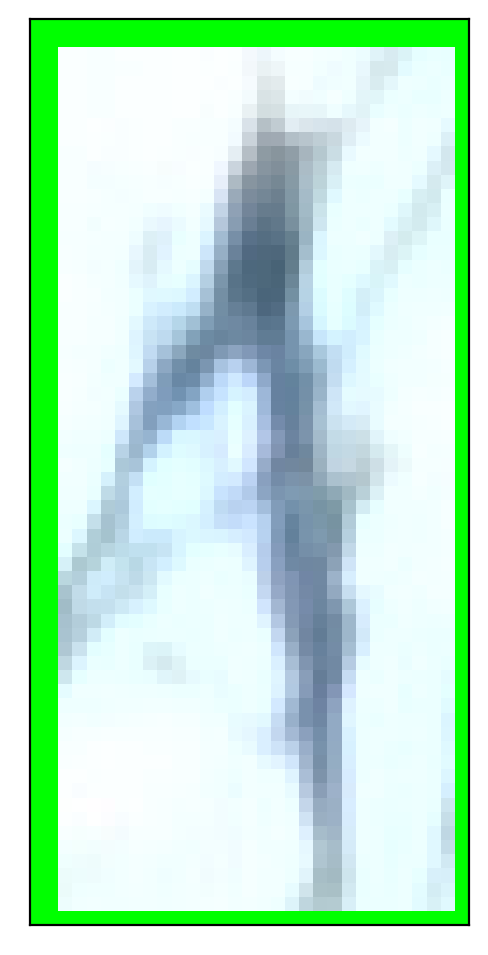

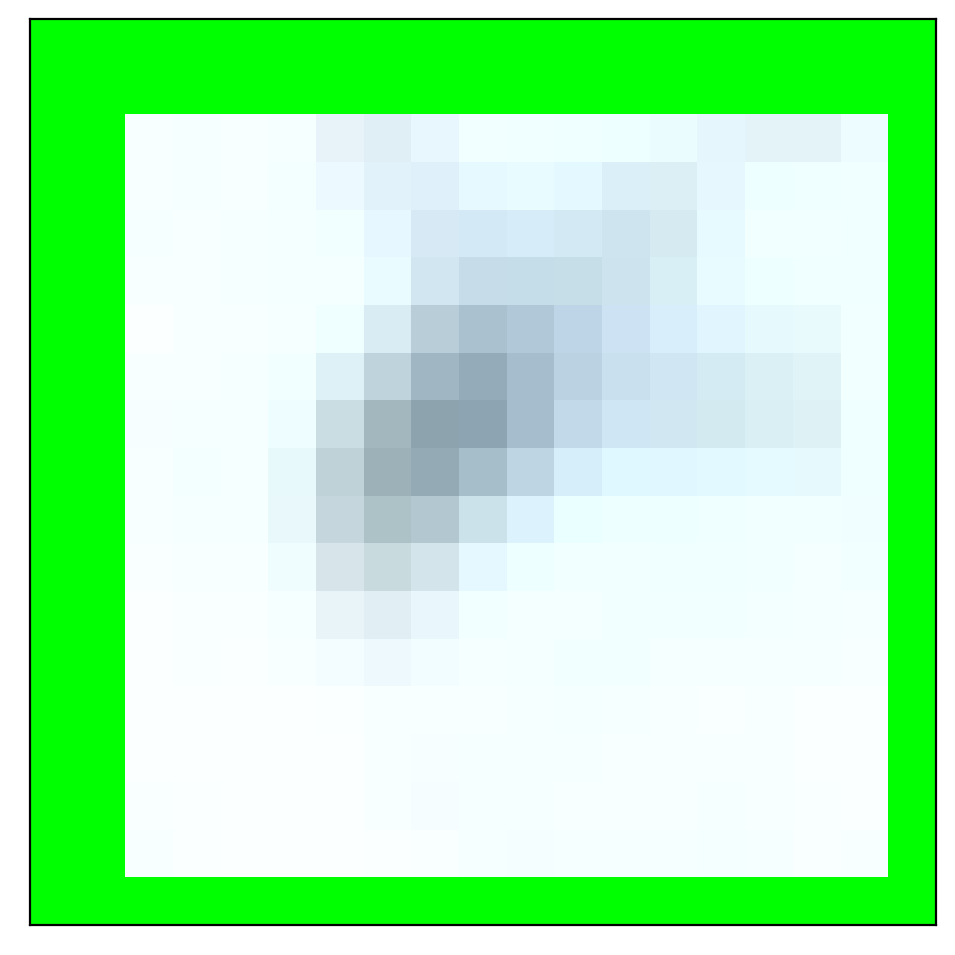

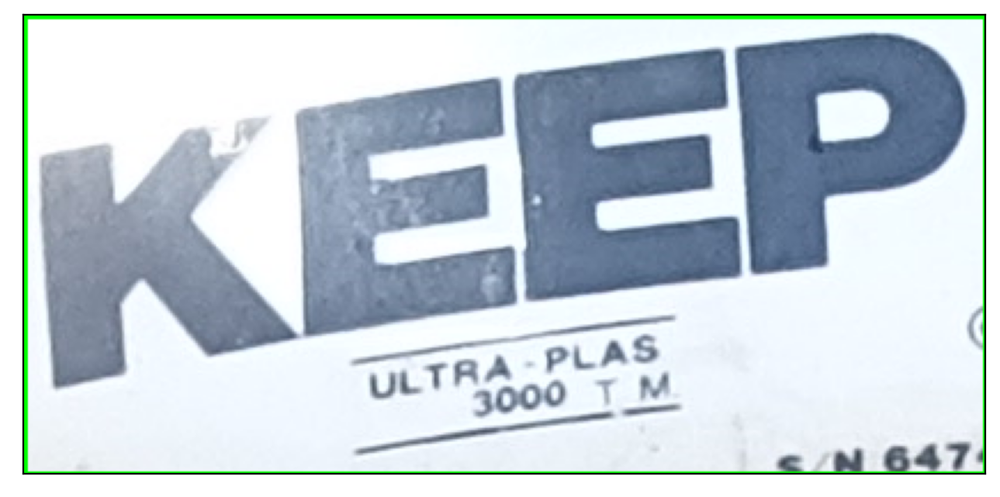

—
DLT RA PLAS
3000 1M

<M 647:



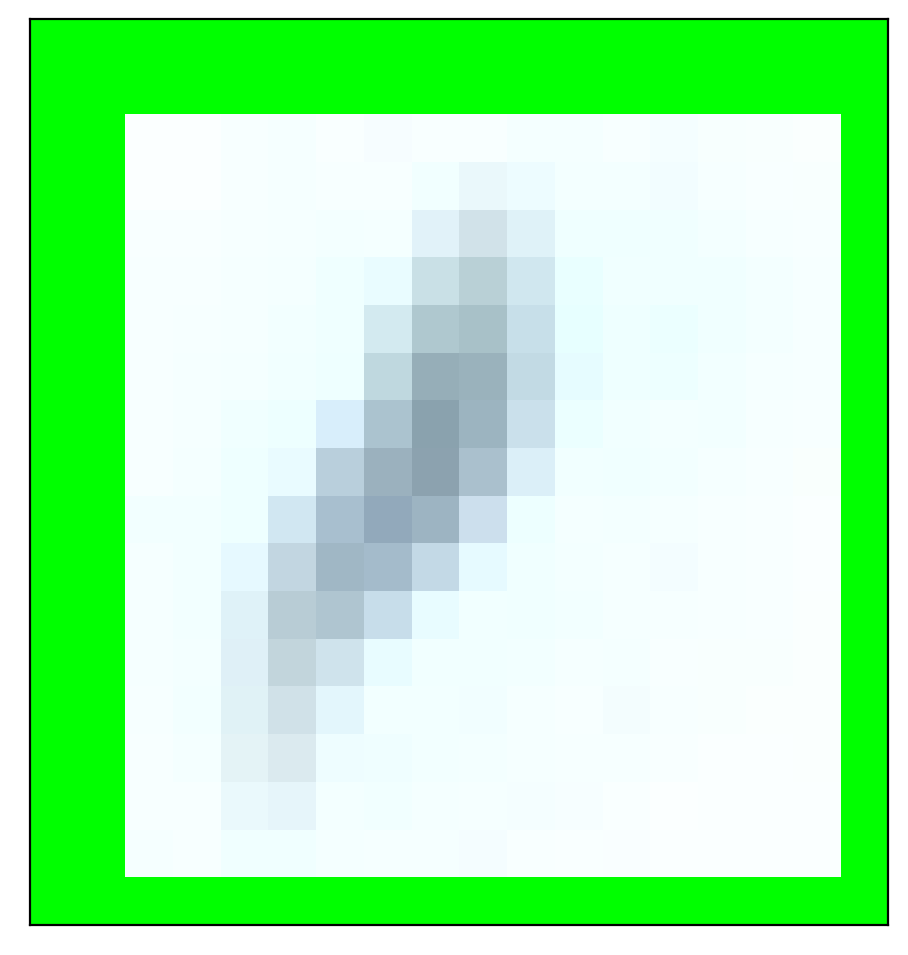

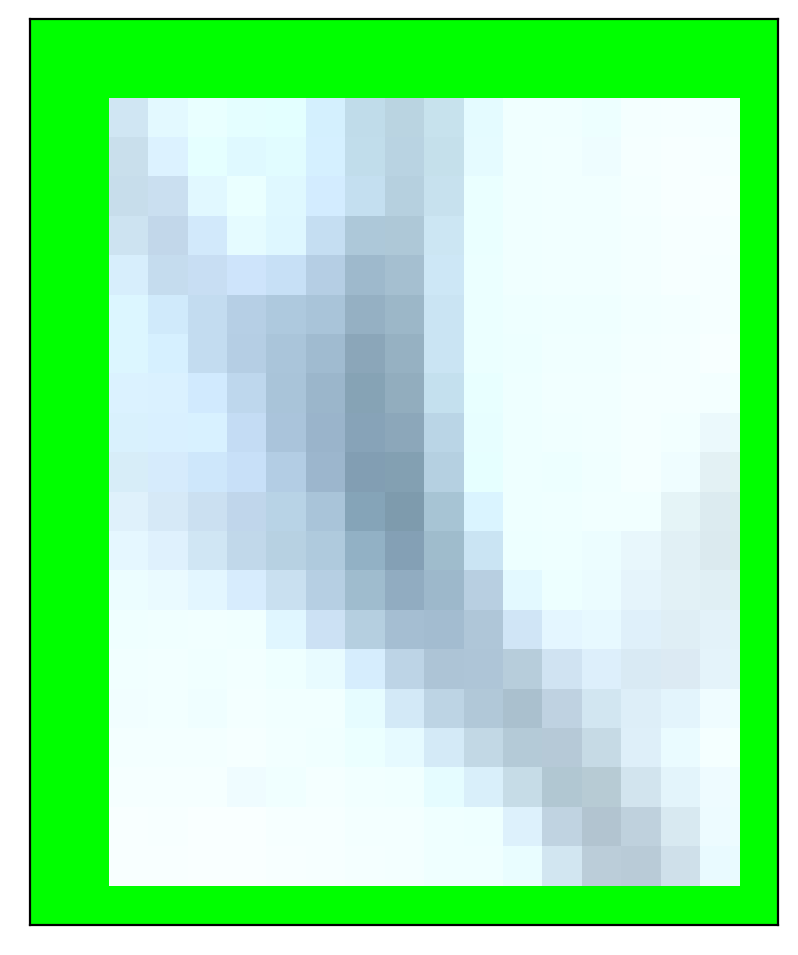

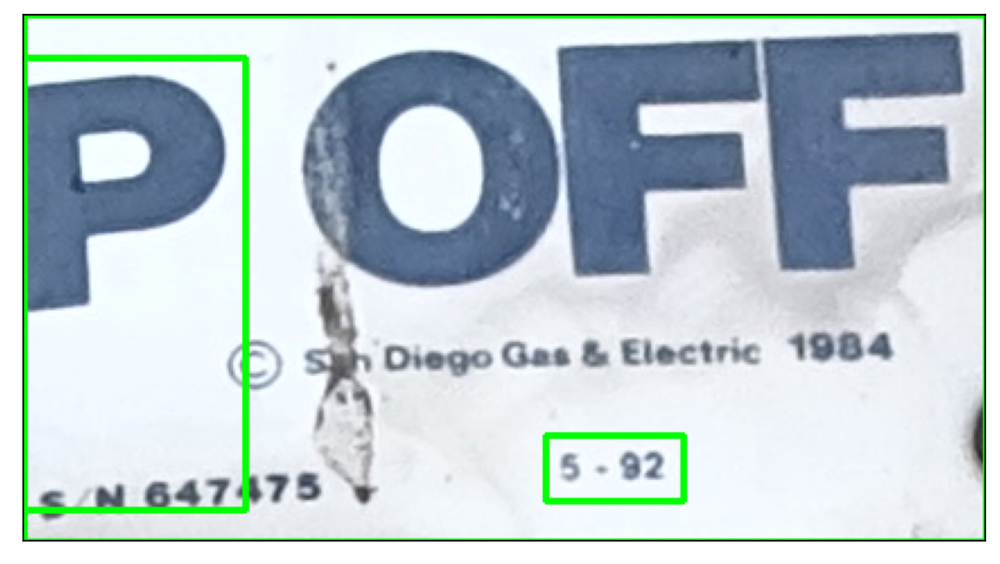

P

OFF

© Proven ou tec 1984
my
7 5-92

$M 647475 v



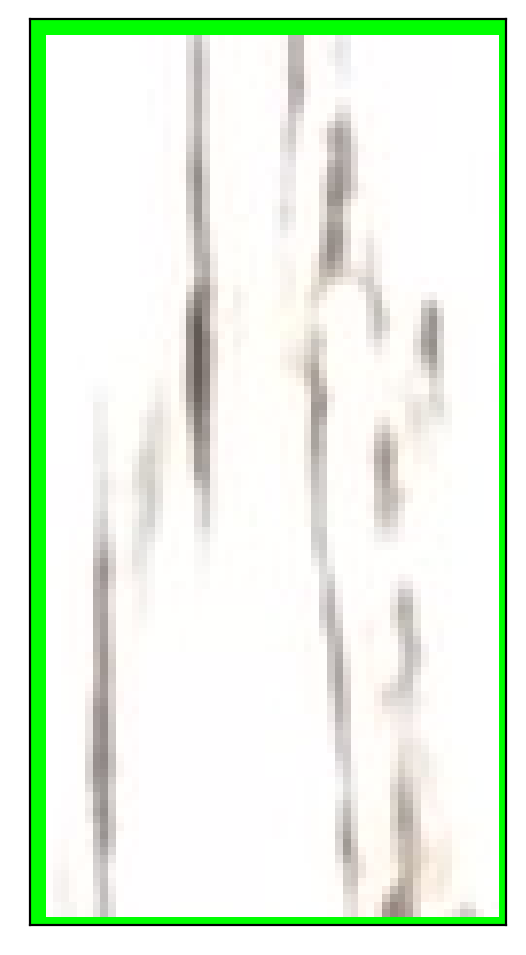

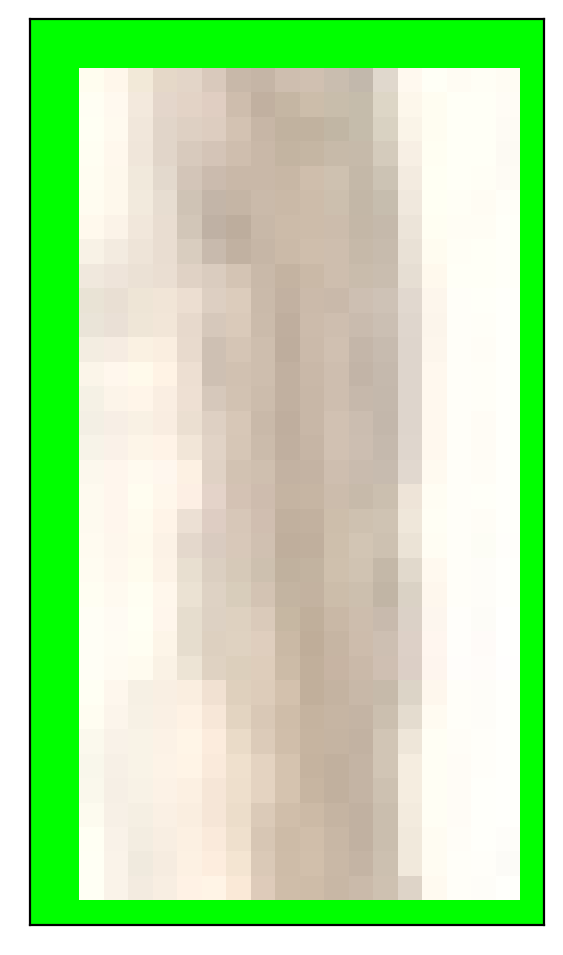

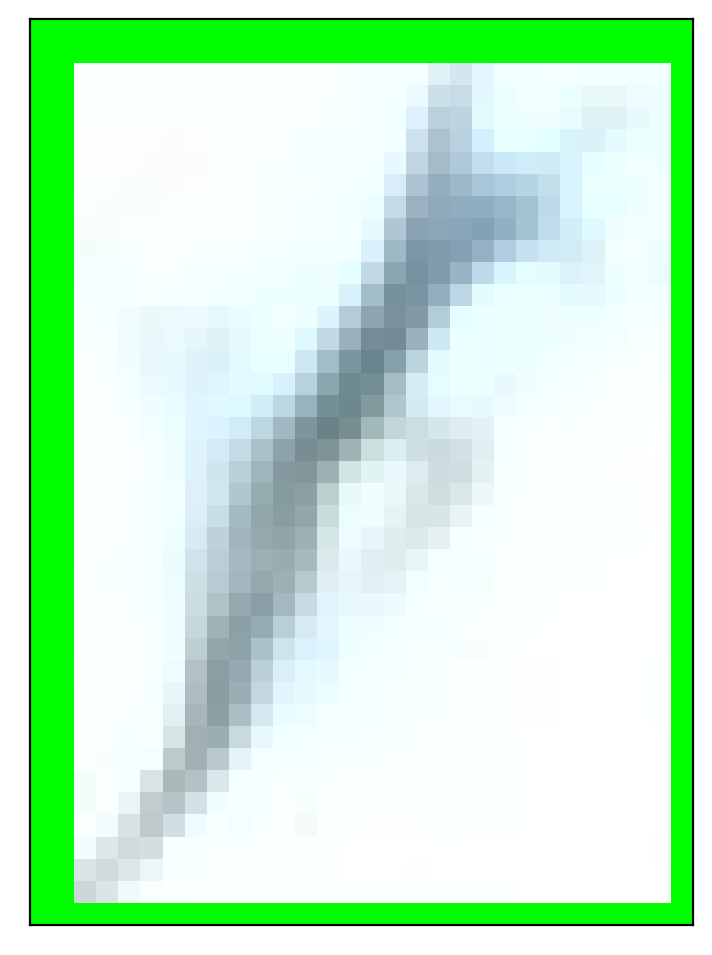

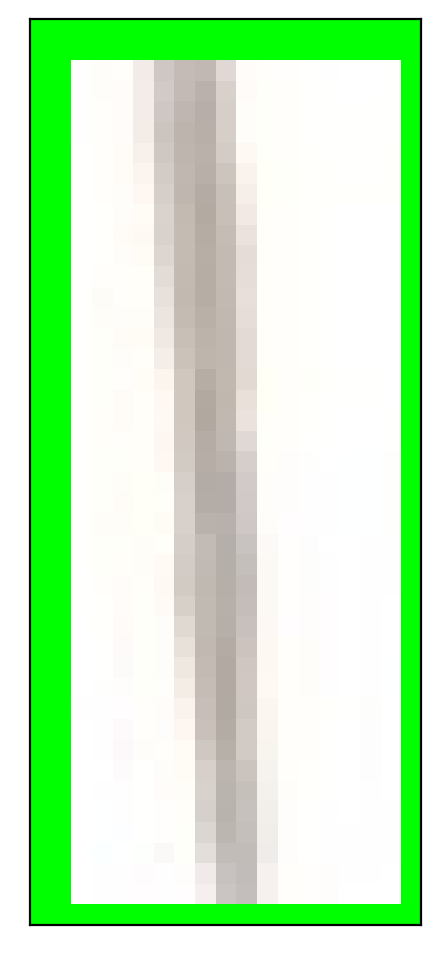

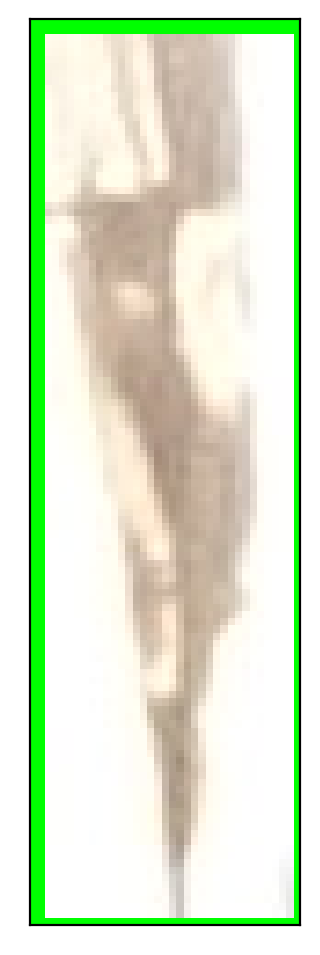

...

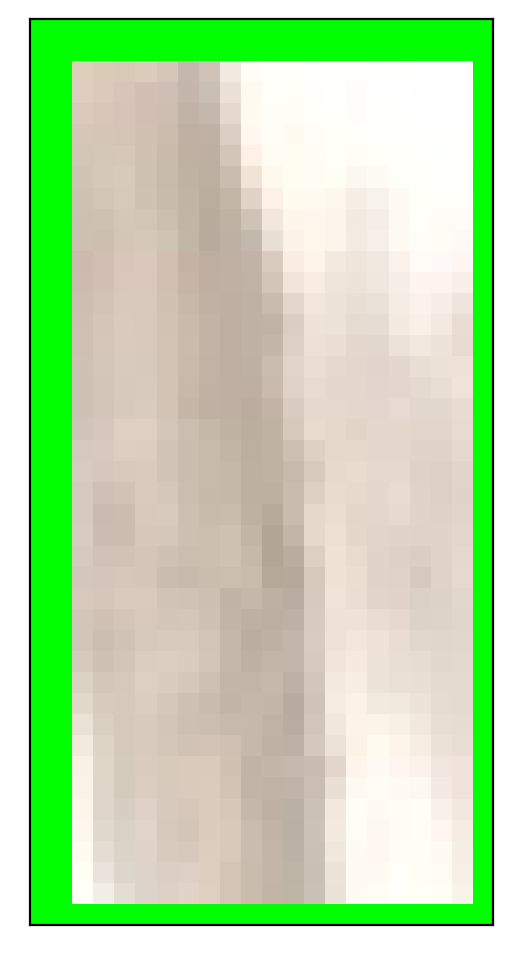

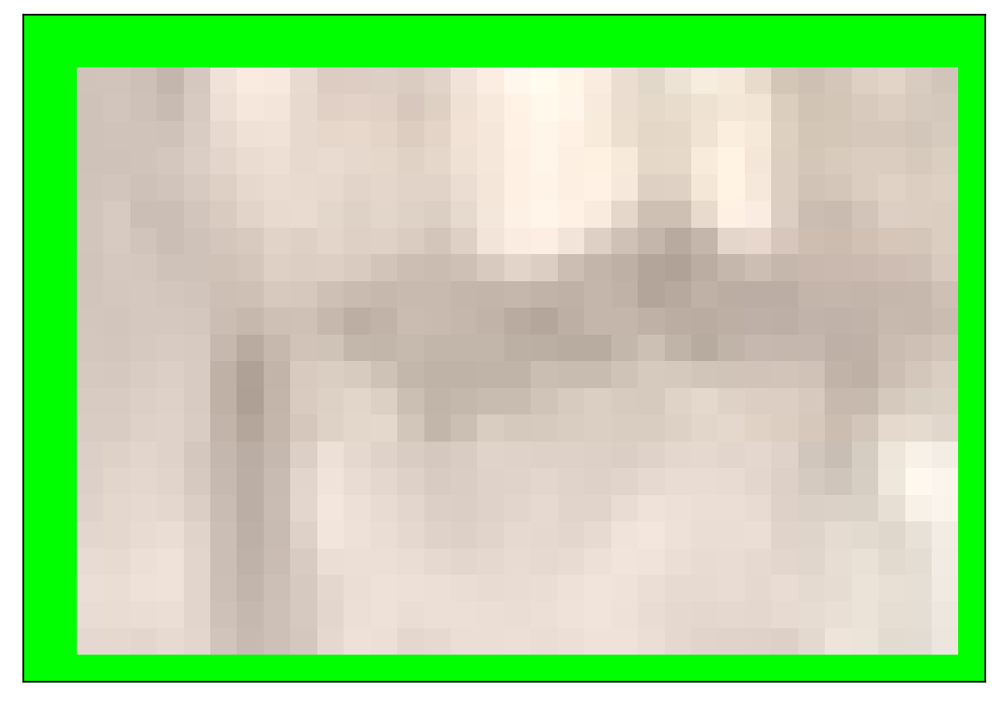

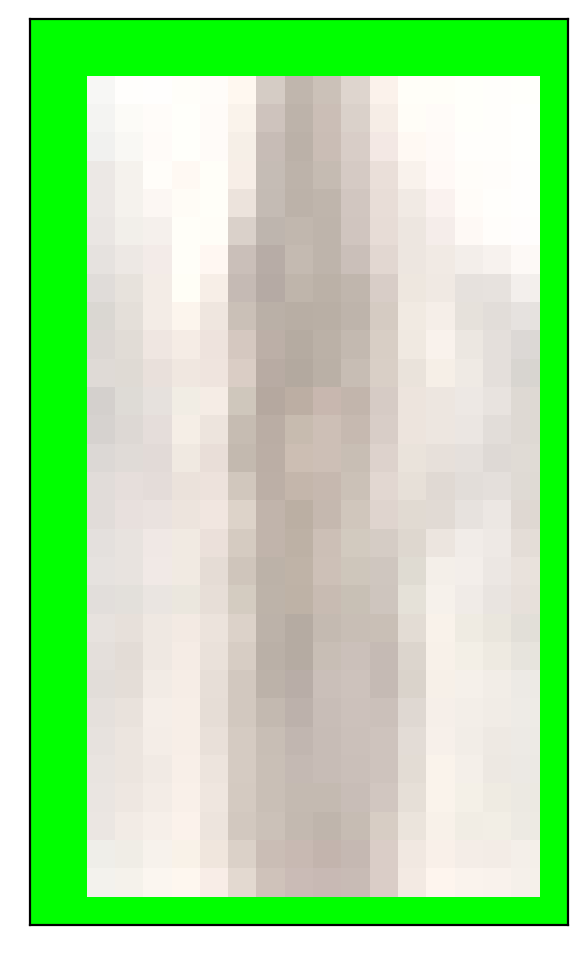

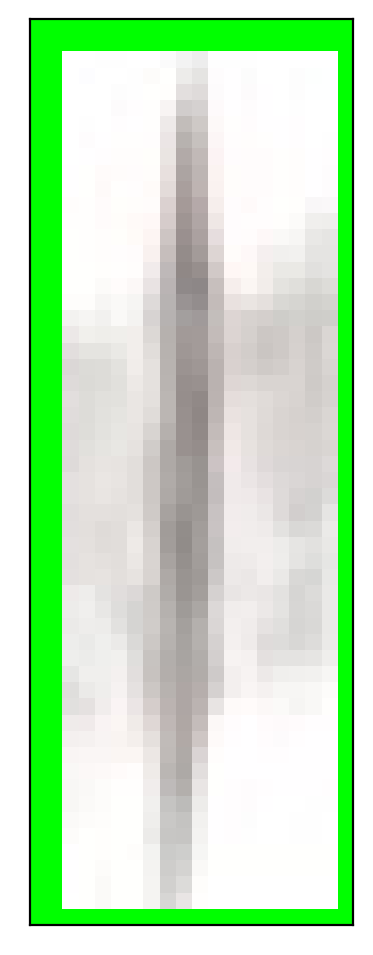

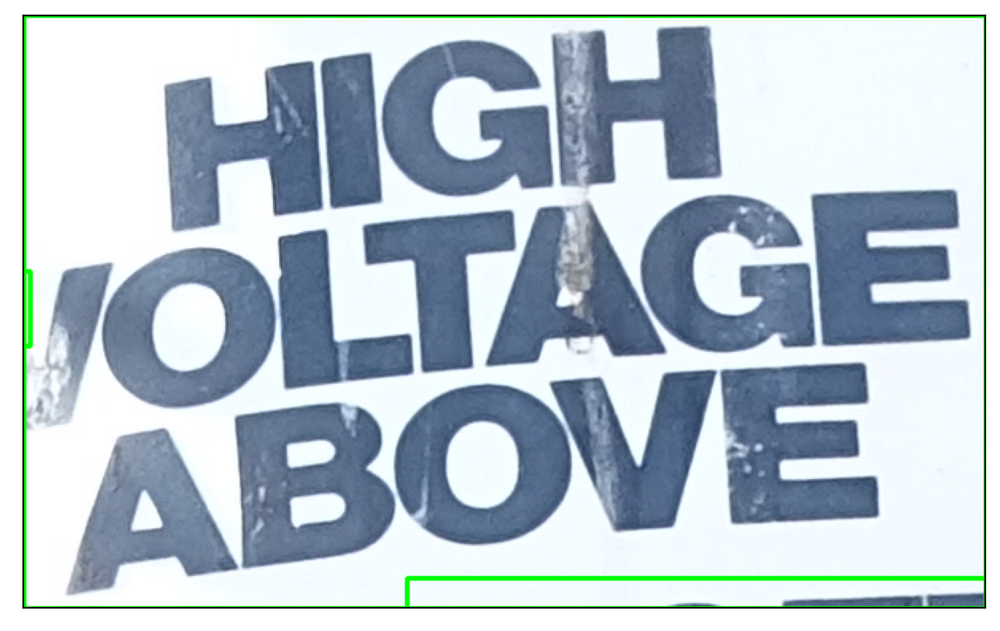

HIGH
jOLTAGE
ABOVE



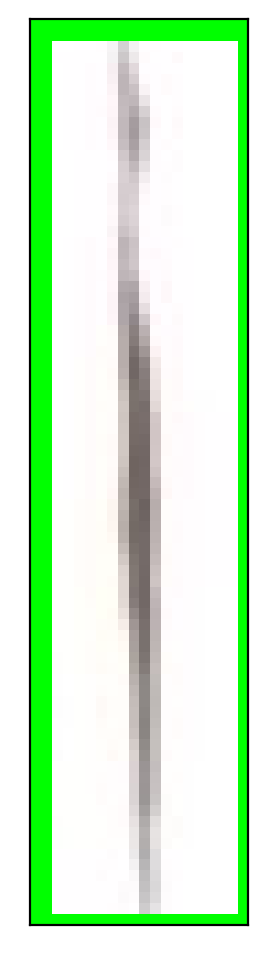

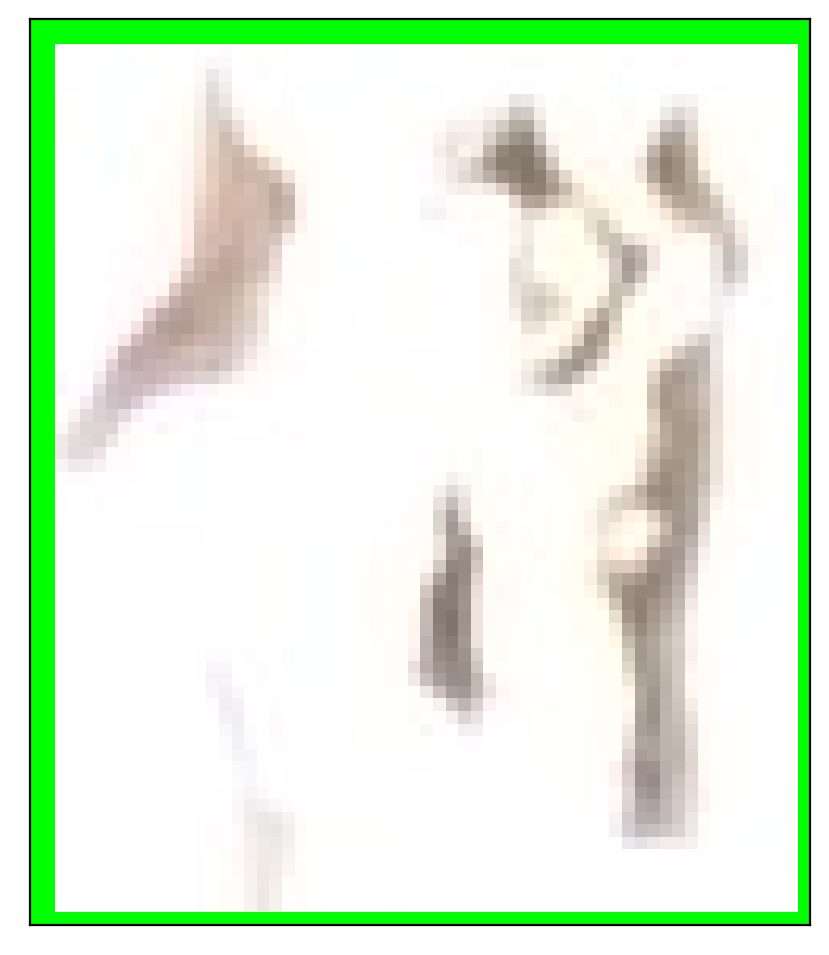

 

 

2 >

 

 



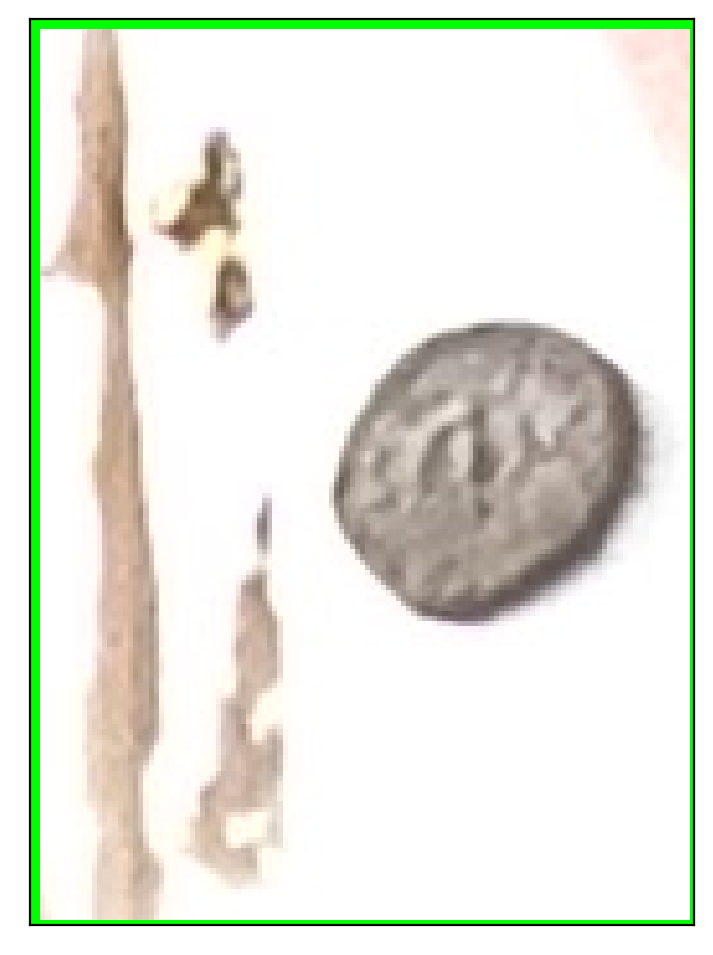

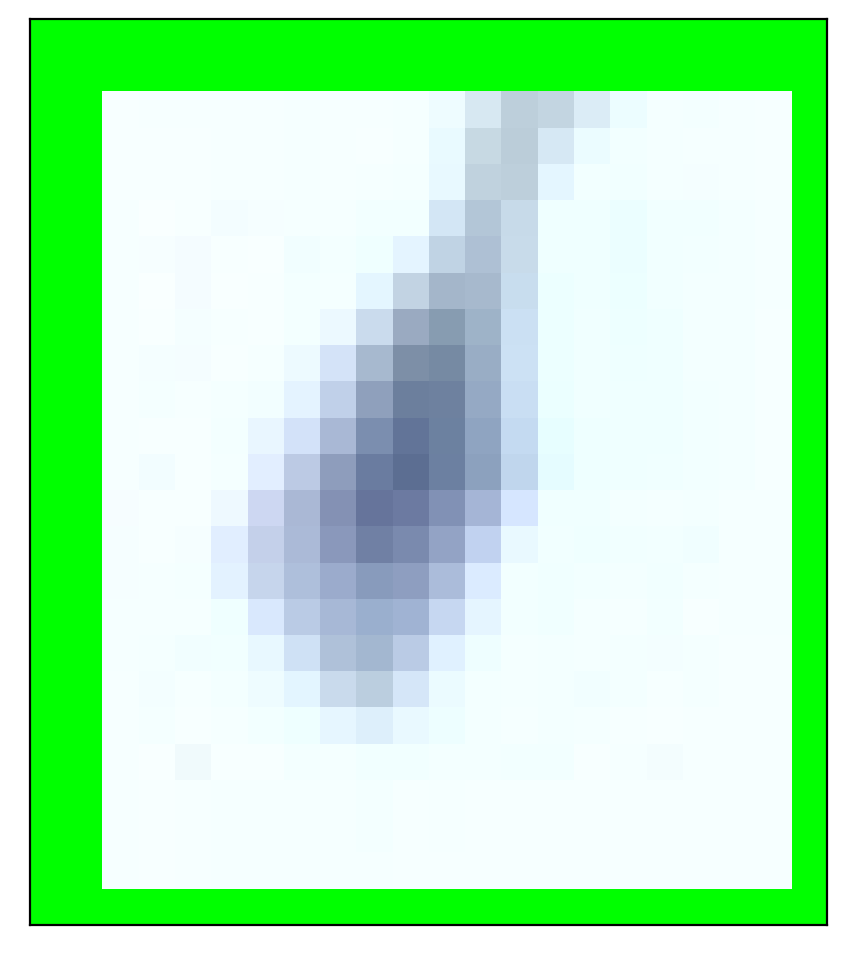

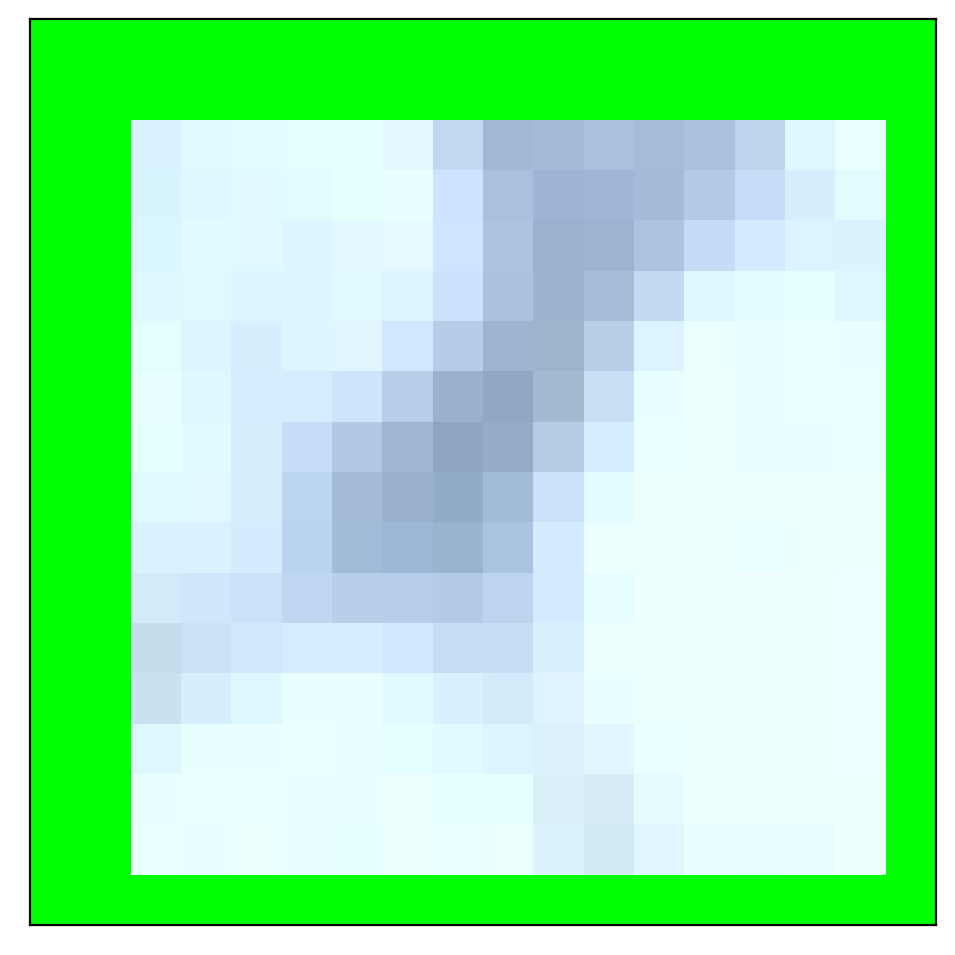

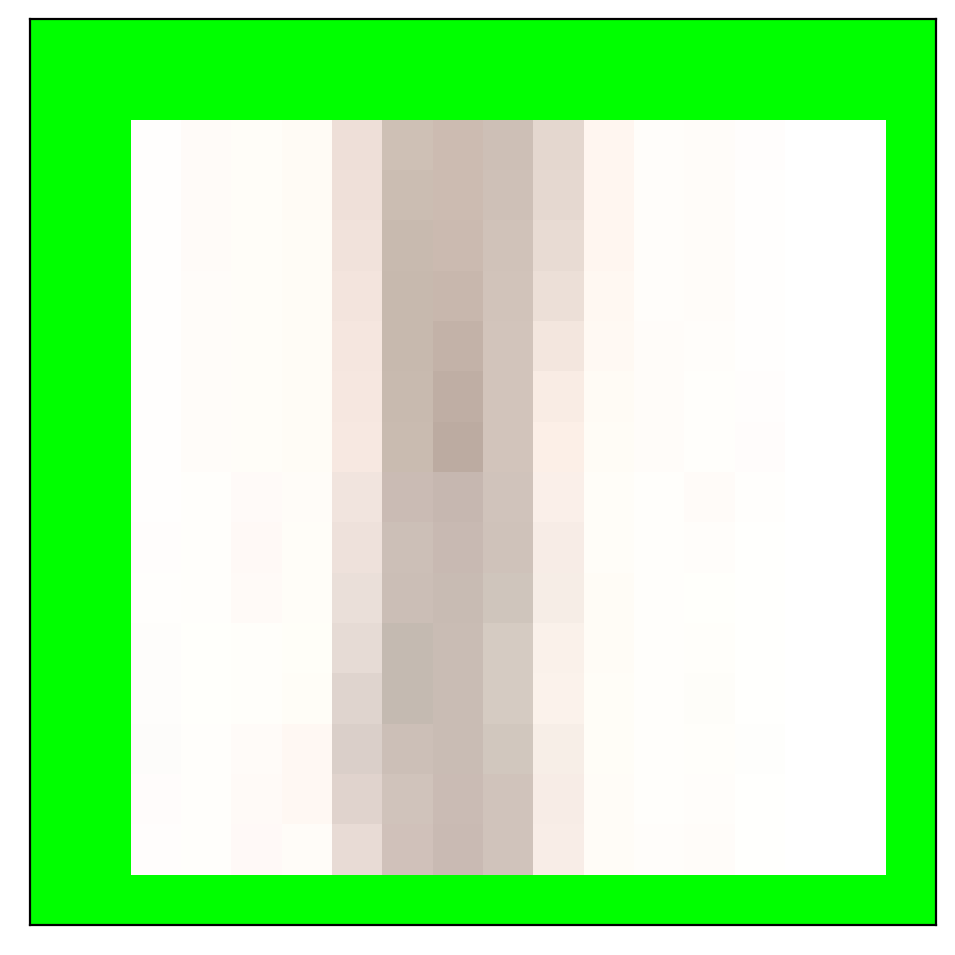

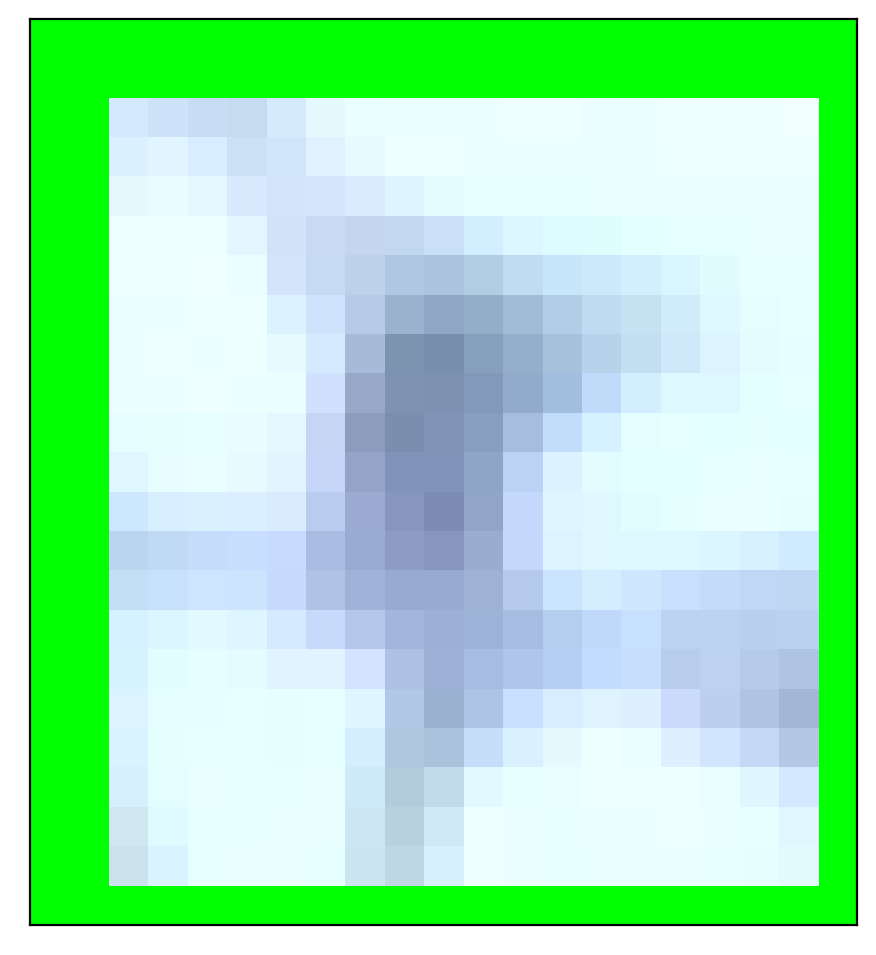

...

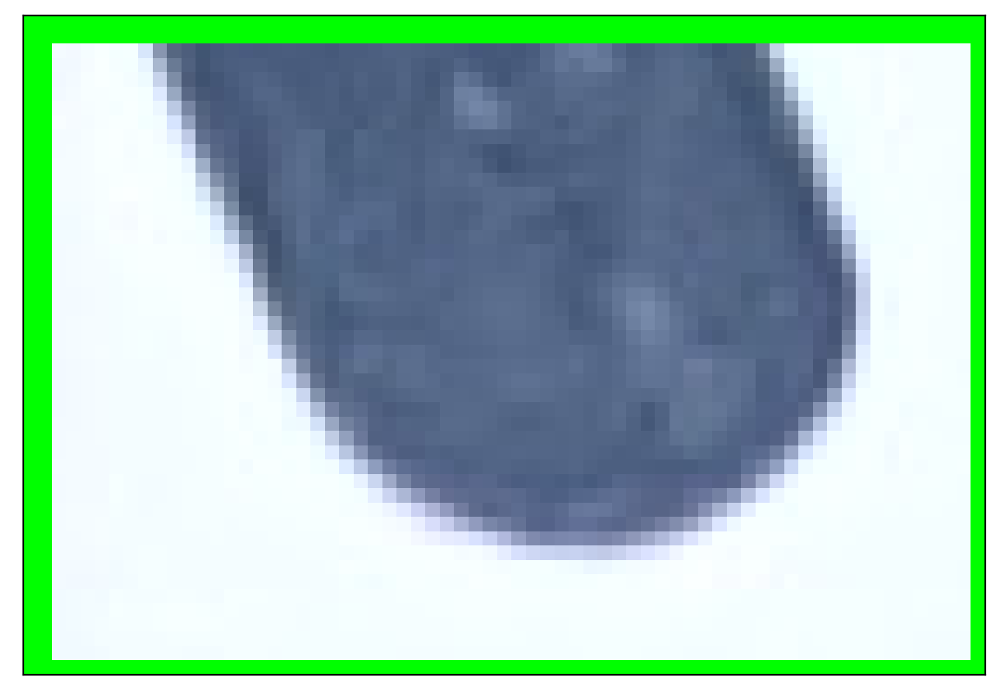

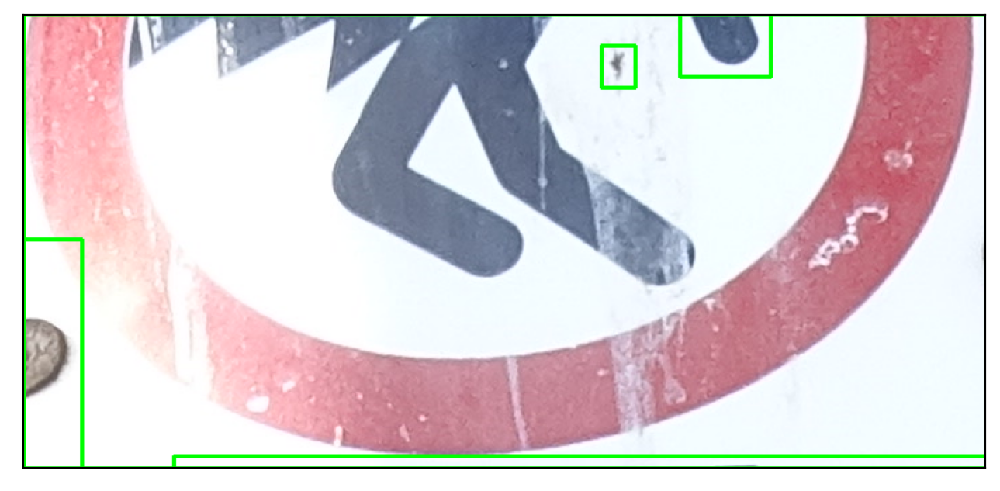

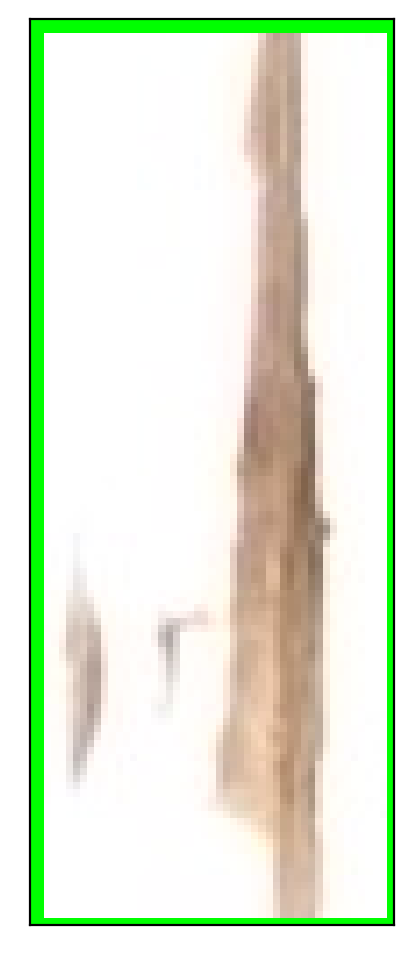

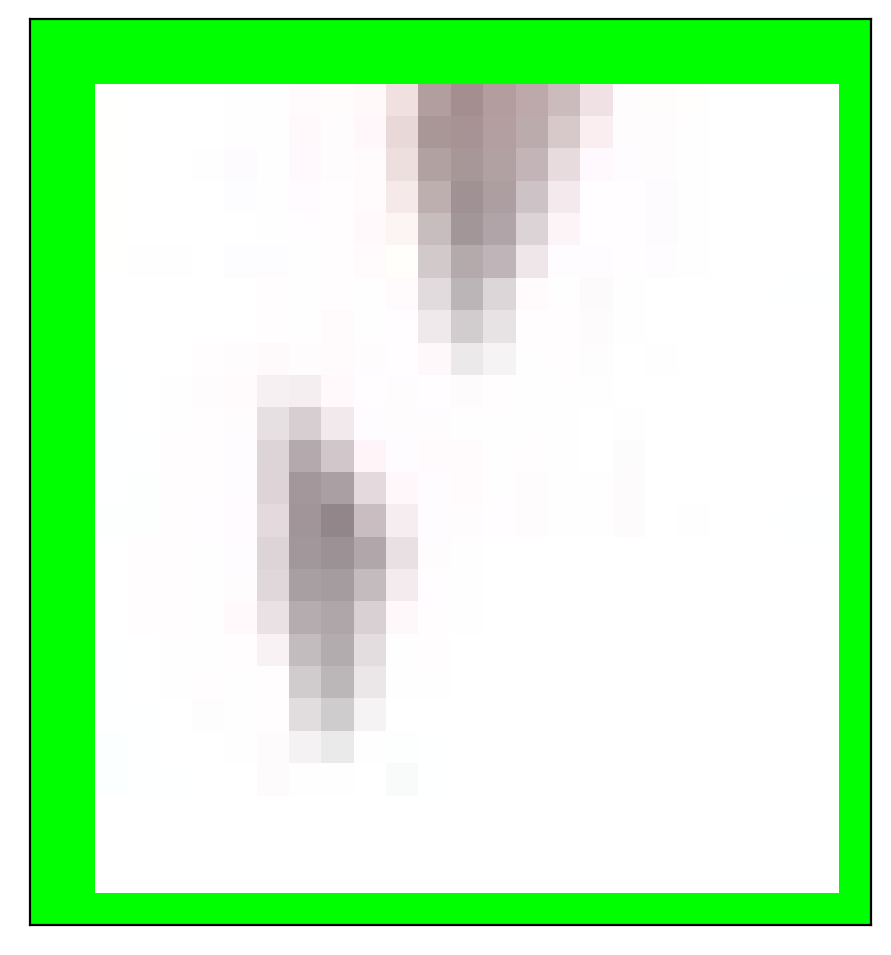

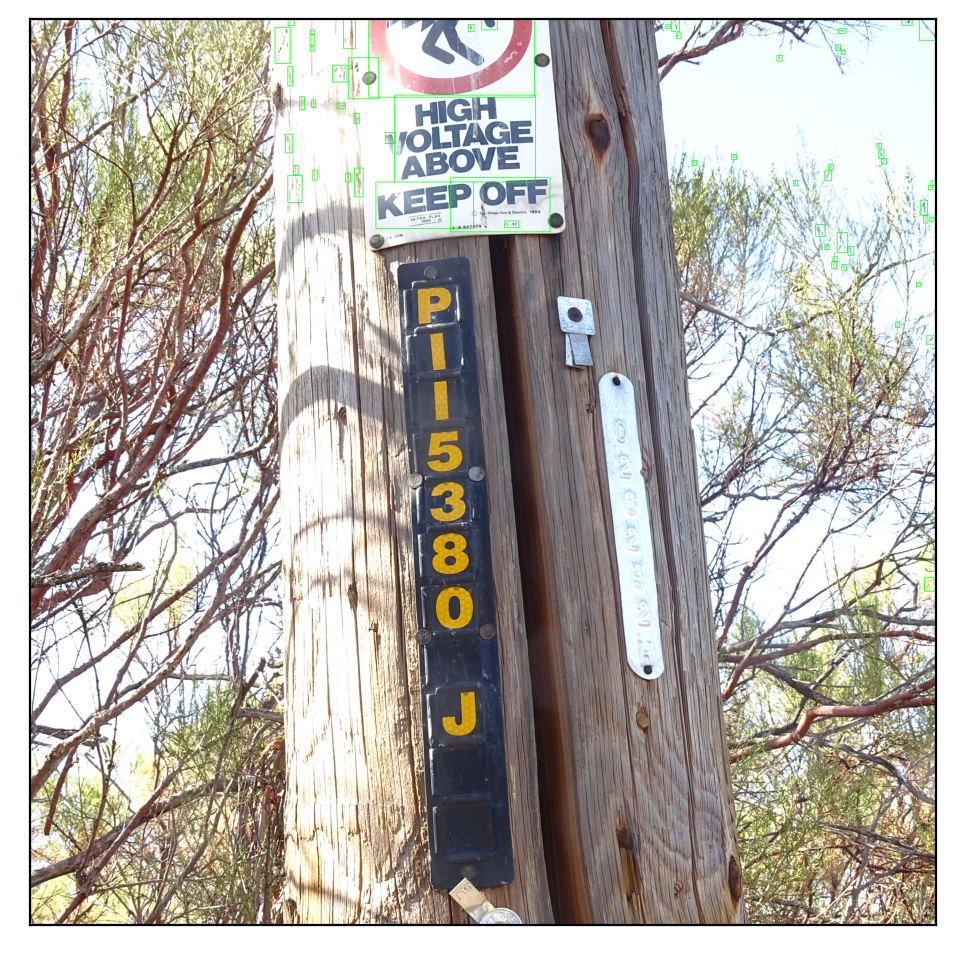

      

   

   

mK eg

Av ee Sy
bee

    

  

home —4

Ve SS Poe
joy? of f
NE le

Mes i]

 



In [339]:
# Preprocessing the image starts

# Convert the image to gray scale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Performing OTSU threshold
ret, thresh1 = cv2.threshold(gray, 0, 255, cv2.THRESH_OTSU | cv2.THRESH_BINARY_INV)

# Specify structure shape and kernel size.
# Kernel size increases or decreases the area
# of the rectangle to be detected.
# A smaller value like (10, 10) will detect
# each word instead of a sentence.
rect_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (18, 18))

# Appplying dilation on the threshold image
dilation = cv2.dilate(thresh1, rect_kernel, iterations = 1)

# Finding contours
contours, hierarchy = cv2.findContours(dilation, cv2.RETR_EXTERNAL,
                                                 cv2.CHAIN_APPROX_NONE)

im2 = img.copy()

for cnt in contours:
    x, y, w, h = cv2.boundingRect(cnt)

    # Drawing a rectangle on copied image
    rect = cv2.rectangle(im2, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Cropping the text block for giving input to OCR
    cropped = im2[y:y + h, x:x + w]
    show_image(cropped)
    # Apply OCR on the cropped image
    results = pytesseract.image_to_string(cropped)
    # results = ocr.readtext(cropped)
    print(results)

In [340]:
# EAST
args = {"east":"frozen_east_text_detection.pb", "min_confidence":0.5, "width":320, "height":320}

img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

orig = img_hsv.copy()
(origH, origW) = img.shape[:2]

# set the new height and width to default 320 by using args #dictionary.
(newW, newH) = (args["width"], args["height"])

#Calculate the ratio between original and new image for both height and weight.
#This ratio will be used to translate bounding box location on the original image.
rW = origW / float(newW)
rH = origH / float(newH)

# resize the original image to new dimensions
image = cv2.resize(img_hsv, (newW, newH))
(H, W) = image.shape[:2]

# construct a blob from the image to forward pass it to EAST model
blob = cv2.dnn.blobFromImage(image, 1.0, (W, H),
	(123.68, 116.78, 103.94), swapRB=True, crop=False)

# load the pre-trained EAST model for text detection
net = cv2.dnn.readNet(args["east"])

# The following two layer need to pulled from EAST model for achieving this.
layerNames = [
	"feature_fusion/Conv_7/Sigmoid",
	"feature_fusion/concat_3"]

#Forward pass the blob from the image to get the desired output layers
net.setInput(blob)
(scores, geometry) = net.forward(layerNames)

# Returns a bounding box and probability score if it is more than minimum confidence
def predictions(prob_score, geo):
	(numR, numC) = prob_score.shape[2:4]
	boxes = []
	confidence_val = []

	# loop over rows
	for y in range(0, numR):
		scoresData = prob_score[0, 0, y]
		x0 = geo[0, 0, y]
		x1 = geo[0, 1, y]
		x2 = geo[0, 2, y]
		x3 = geo[0, 3, y]
		anglesData = geo[0, 4, y]

		# loop over the number of columns
		for i in range(0, numC):
			if scoresData[i] < args["min_confidence"]:
				continue

			(offX, offY) = (i * 4.0, y * 4.0)

			# extracting the rotation angle for the prediction and computing the sine and cosine
			angle = anglesData[i]
			cos = np.cos(angle)
			sin = np.sin(angle)

			# using the geo volume to get the dimensions of the bounding box
			h = x0[i] + x2[i]
			w = x1[i] + x3[i]

			# compute start and end for the text pred bbox
			endX = int(offX + (cos * x1[i]) + (sin * x2[i]))
			endY = int(offY - (sin * x1[i]) + (cos * x2[i]))
			startX = int(endX - w)
			startY = int(endY - h)

			boxes.append((startX, startY, endX, endY))
			confidence_val.append(scoresData[i])

	# return bounding boxes and associated confidence_val
	return (boxes, confidence_val)

# Find predictions and  apply non-maxima suppression
(boxes, confidence_val) = predictions(scores, geometry)
boxes = non_max_suppression(np.array(boxes), probs=confidence_val)

##Text Detection and Recognition

# initialize the list of results
results = []

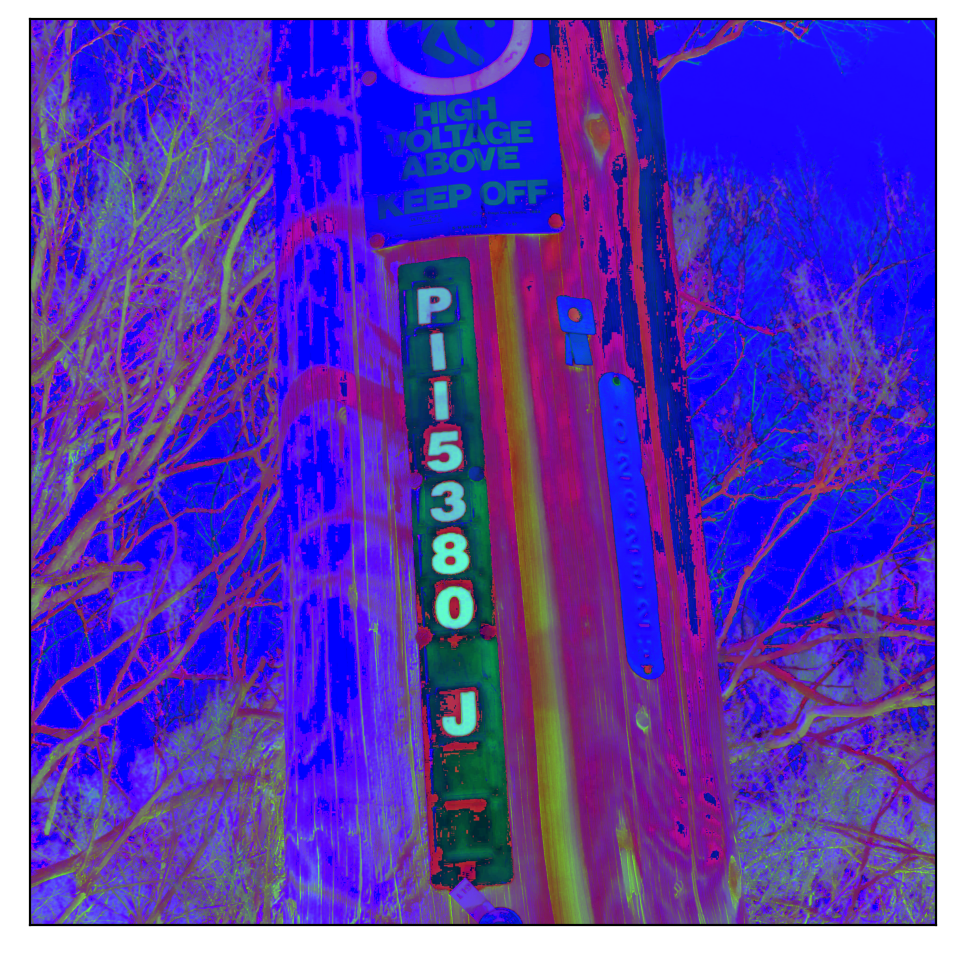

In [341]:
# loop over the bounding boxes to find the coordinate of bounding boxes
for (startX, startY, endX, endY) in boxes:
	# scale the coordinates based on the respective ratios in order to reflect bounding box on the original image
	startX = int(startX * rW)
	startY = int(startY * rH)
	endX = int(endX * rW)
	endY = int(endY * rH)

	#extract the region of interest
	r = orig[startY:endY, startX:endX]

	#configuration setting to convert image to string.
	configuration = ("-l eng --oem 1 --psm 8")
	shape = r.shape

	if r is None or 0 in shape:
		print(f"Skipping image with shape {shape}")
		continue
	show_image(r)

    ##This will recognize the text from the image of bounding box
	text = pytesseract.image_to_string(r, config=configuration)

	# append bbox coordinate and associated text to the list of results
	results.append(((startX, startY, endX, endY), text))

#Display the image with bounding box and recognized text
orig_image = orig.copy()

# Moving over the results and display on the image
for ((start_X, start_Y, end_X, end_Y), text) in results:
	# display the text detected by Tesseract
	print("{}\n".format(text))

	# Displaying text
	text = "".join([x if ord(x) < 128 else "" for x in text]).strip()
	cv2.rectangle(orig_image, (start_X, start_Y), (end_X, end_Y),
		(0, 0, 255), 2)
	cv2.putText(orig_image, text, (start_X, start_Y - 30),
		cv2.FONT_HERSHEY_SIMPLEX, 0.7,(0,0, 255), 2)

show_image(orig_image)

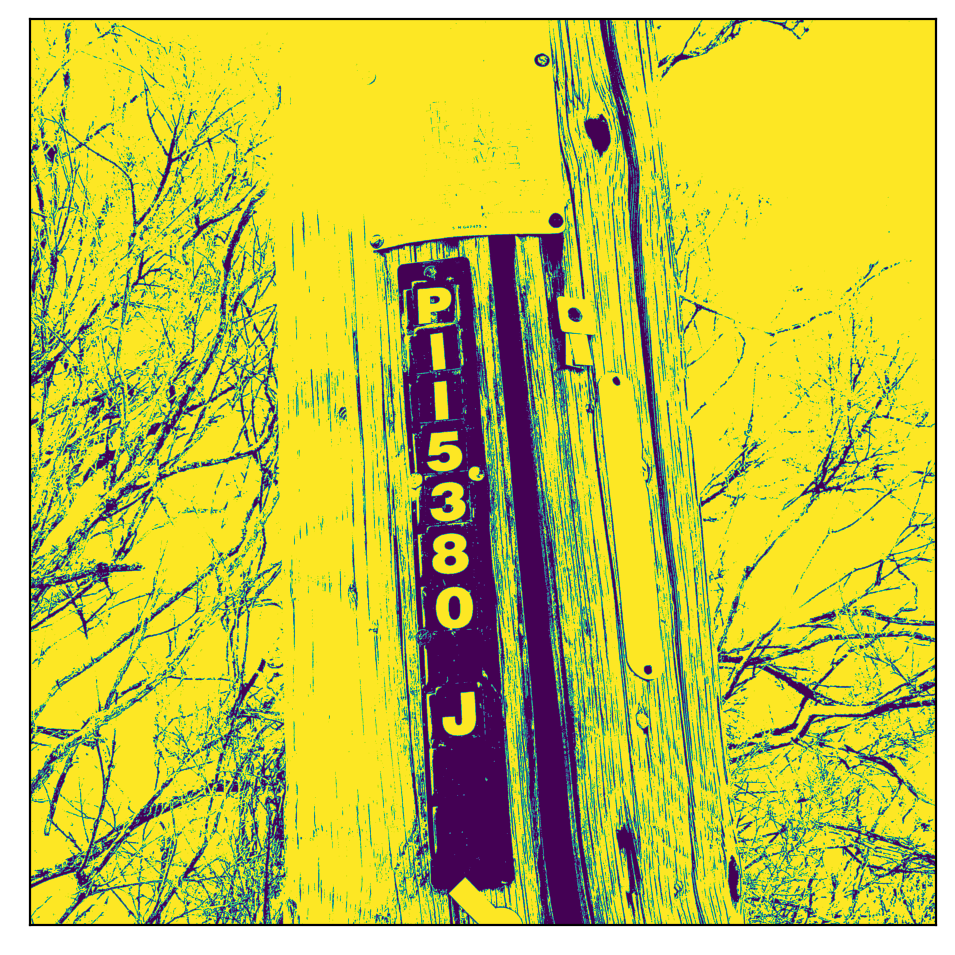

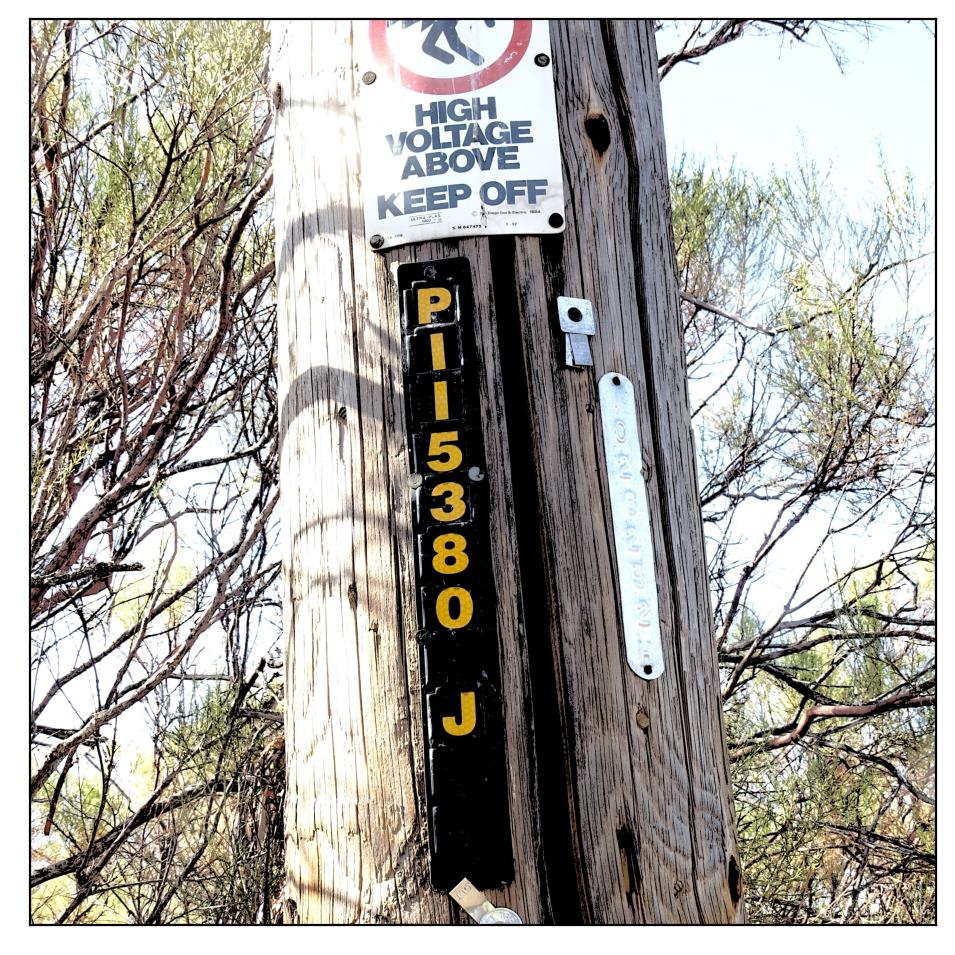

In [342]:
img_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
avg_h = int(np.mean(img_hsv[0]))
avg_s = int(np.mean(img_hsv[1]))
avg_v = int(np.mean(img_hsv[2]))

hsv_color1 = np.asarray([0, 0, avg_v])   # white!
hsv_color2 = np.asarray([255, 255, 255])   # yellow! note the order

mask = cv2.inRange(img_hsv, hsv_color1, hsv_color2)
colored_portion = cv2.cv2.bitwise_and(img, img, mask=mask)
# results = ocr.readtext(mask)
# print(results)
# results = pytesseract.image_to_string(mask)
# print(results)
show_image(mask)
show_image(colored_portion)

# mod_image = cv2.cvtColor(mask, cv2.COLOR_HSV2BGR)
# show_image(mod_image)

Standard Hough


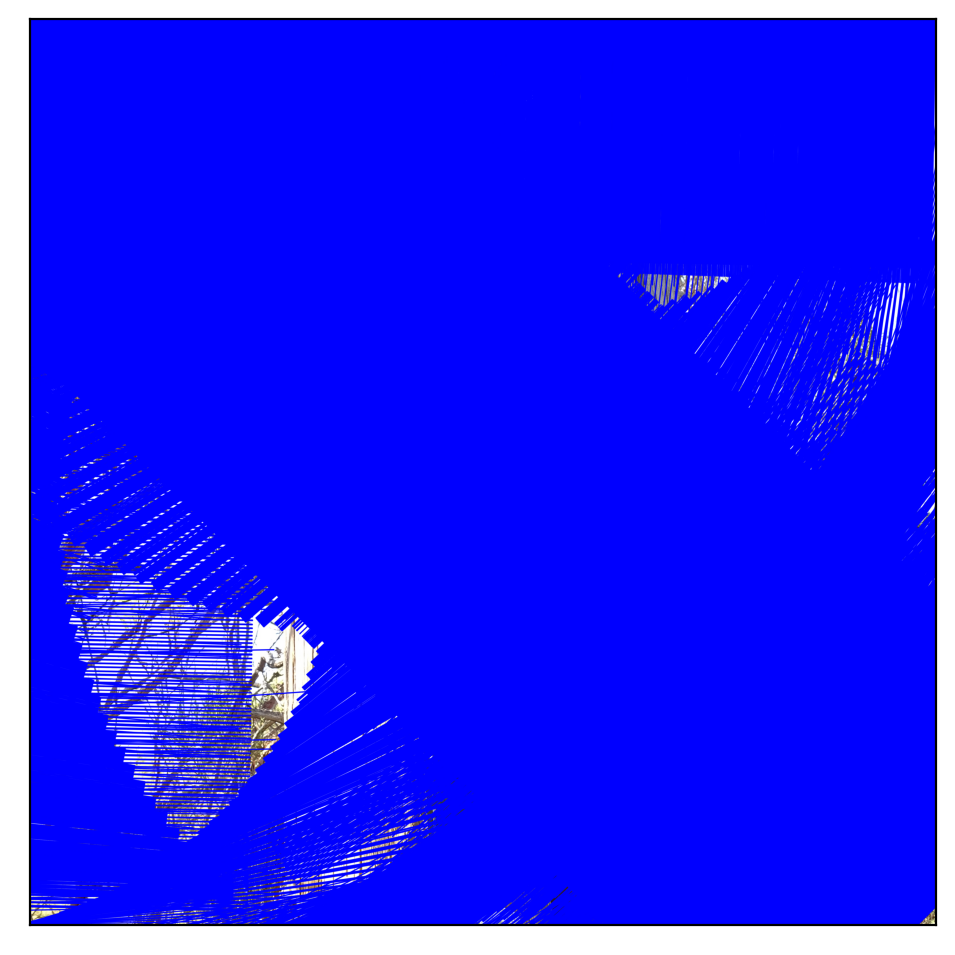

PLT


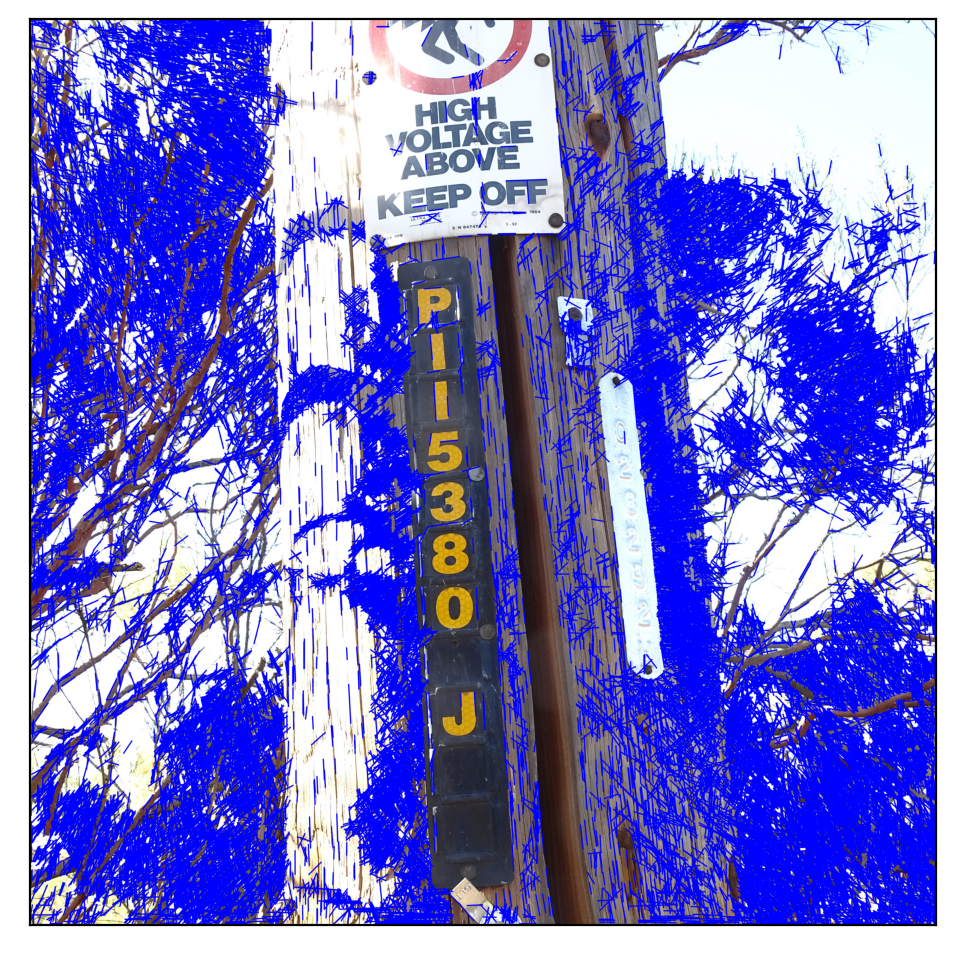

In [343]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
orig_image = img.copy()
orig_imagep = img.copy()

dst = cv2.Canny(gray, 50, 200, None, 3)

lines = cv2.HoughLines(gray, 1, np.pi / 180, 150, None, 0, 0)
if lines is not None:
	for i in range(0, len(lines)):
		rho = lines[i][0][0]
		theta = lines[i][0][1]
		a = math.cos(theta)
		b = math.sin(theta)
		x0 = a * rho
		y0 = b * rho
		pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
		pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
		cv2.line(orig_image, pt1, pt2, (0,0,255), 3, cv2.LINE_AA)

linesP = cv2.HoughLinesP(dst, 1, np.pi / 180, 50, None, 50, 10)

if linesP is not None:
	for i in range(0, len(linesP)):
		l = linesP[i][0]
		cv2.line(orig_imagep, (l[0], l[1]), (l[2], l[3]), (0,0,255), 3, cv2.LINE_AA)

print("Standard Hough")
show_image(orig_image)
print("PLT")
show_image(orig_imagep)

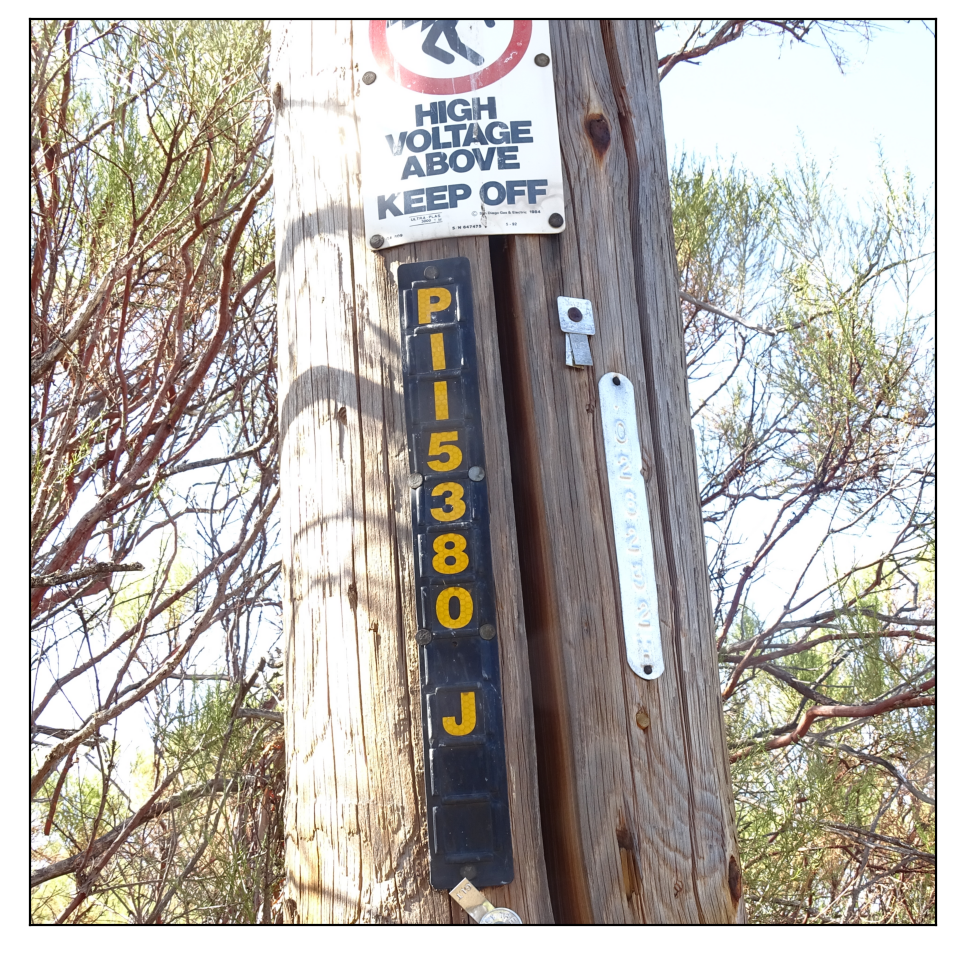

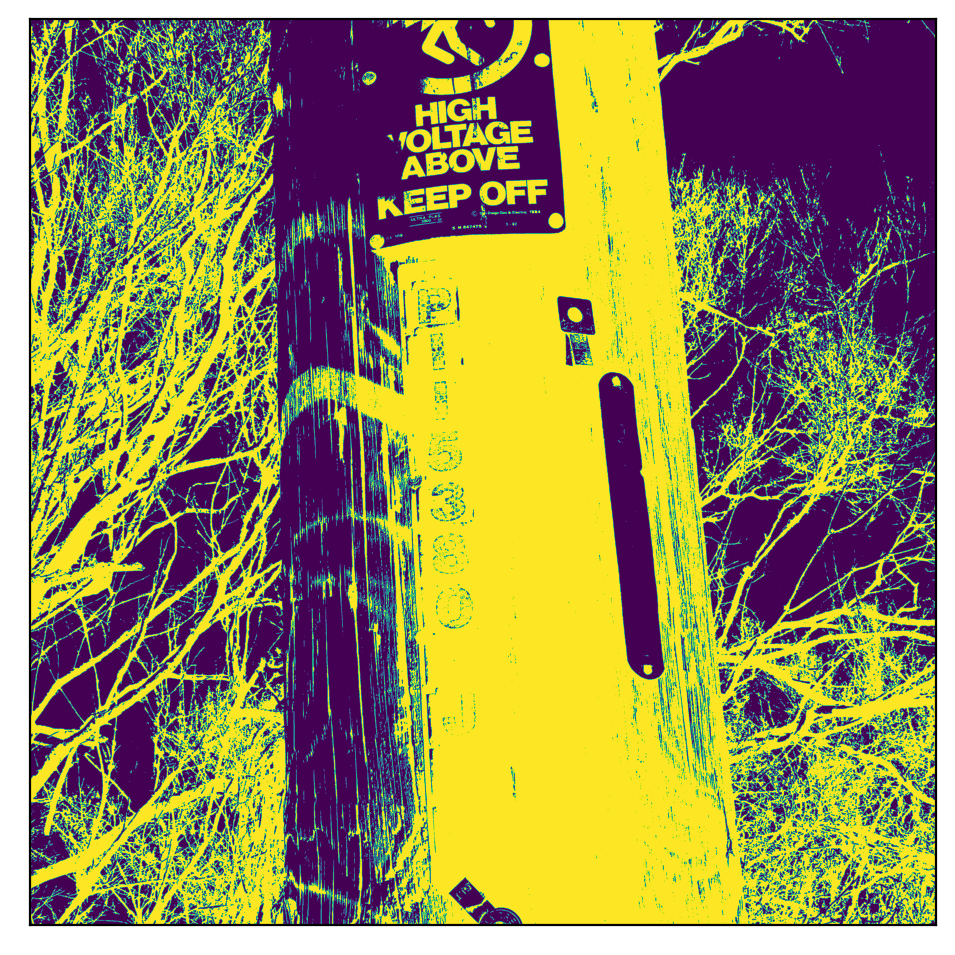

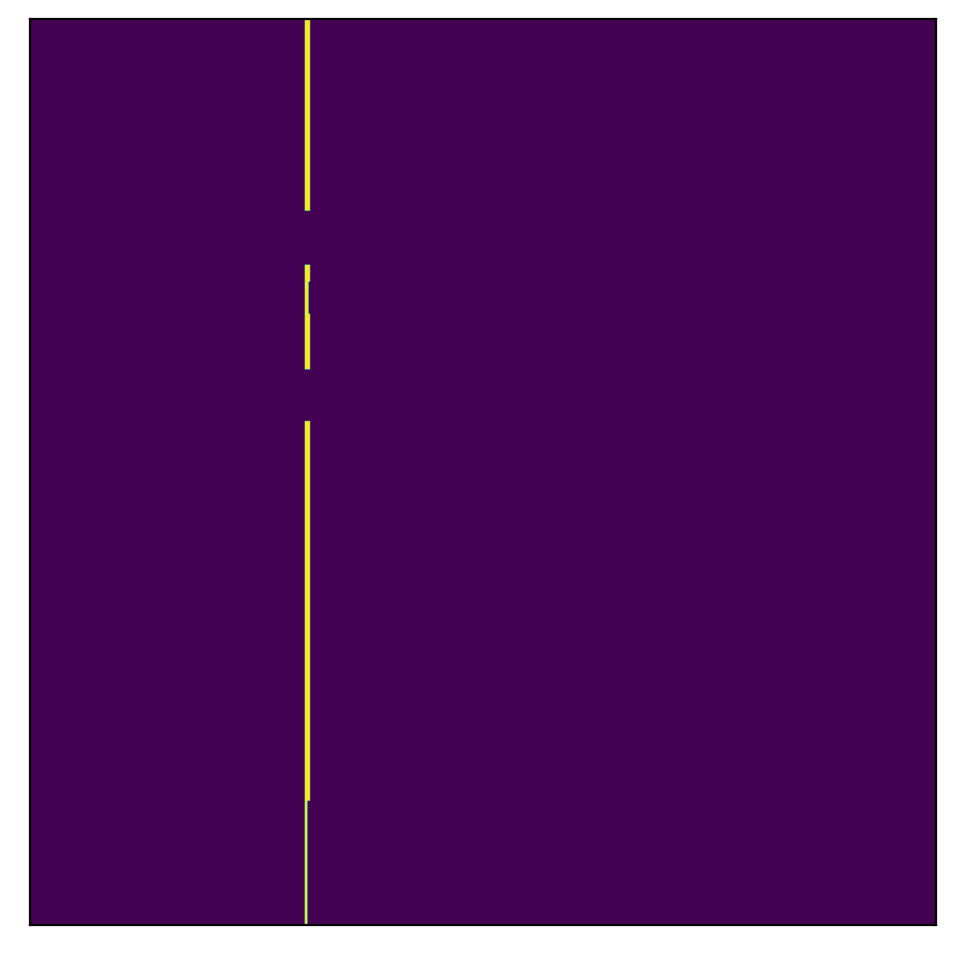

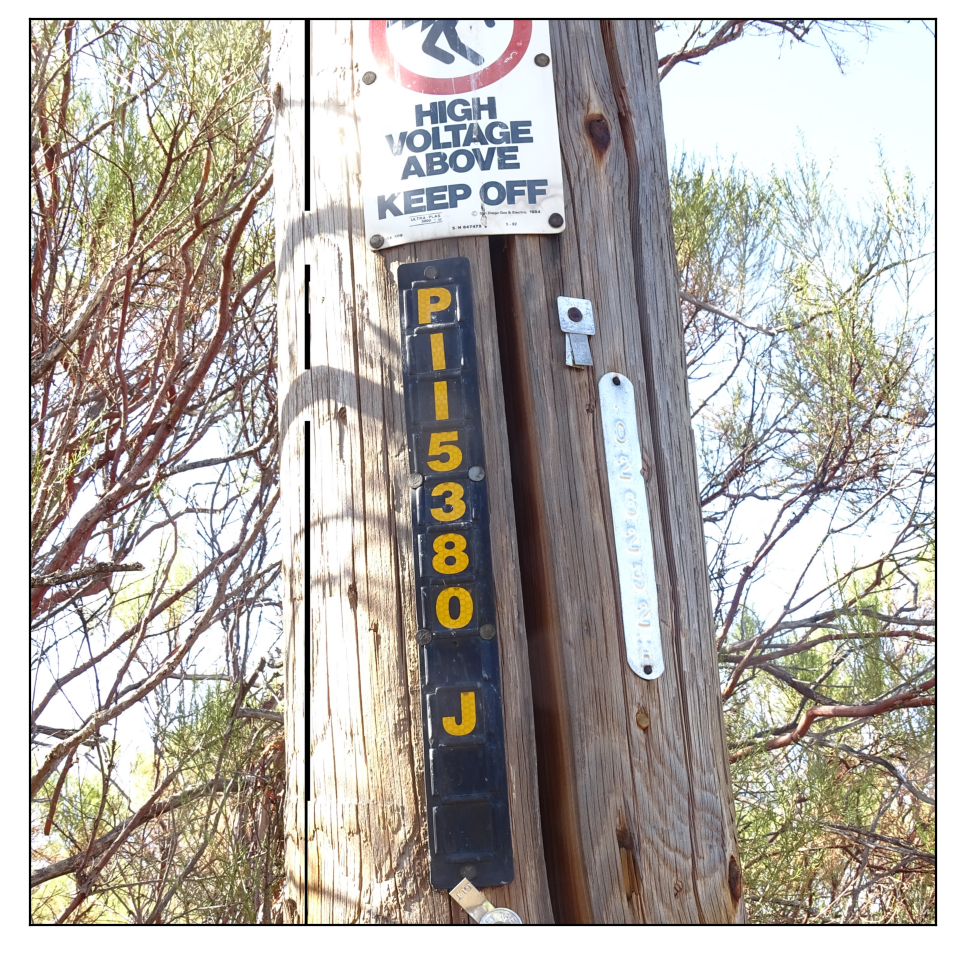

In [355]:
img = cv2.cvtColor(best_image, cv2.COLOR_BGR2RGB)
show_image(img)
gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

thresh_inv = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)[1]

# Blur the image
blur = cv2.GaussianBlur(thresh_inv,(1,1),0)
show_image(blur)

thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1]

# find contours
contours = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0]

mask = np.ones(img.shape[:2], dtype="uint8") * 255
for c in contours:
    # get the bounding rect
    x, y, w, h = cv2.boundingRect(c)
    if w*h>1000:
        cv2.rectangle(mask, (x, y), (x+w, y+h), (0, 0, 255), -1)

res_final = cv2.bitwise_and(img, img, mask=cv2.bitwise_not(mask))

show_image(mask)
show_image(res_final)

averages: 37, 38, 163


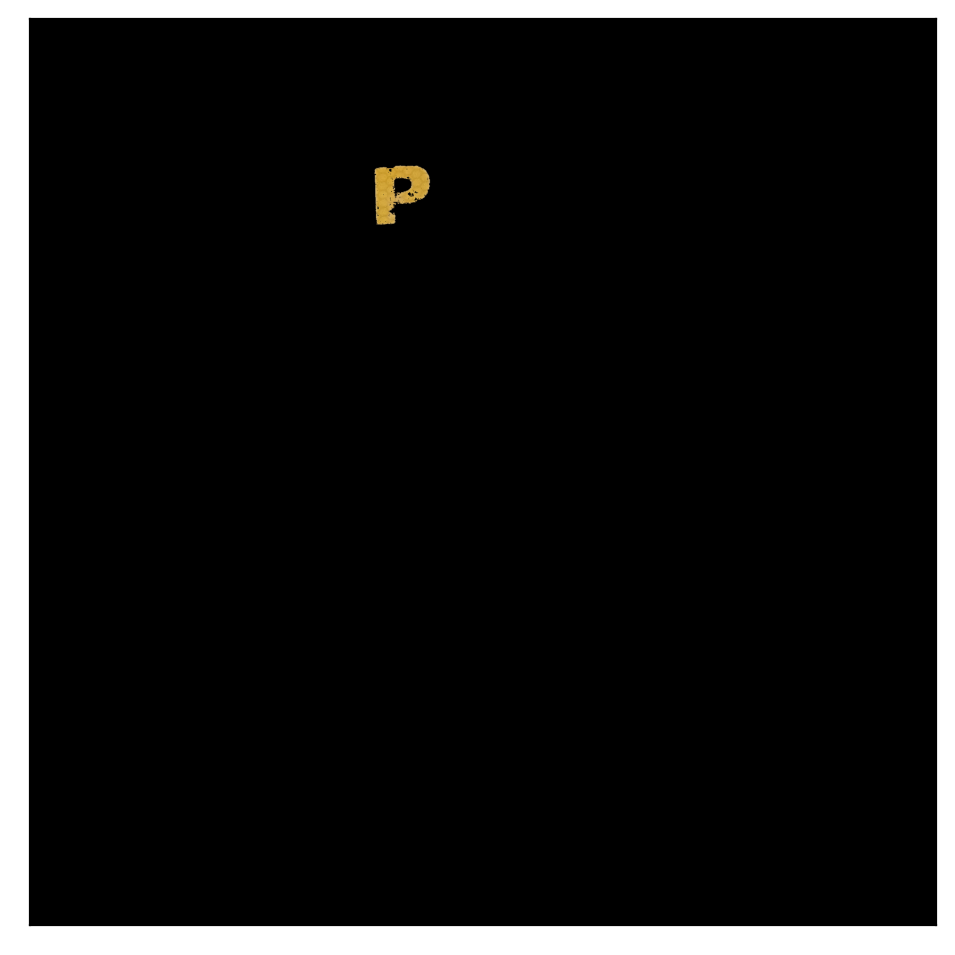

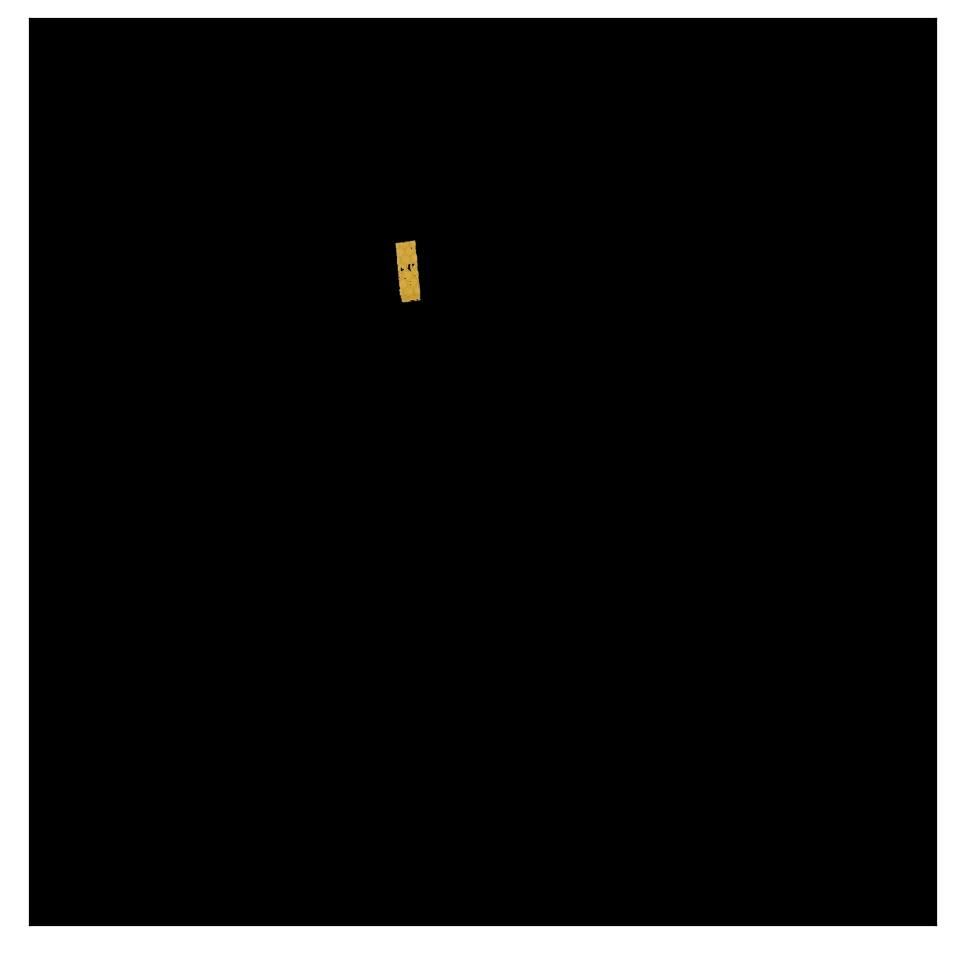

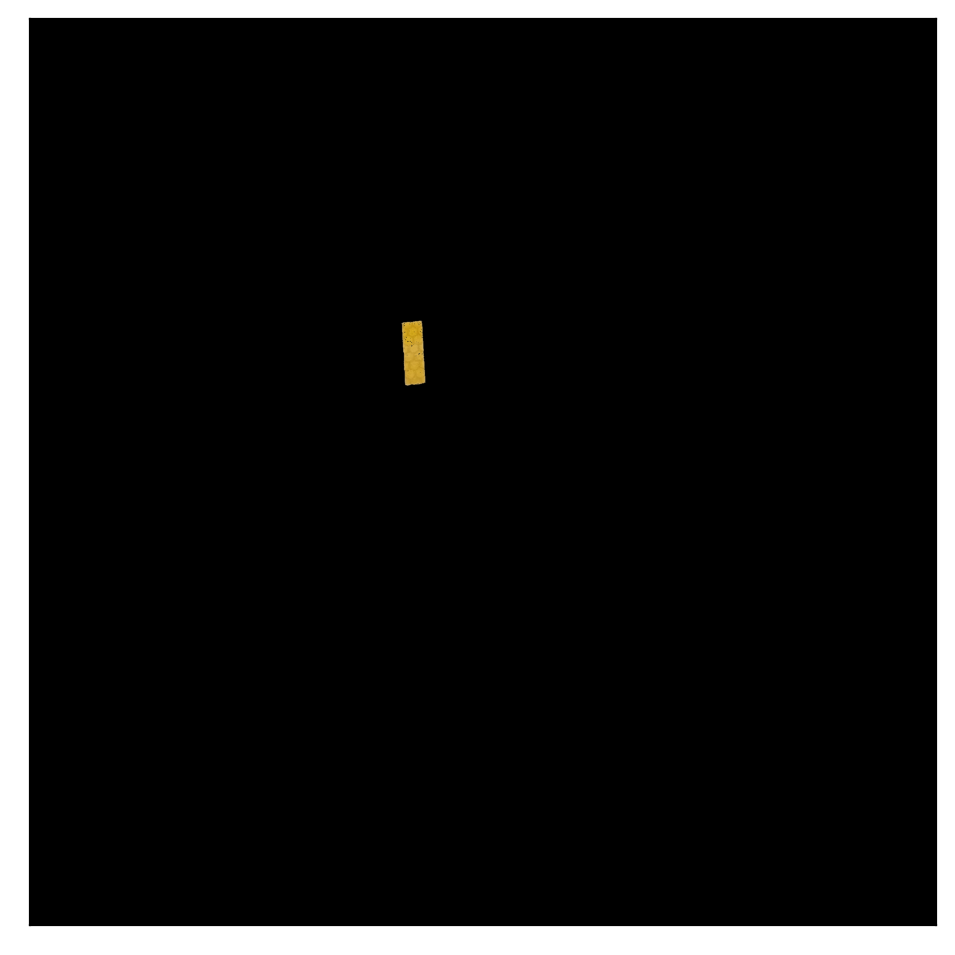

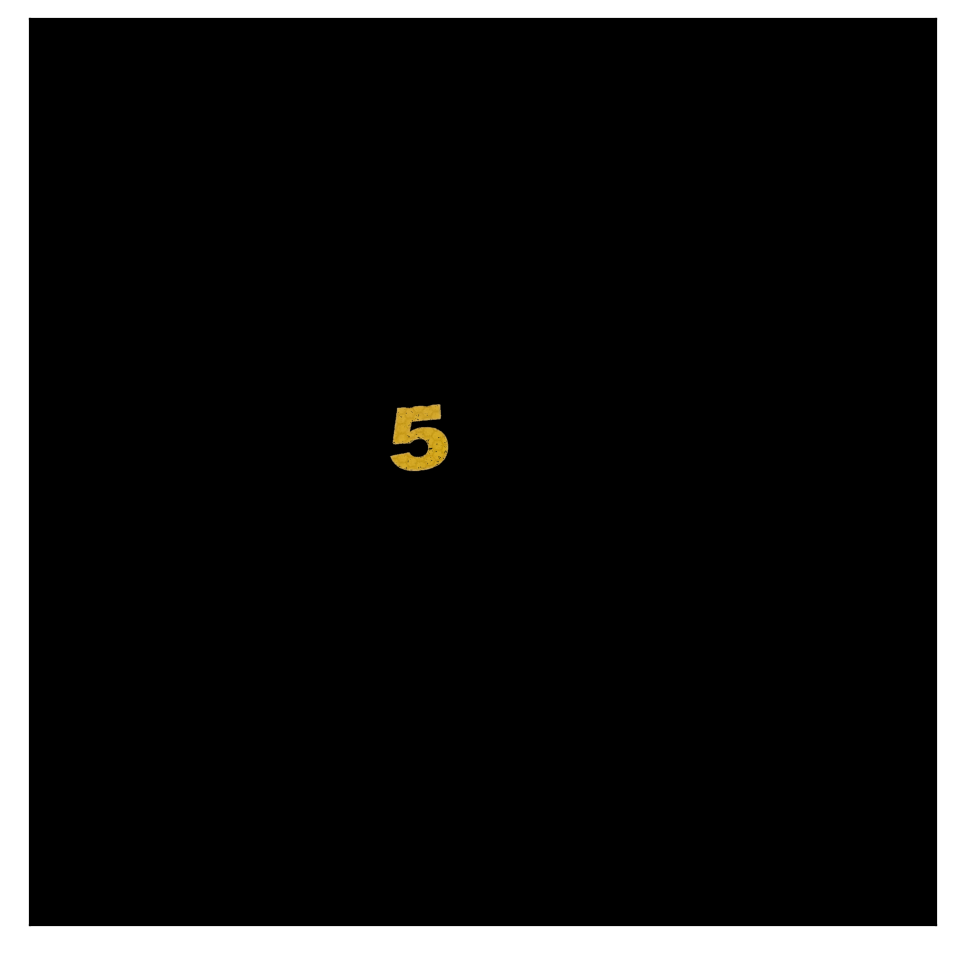

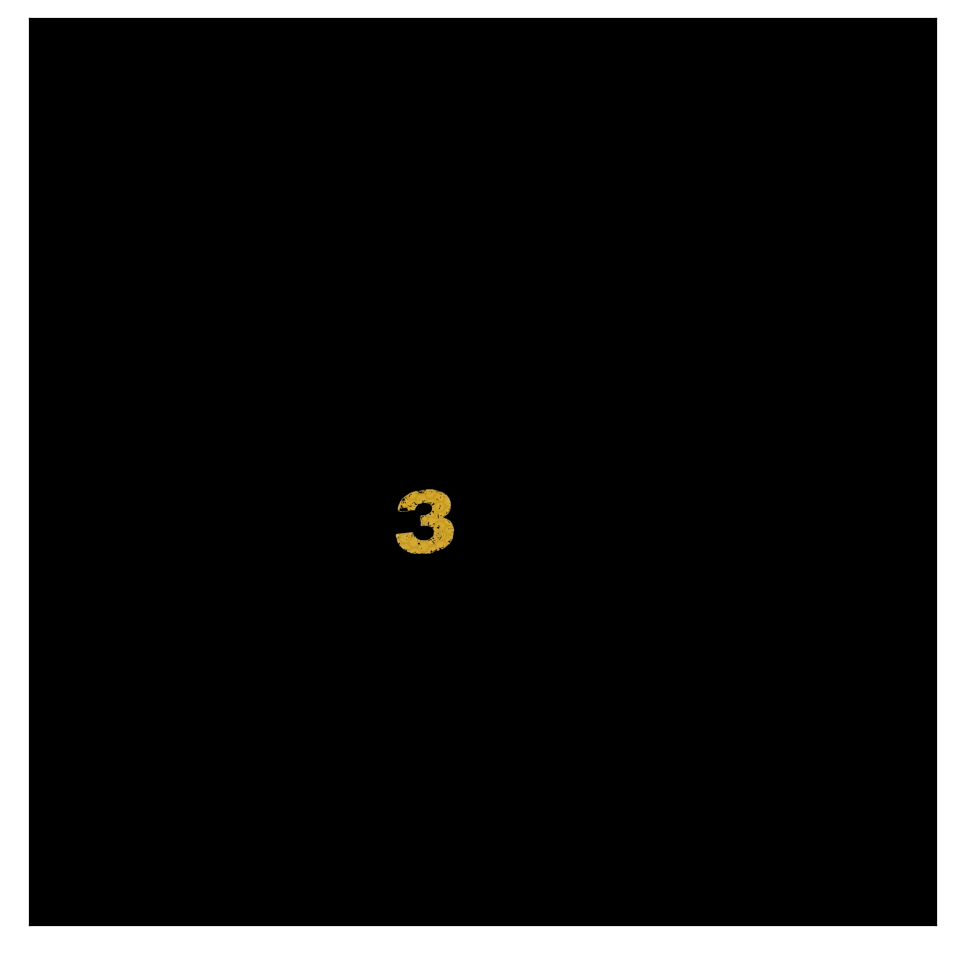

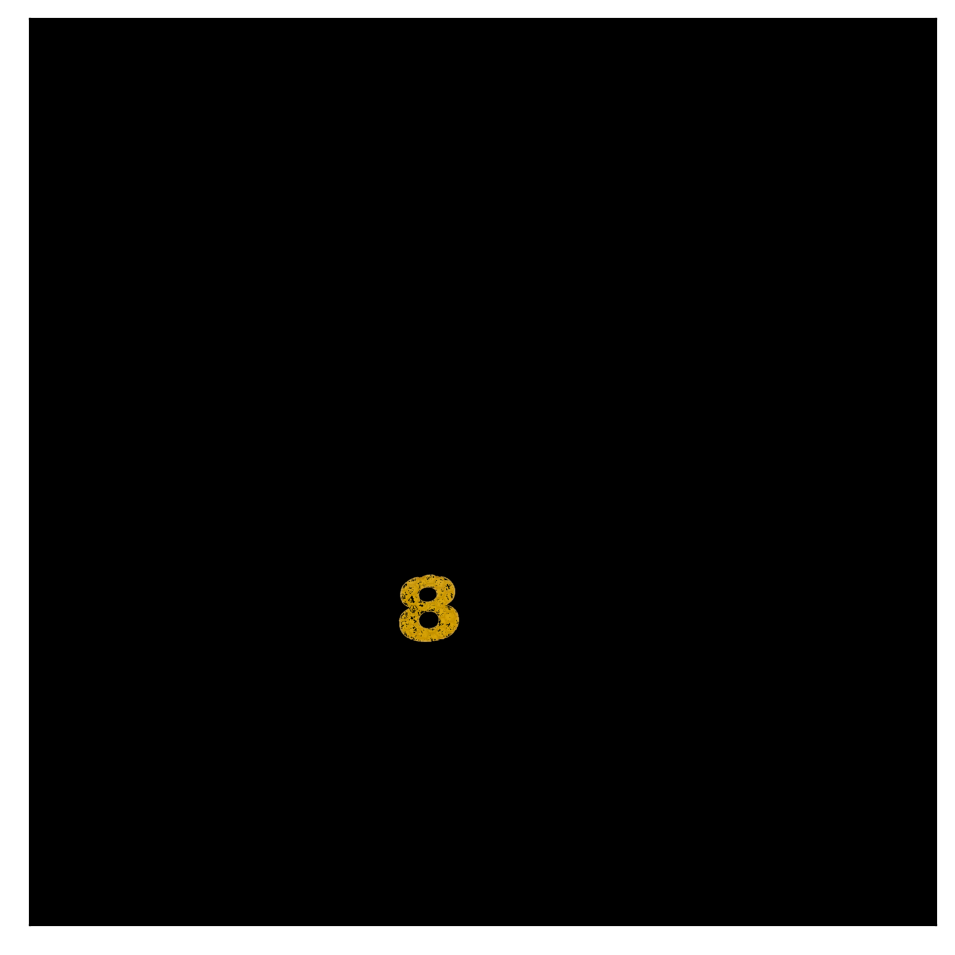

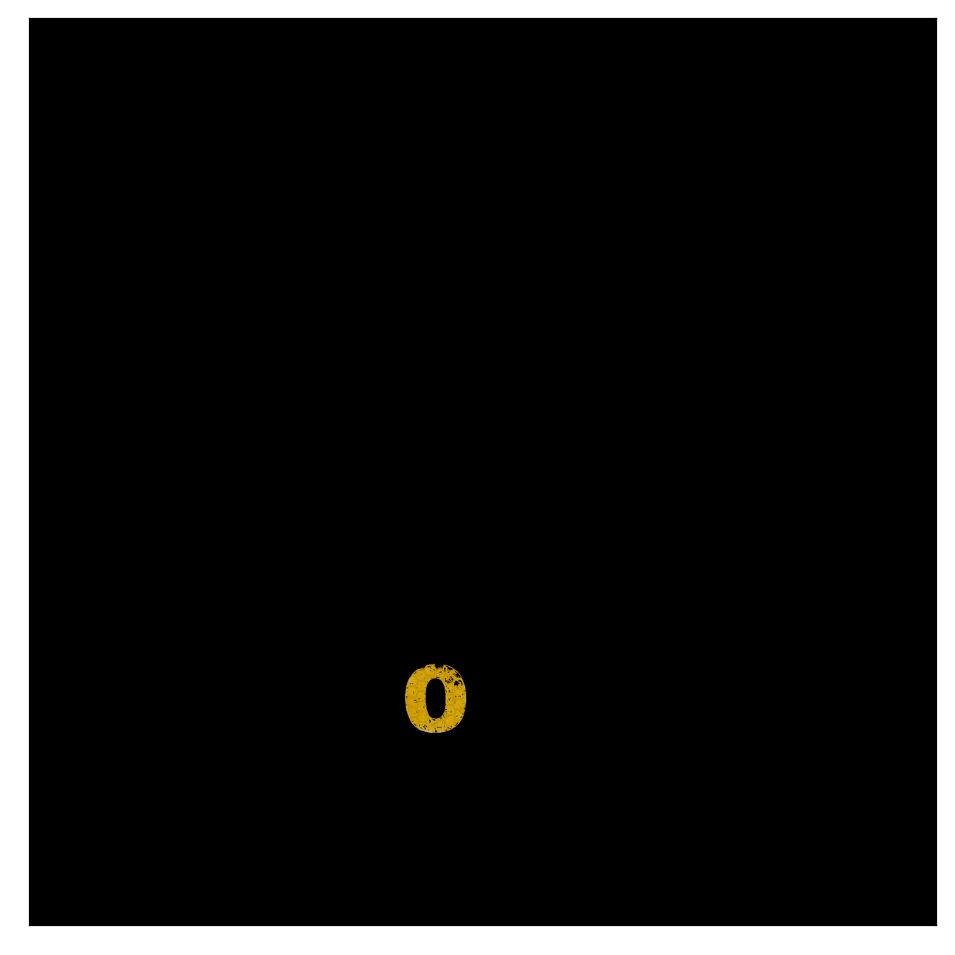

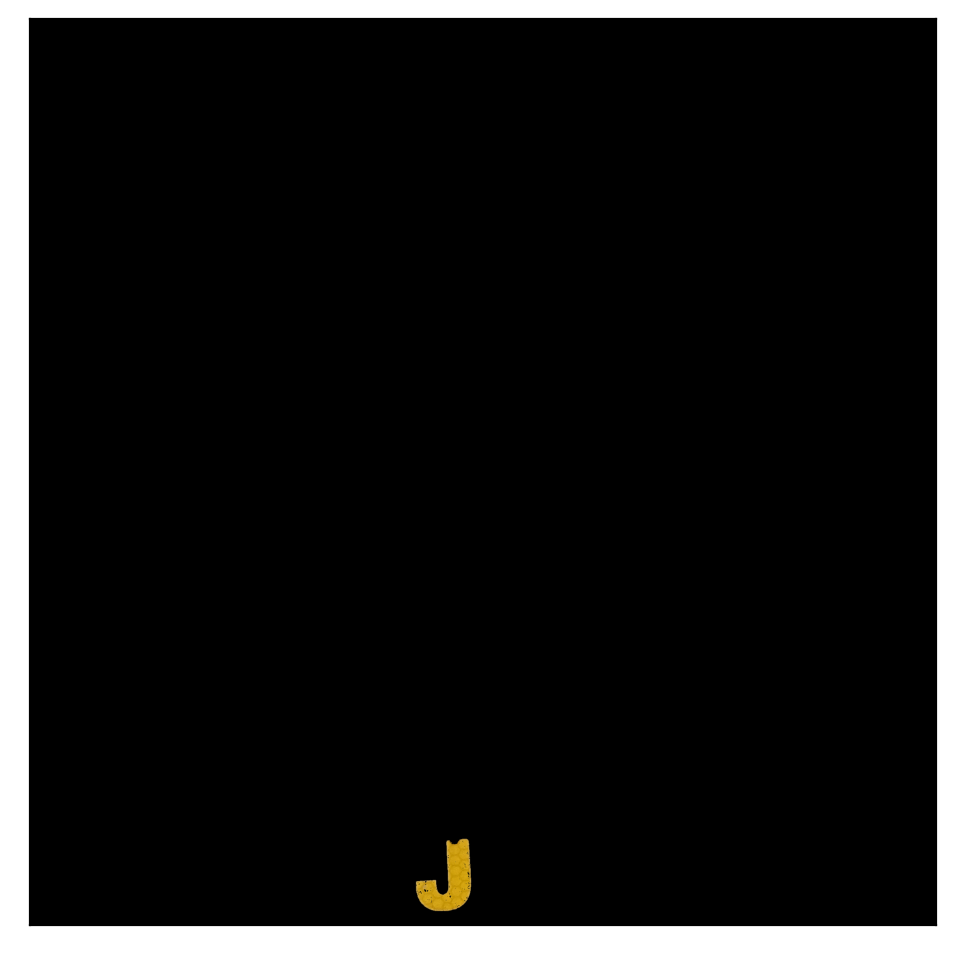

RuntimeError: CUDA error: unspecified launch failure

Traceback (most recent call last):
  File "/home/dusty/.local/share/JetBrains/Toolbox/apps/PyCharm-P/ch-0/212.4746.96/plugins/python/helpers/pydev/_pydevd_bundle/pydevd_frame.py", line 861, in trace_dispatch
    result = plugin_manager.cmd_step_over(main_debugger, frame, event, self._args, stop_info, stop)
  File "/home/dusty/.local/share/JetBrains/Toolbox/apps/PyCharm-P/ch-0/212.4746.96/plugins/python/helpers-pro/jupyter_debug/pydev_jupyter_plugin.py", line 144, in cmd_step_over
    if _is_inside_jupyter_cell(frame, pydb):
  File "/home/dusty/.local/share/JetBrains/Toolbox/apps/PyCharm-P/ch-0/212.4746.96/plugins/python/helpers-pro/jupyter_debug/pydev_jupyter_plugin.py", line 209, in _is_inside_jupyter_cell
    if is_cell_filename(filename):
  File "/home/dusty/.local/share/JetBrains/Toolbox/apps/PyCharm-P/ch-0/212.4746.96/plugins/python/helpers-pro/jupyter_debug/pydev_jupyter_plugin.py", line 220, in is_cell_filename
    ipython_shell = get_ipython()
NameError: name 'get_ipython' is n

In [449]:
file = files[3]
best_image = cv2.imread(file)

cropped_img = crop_image(best_image, 0.6)
img = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)
img_hsv = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2HSV)
gray = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
colored_portion = img.copy()
normalizedImg = np.zeros(colored_portion.shape)

for i in range(1):
	img_hsv = cv2.cvtColor(colored_portion, cv2.COLOR_RGB2HSV)
	h, s, v, = cv2.split(img_hsv)
	avg_h = int(np.mean(h) / 2.0)
	avg_s = int(np.mean(s))
	avg_v = int(np.mean(v))

	print(f"averages: {avg_h}, {avg_s}, {avg_v}")

	mask = cv2.inRange(img_hsv, np.asarray([20, 0, 160]), np.asarray([30, 255, 220]))
	# mask = cv2.inRange(img_hsv, np.asarray([0, 0, 0]), np.asarray([255, avg_s, 255]))
	colored_portion = cv2.cv2.bitwise_and(img, img, mask=mask)

	gray = cv2.cvtColor(colored_portion, cv2.COLOR_BGR2GRAY)
	# show_image(gray)
	ret,thresh1 = cv2.threshold(gray,avg_s,255,cv2.THRESH_BINARY)

	nb_components, output, stats, centroids = cv2.connectedComponentsWithStats(thresh1, connectivity = 8)
	sizes = stats[1:, -1]; nb_components = nb_components - 1
	min_size = 1500
	img2 = np.zeros((output.shape))
	blank_image = img2.copy()
	separate_images = []
	#for every component in the image, you keep it only if it's above min_size
	for i in range(0, nb_components):
		if sizes[i] >= min_size:
			img2[output == i + 1] = 255
			sep = blank_image.copy()
			sep[output == i + 1] = 255
			sep = cv2.normalize(src=sep, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
			separate_images.append(sep)
	img2 = cv2.normalize(src=img2, dst=None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
	colored_portion = cv2.bitwise_and(img, img, mask=img2)

	for sep in separate_images:
		color_sep = cv2.bitwise_and(img, img, mask=sep)
		show_image(color_sep)

	# OCR
	results_ocr = ocr.readtext(colored_portion)
	print(results_ocr)
	results_tess = pytesseract.image_to_string(colored_portion)
	print(results_tess)

	# show_image(img_hsv)
	# show_image(gray)
	show_image(colored_portion)
	# show_image(img)

	# colored_portion = cv2.normalize(colored_portion, colored_portion, np.min(colored_portion), np.max(colored_portion), cv2.NORM_MINMAX)
	#
	# gray = cv2.cvtColor(colored_portion, cv2.COLOR_BGR2GRAY)
	# edges = cv2.Canny(gray, avg_s, 255)
	# # edges = colored_portion.copy()
	#
	# # gray = cv2.cvtColor(edges, cv2.COLOR_BGR2GRAY)
	# ret, thresh = cv2.threshold(edges, 10, 255, cv2.THRESH_BINARY)
	# show_image(thresh)
	#
	# contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
	# c_max = []
	# h, w = edges.shape
	#
	# for i in range(len(contours)):
	# 	if hierarchy[i][3] == -1:
	# 		cv2.drawContours(edges, )
	# show_image(edges)




Use load_from_http loader
Use load_from_http loader
DB_r18 CRNN text: [{'filename': '0', 'text': ['']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


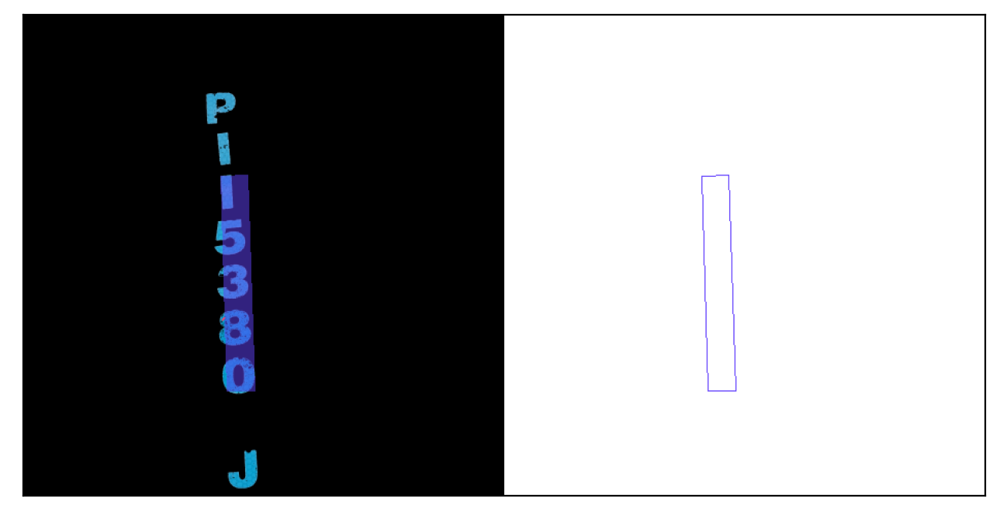

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


DB_r18 SAR text: [{'filename': '0', 'text': ['other']}]


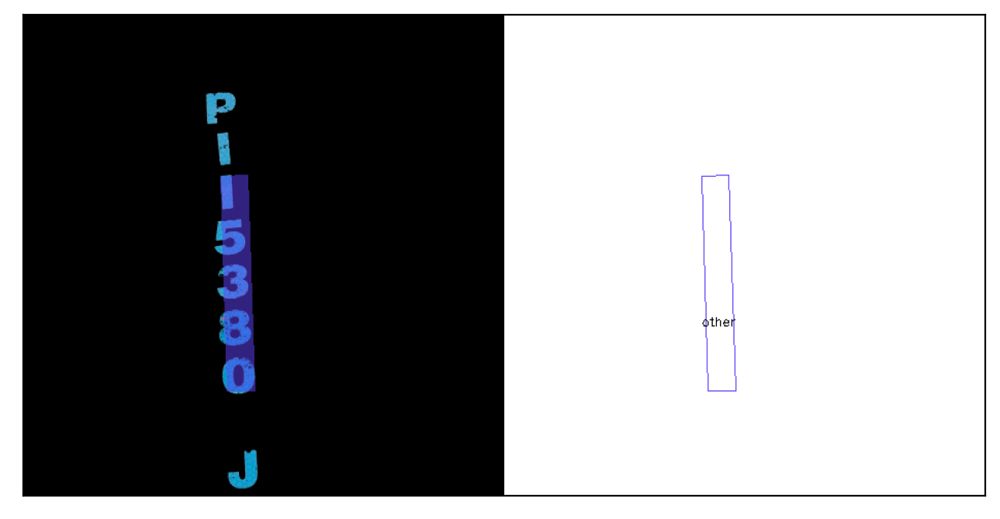

Use load_from_http loader
Use load_from_http loader
DB_r18 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['and']}]


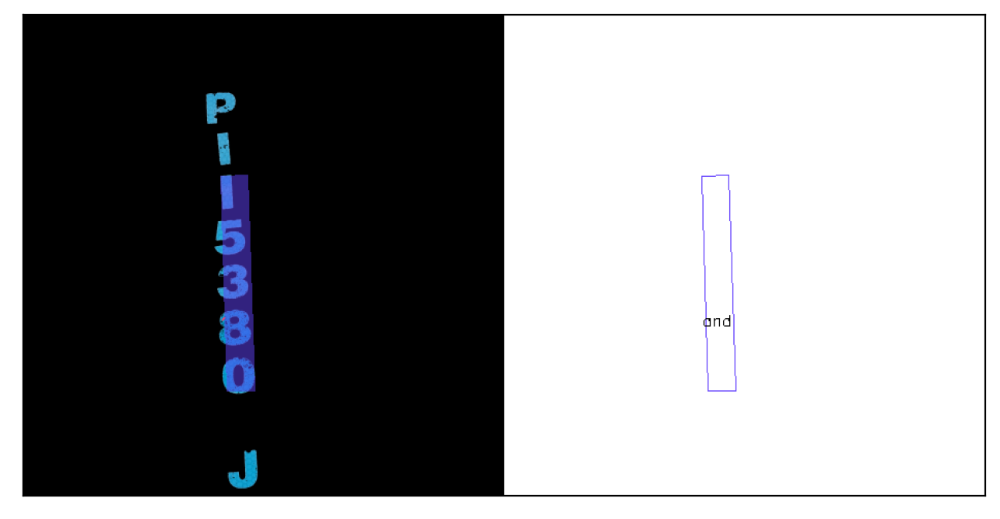

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


DB_r18 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['-drive']}]


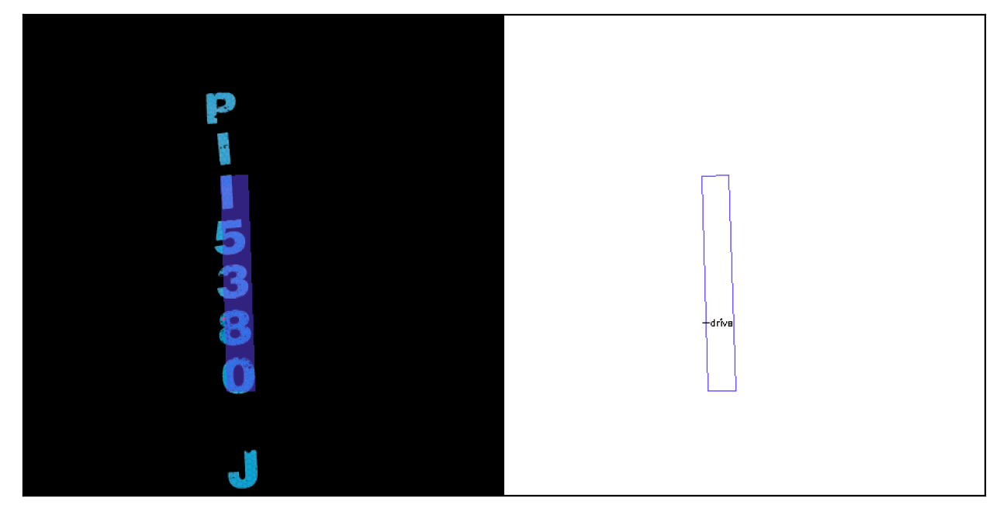

Use load_from_http loader
Use load_from_http loader
DB_r18 SEG text: [{'filename': '0', 'text': ['']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


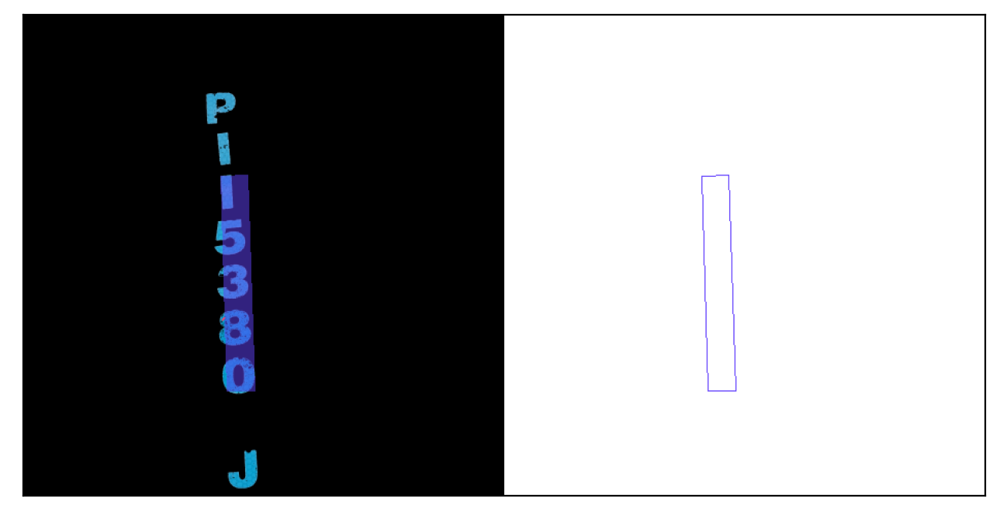

Use load_from_http loader
Use load_from_http loader
DB_r18 CRNN_TPS text: [{'filename': '0', 'text': ['']}]


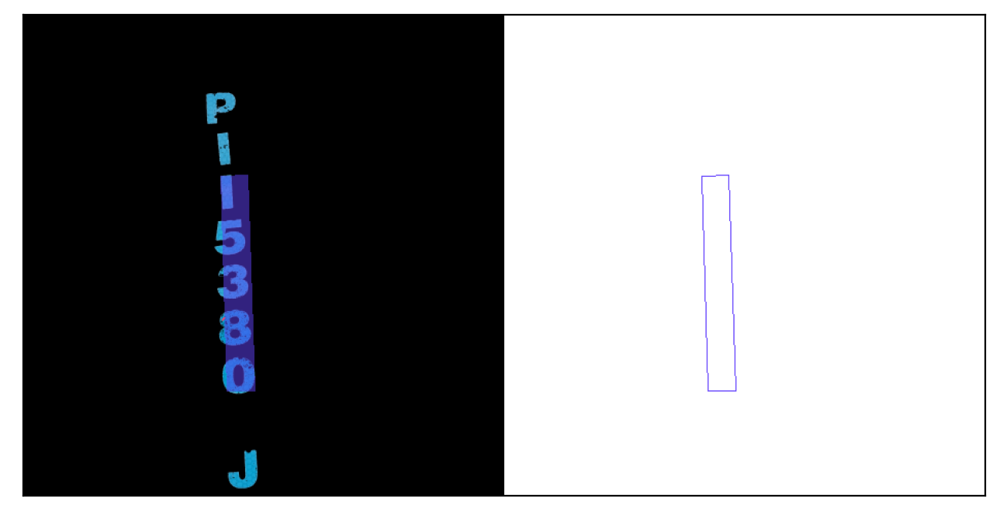

Use load_from_http loader
Use load_from_http loader
DB_r50 CRNN text: [{'filename': '0', 'text': ['j', '']}]


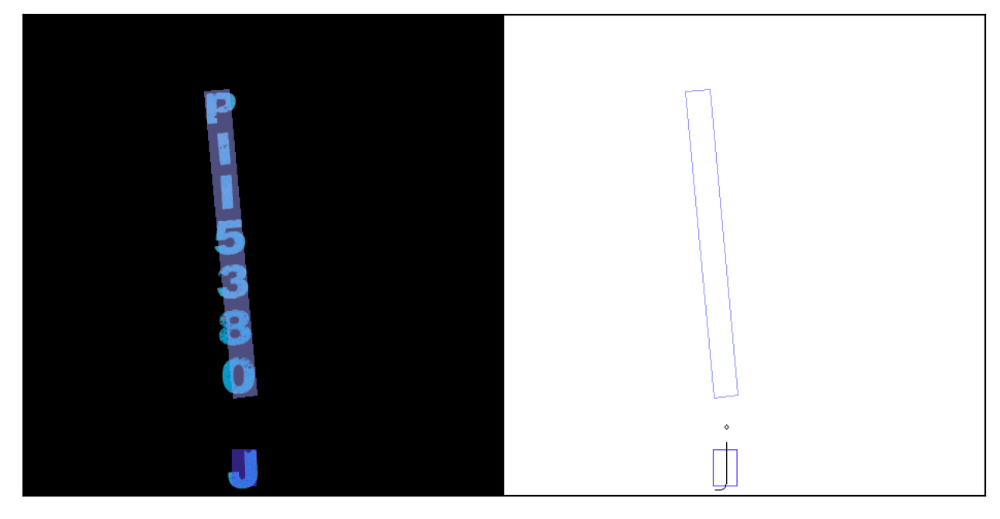

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


DB_r50 SAR text: [{'filename': '0', 'text': ['J', 'construction']}]


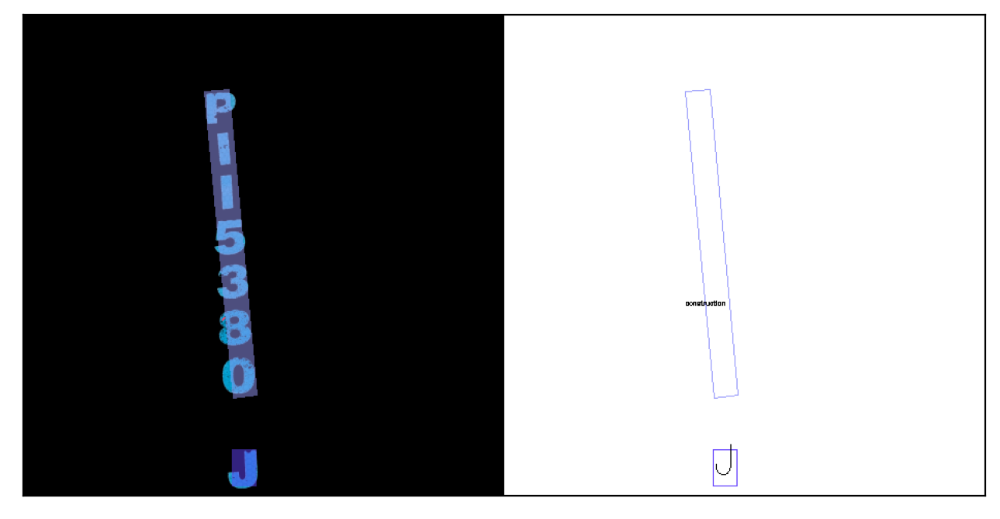

Use load_from_http loader
Use load_from_http loader
DB_r50 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['J', 'Newsgroups:']}]


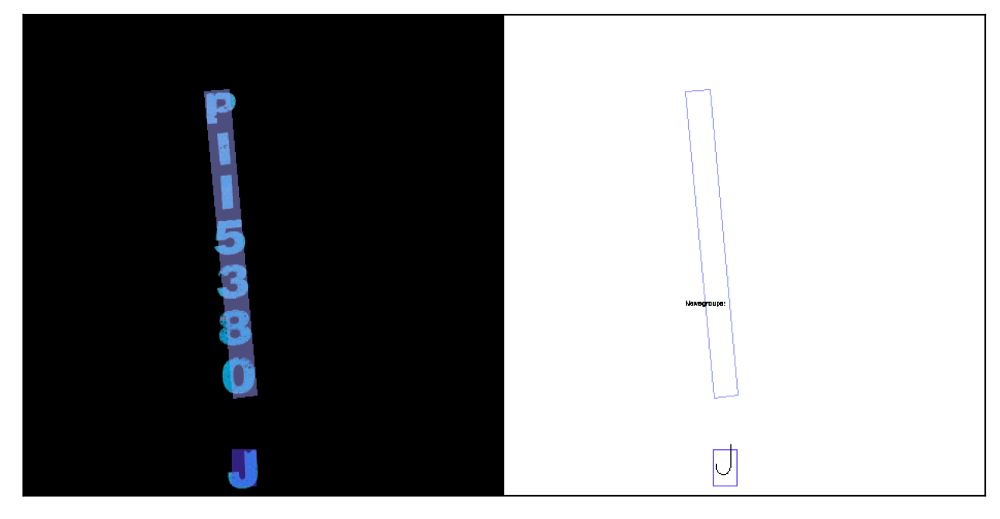

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


DB_r50 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['&', '(Allows)']}]


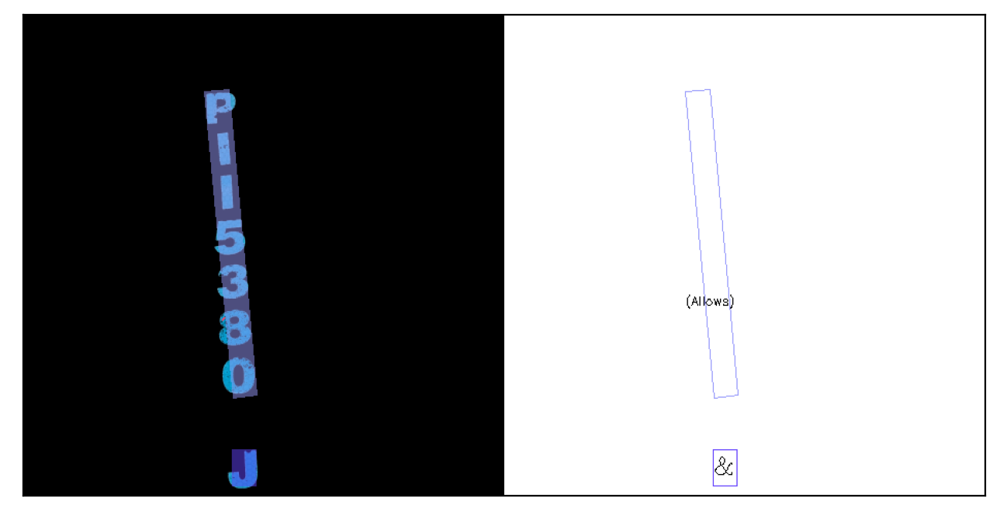

Use load_from_http loader
Use load_from_http loader
DB_r50 SEG text: [{'filename': '0', 'text': ['j', '']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


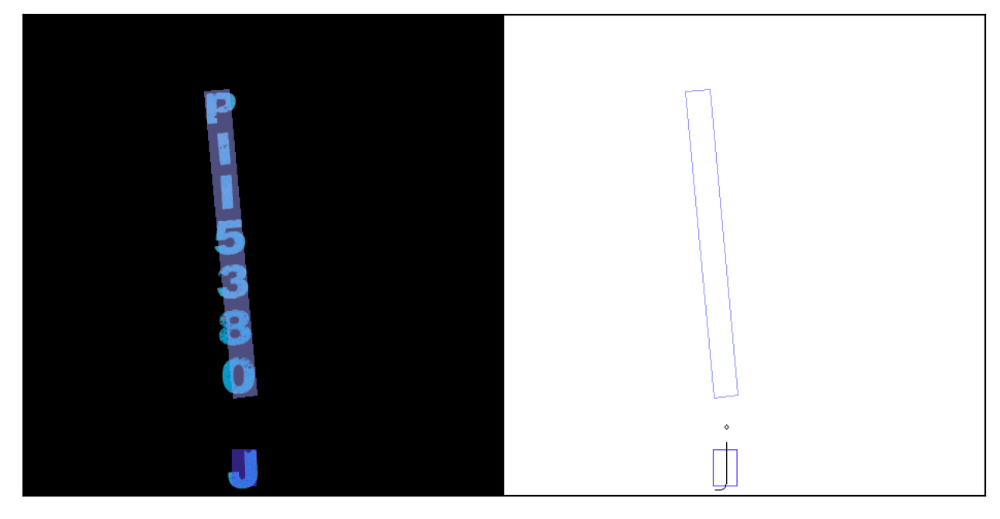

Use load_from_http loader
Use load_from_http loader
DB_r50 CRNN_TPS text: [{'filename': '0', 'text': ['wjj', 'e']}]


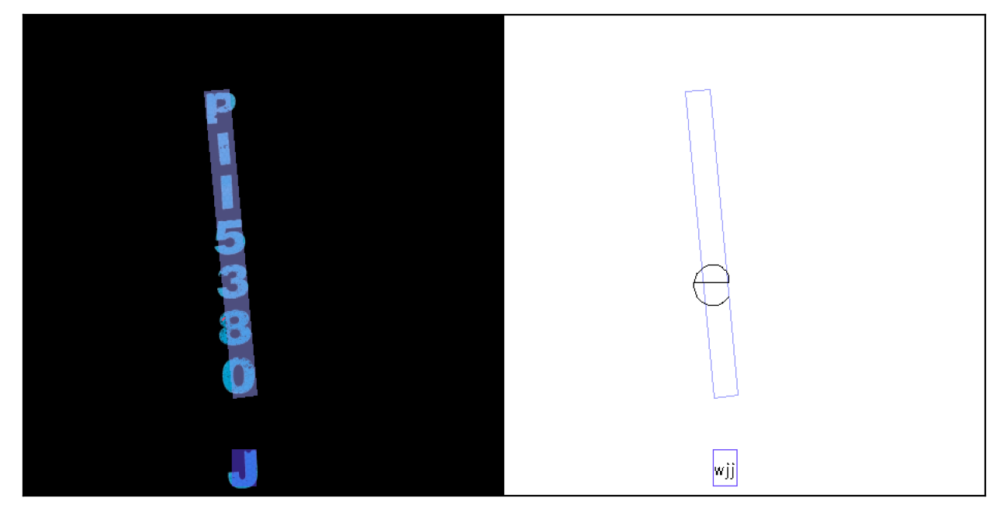

Use load_from_http loader
Use load_from_http loader


/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:584: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://

DRRG CRNN text: [{'filename': '0', 'text': ['p', '', 'j']}]


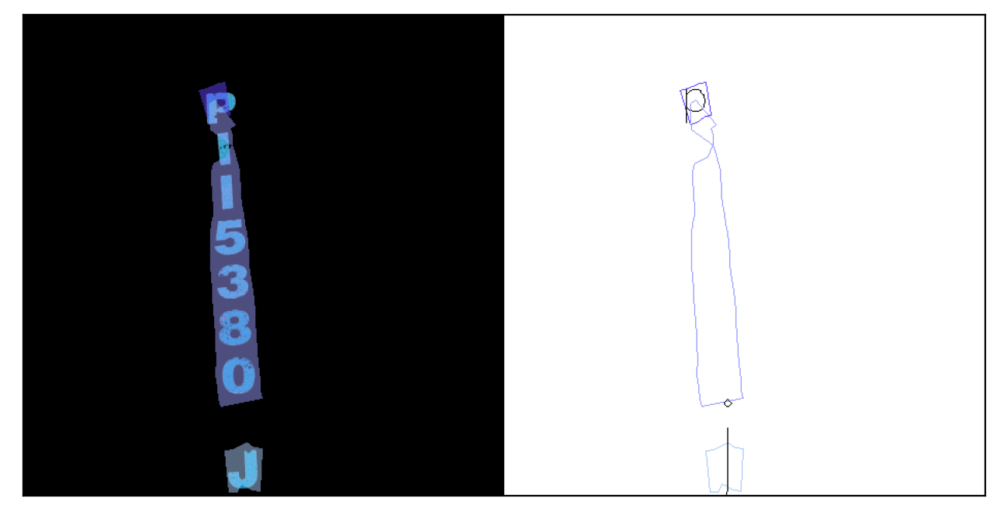

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

DRRG SAR text: [{'filename': '0', 'text': ['the', 'article', 'J']}]


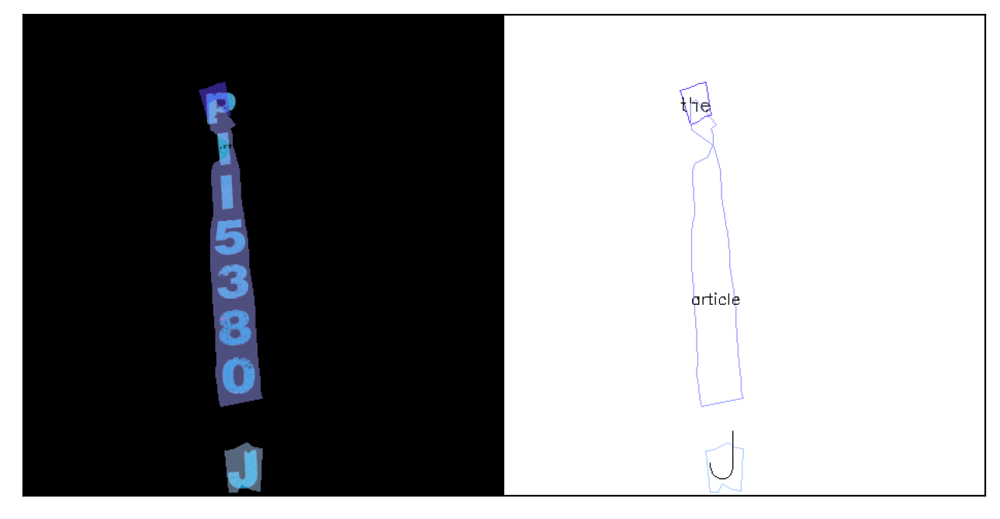

Use load_from_http loader
Use load_from_http loader
DRRG NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['P', 'Children)', 'J']}]


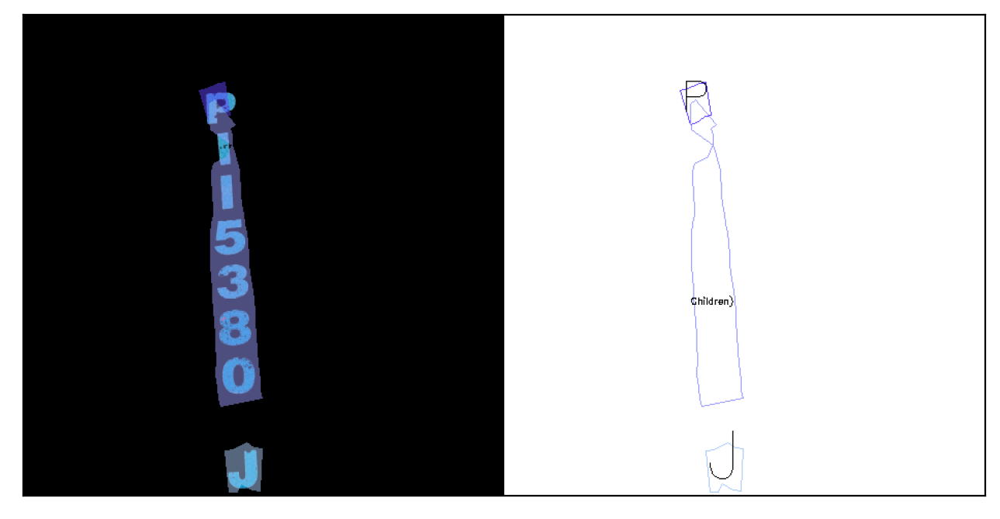

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

DRRG NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['p', 'Message-ID:', 'J']}]


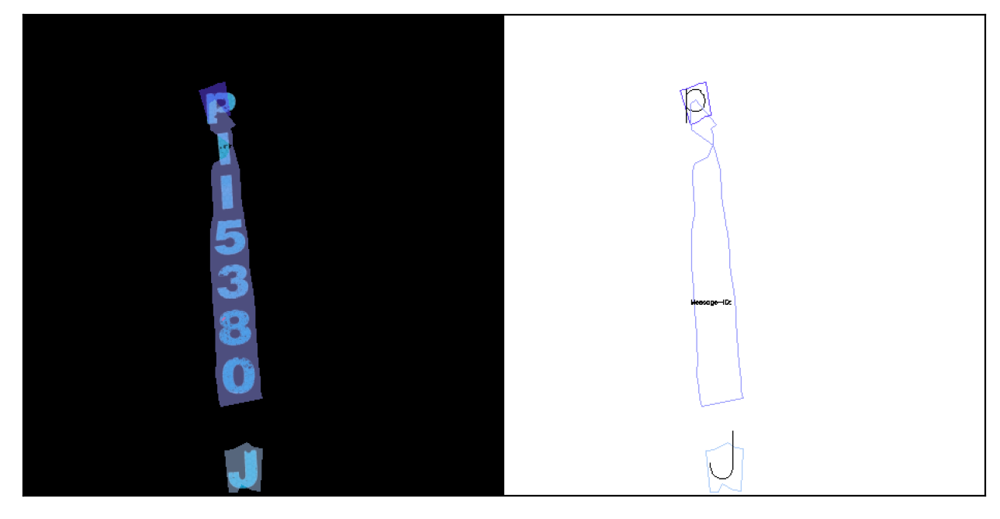

Use load_from_http loader
Use load_from_http loader
DRRG SEG text: [{'filename': '0', 'text': ['', 'p', 'j']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


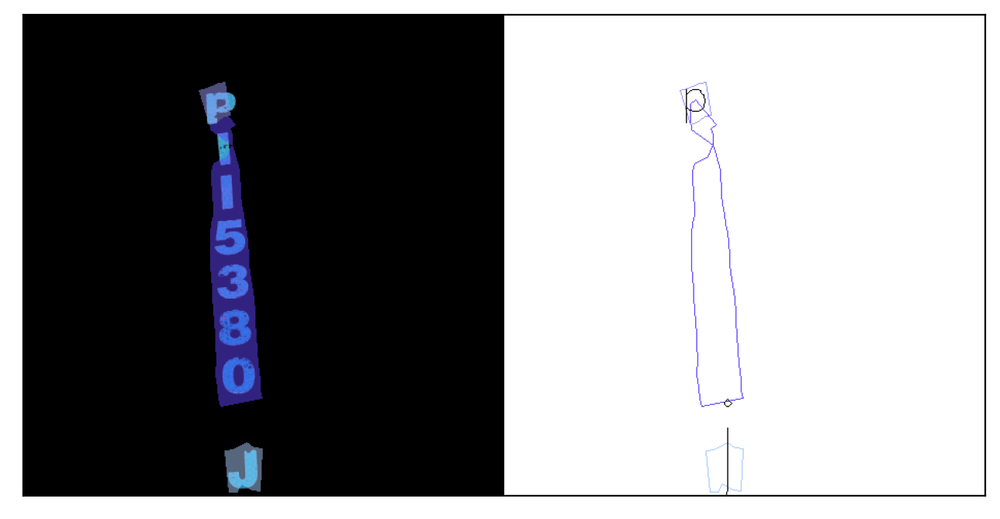

Use load_from_http loader
Use load_from_http loader
DRRG CRNN_TPS text: [{'filename': '0', 'text': ['', 'f', 'u']}]


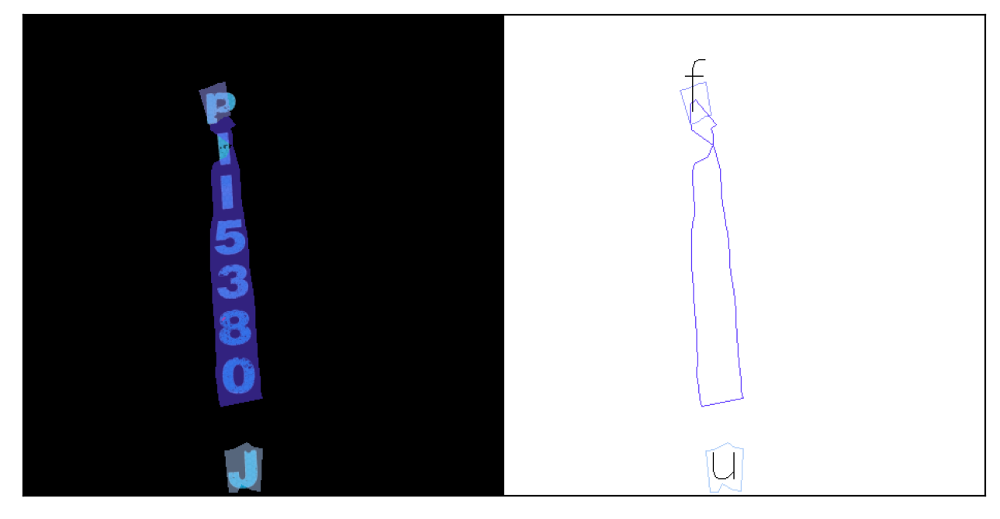

Use load_from_http loader
Use load_from_http loader
FCE_IC15 CRNN text: [{'filename': '0', 'text': []}]


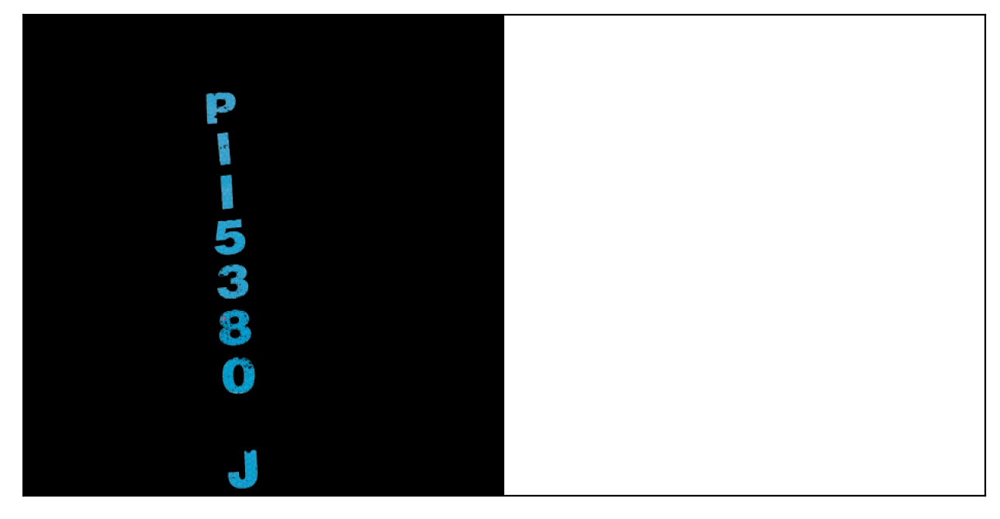

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


FCE_IC15 SAR text: [{'filename': '0', 'text': []}]


/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)


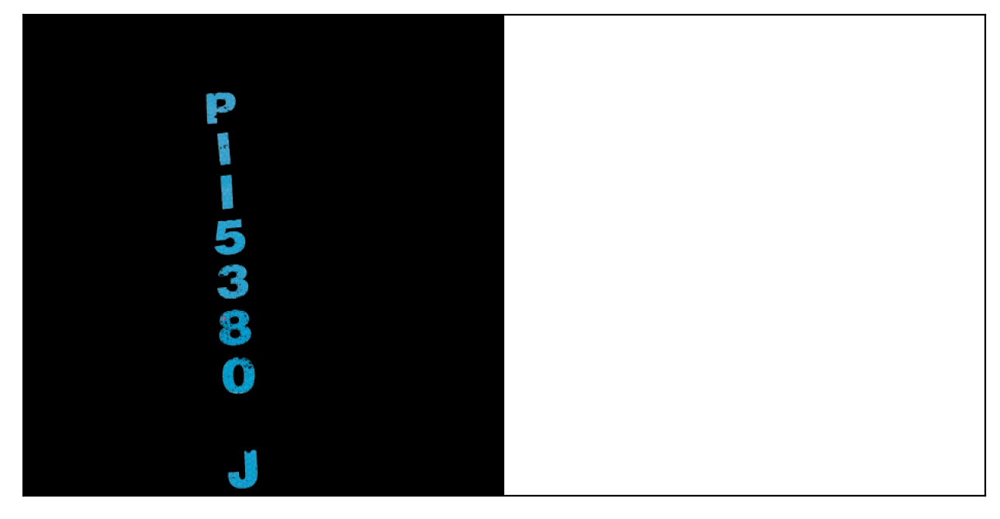

Use load_from_http loader
Use load_from_http loader
FCE_IC15 NRTR_1/16-1/8 text: [{'filename': '0', 'text': []}]


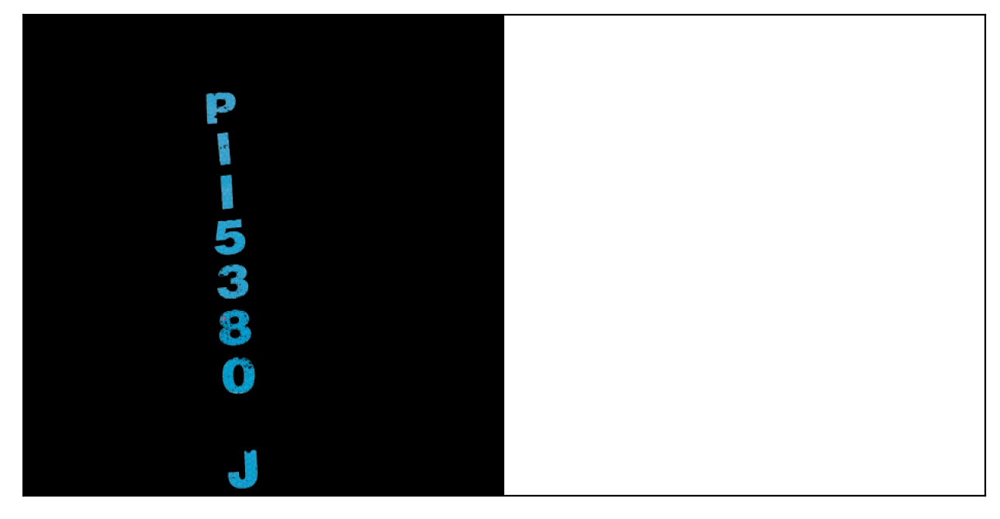

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


FCE_IC15 NRTR_1/8-1/4 text: [{'filename': '0', 'text': []}]


/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)


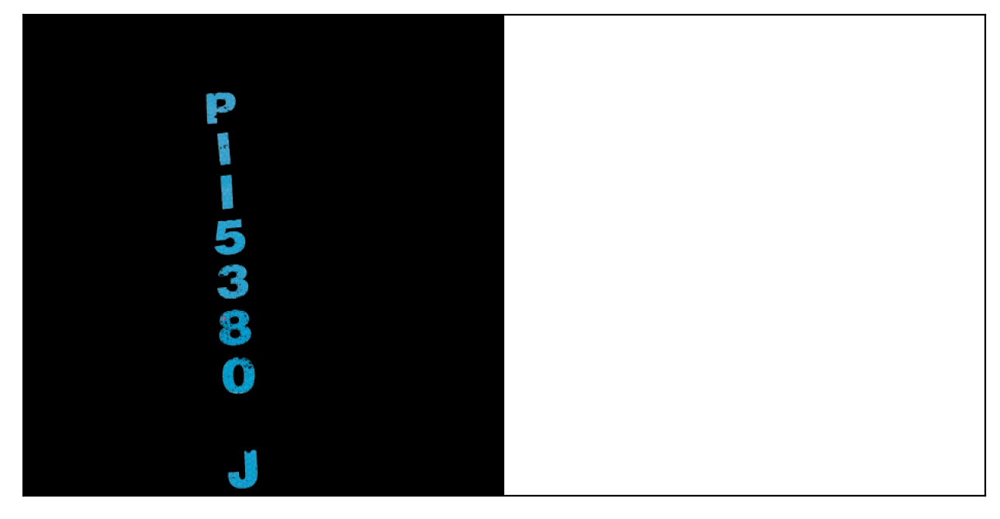

Use load_from_http loader
Use load_from_http loader
FCE_IC15 SEG text: [{'filename': '0', 'text': []}]


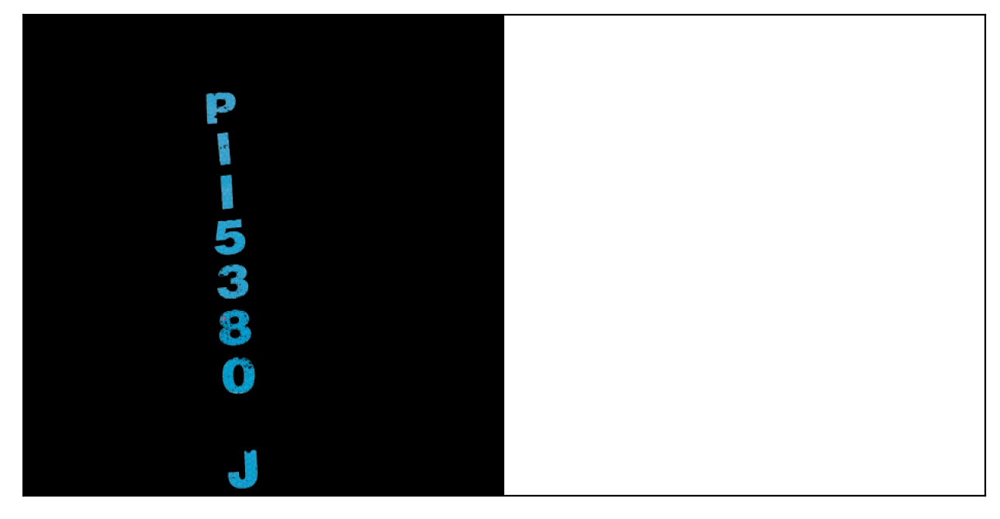

Use load_from_http loader
Use load_from_http loader
FCE_IC15 CRNN_TPS text: [{'filename': '0', 'text': []}]


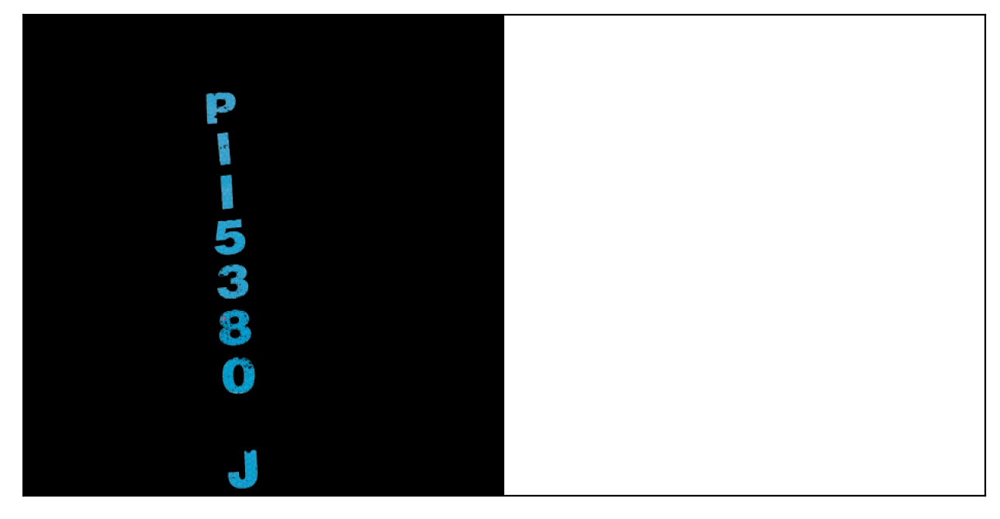

Use load_from_http loader


Downloading: "https://download.openmmlab.com/mmocr/textdet/fcenet/fcenet_r50dcnv2_fpn_1500e_ctw1500-05d740bb.pth" to /home/dusty/.cache/torch/hub/checkpoints/fcenet_r50dcnv2_fpn_1500e_ctw1500-05d740bb.pth


  0%|          | 0.00/107M [00:00<?, ?B/s]

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

Use load_from_http loader
FCE_CTW_DCNv2 CRNN text: [{'filename': '0', 'text': ['']}]


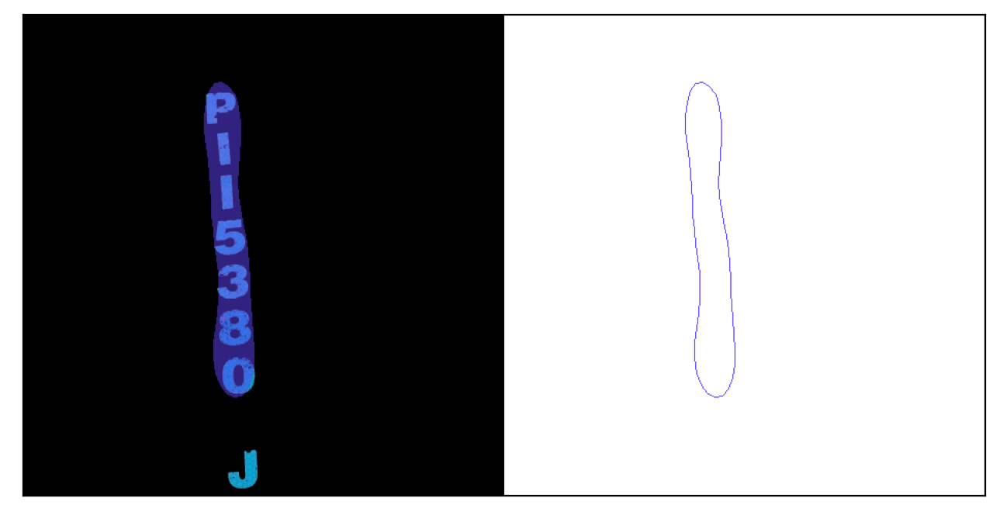

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

FCE_CTW_DCNv2 SAR text: [{'filename': '0', 'text': ['Jamaica']}]


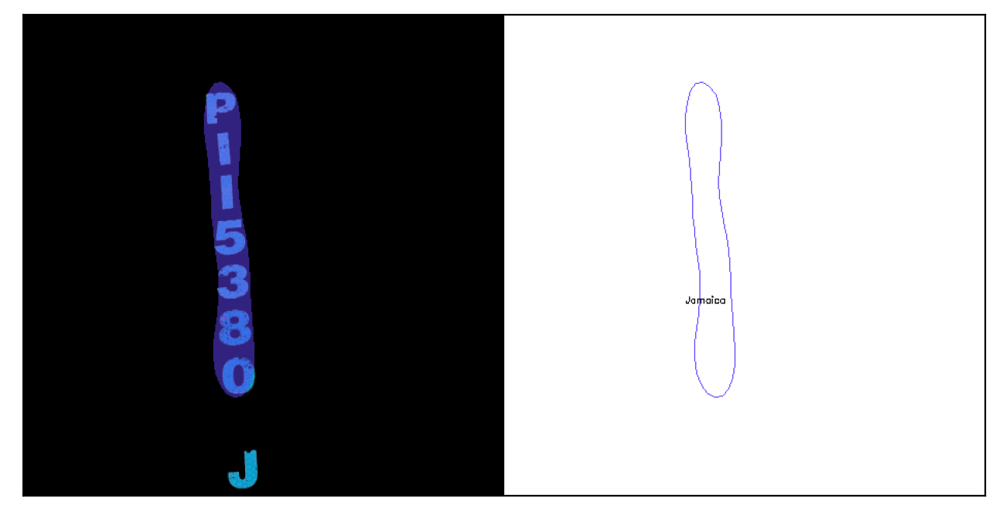

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)


FCE_CTW_DCNv2 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['Newsgroups:']}]


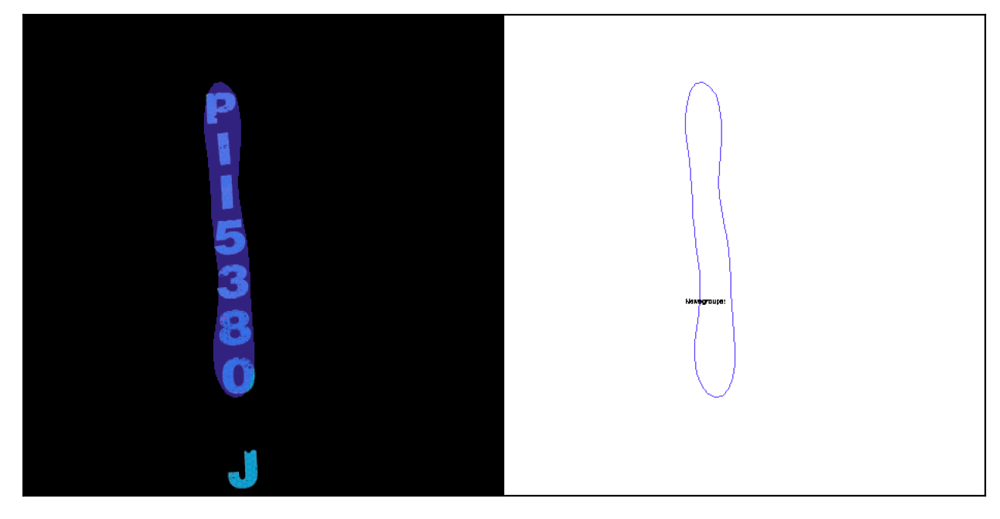

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

FCE_CTW_DCNv2 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['Message-ID:']}]


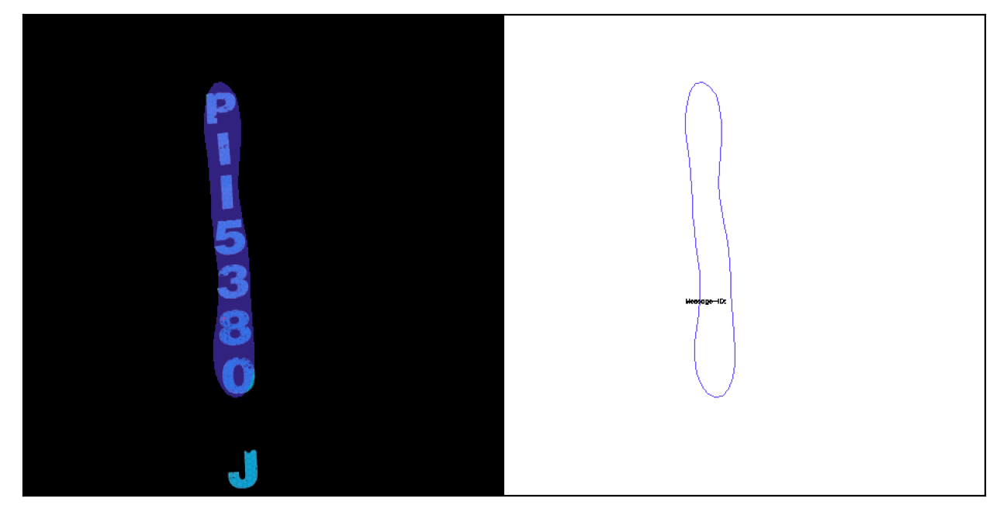

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader
FCE_CTW_DCNv2 SEG text: [{'filename': '0', 'text': ['']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify a

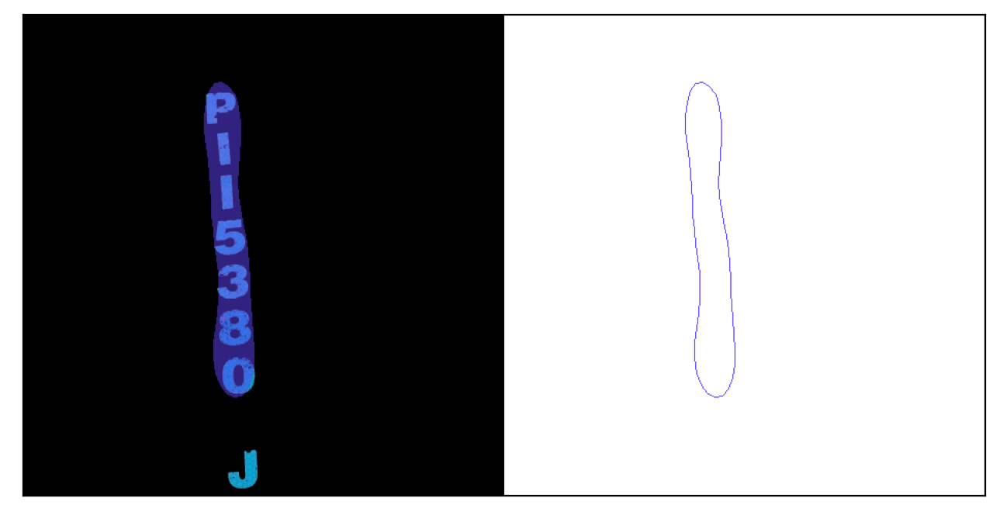

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

FCE_CTW_DCNv2 CRNN_TPS text: [{'filename': '0', 'text': ['']}]


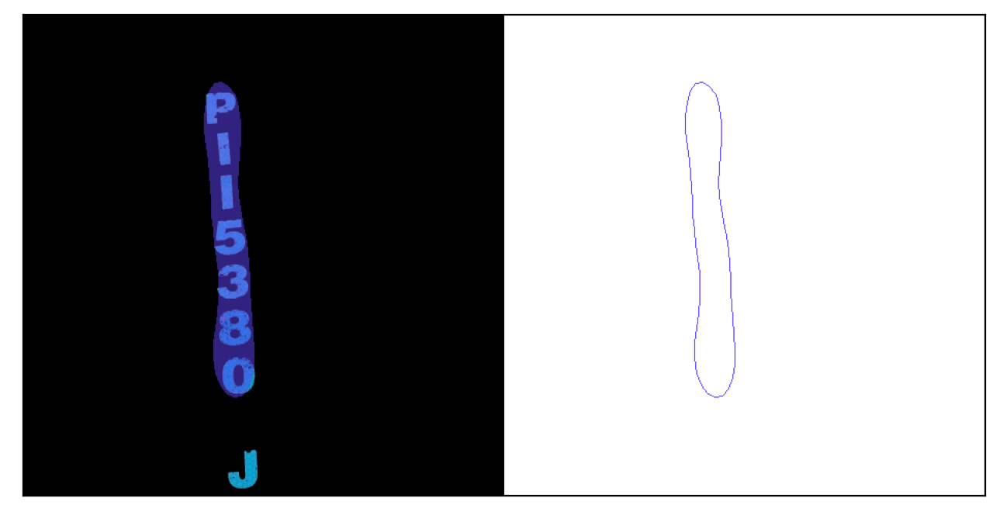

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmcv/utils/misc.py:323: UserWarning: "sample_num" is deprecated in `RoIAlign.__init__`, please use "sampling_ratio" instead
  warnings.warn(


Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  warnings.warn(


MaskRCNN_CTW CRNN text: [{'filename': '0', 'text': ['j', 'p', '', '', '', 's', 's', 's', 'i', 'p', 's', '']}]


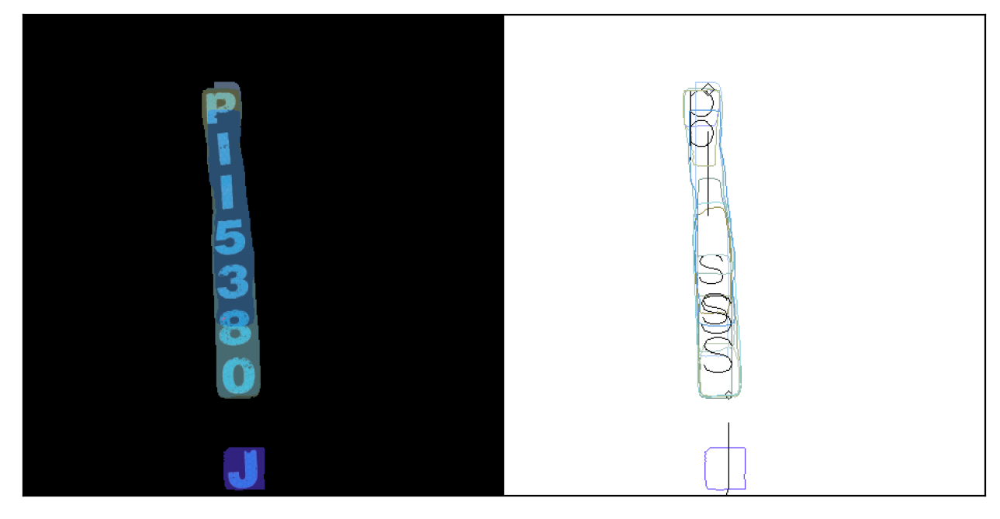

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_CTW SAR text: [{'filename': '0', 'text': ['J', 'IP', 'American', 'only', 'for', 'launch', 'and', 'on', 'CLAB', 'PIER', 'own', 'anything']}]


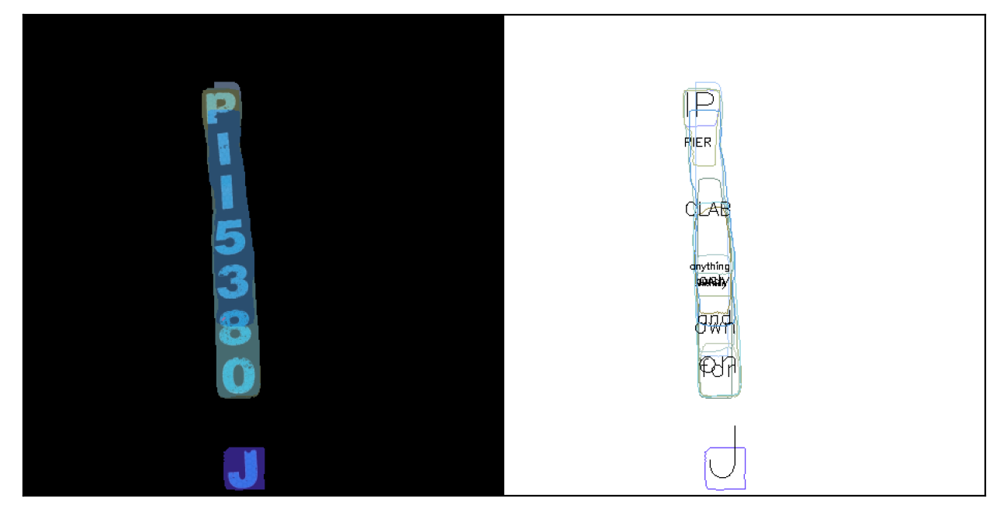

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmcv/utils/misc.py:323: UserWarning: "sample_num" is deprecated in `RoIAlign.__init__`, please use "sampling_ratio" instead
  warnings.warn(


Use load_from_http loader
Use load_from_http loader
MaskRCNN_CTW NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['J', 'Q.', 'Newsgroups:', 'Ability', 'to', '1993', 'WW', 'one', 'Lamps', 'P', 'Message-ID:', 'another']}]


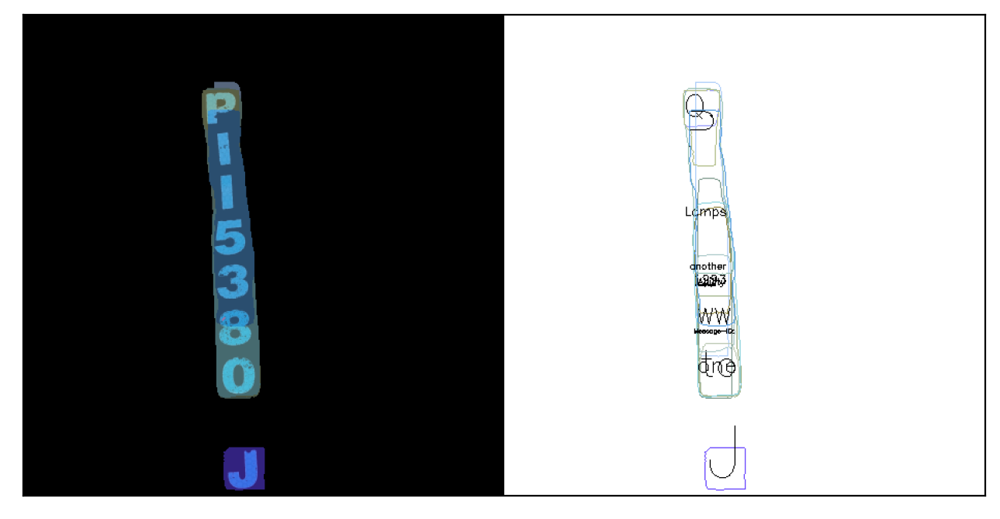

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_CTW NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['J', 'Q,', 'people', 'obbit', '10', '1993', '1993', 'one', 'hand', 'how', 'Message-ID:', 'the']}]


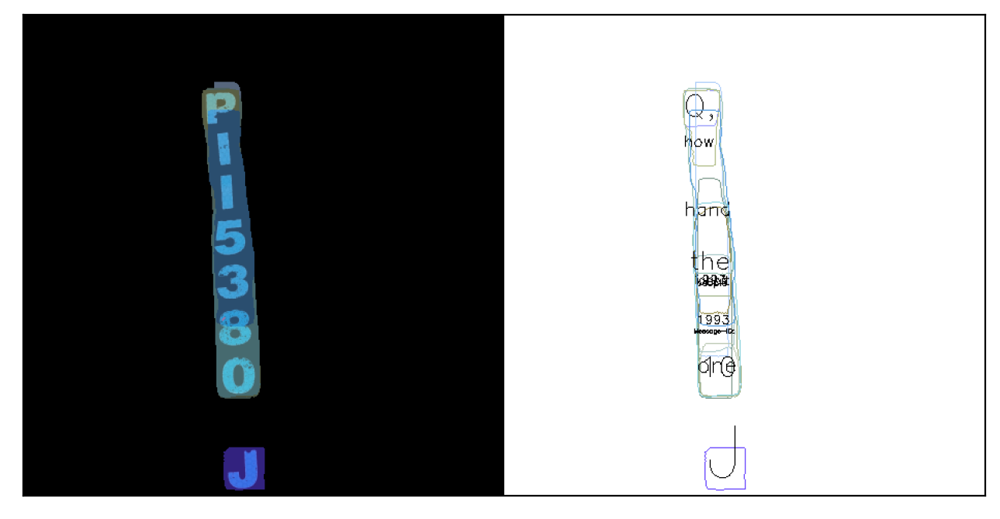

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmcv/utils/misc.py:323: UserWarning: "sample_num" is deprecated in `RoIAlign.__init__`, please use "sampling_ratio" instead
  warnings.warn(


Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


MaskRCNN_CTW SEG text: [{'filename': '0', 'text': ['j', 'p', '', '', 'o', '', '', 'a', 'h', 'pi', 'e', '']}]


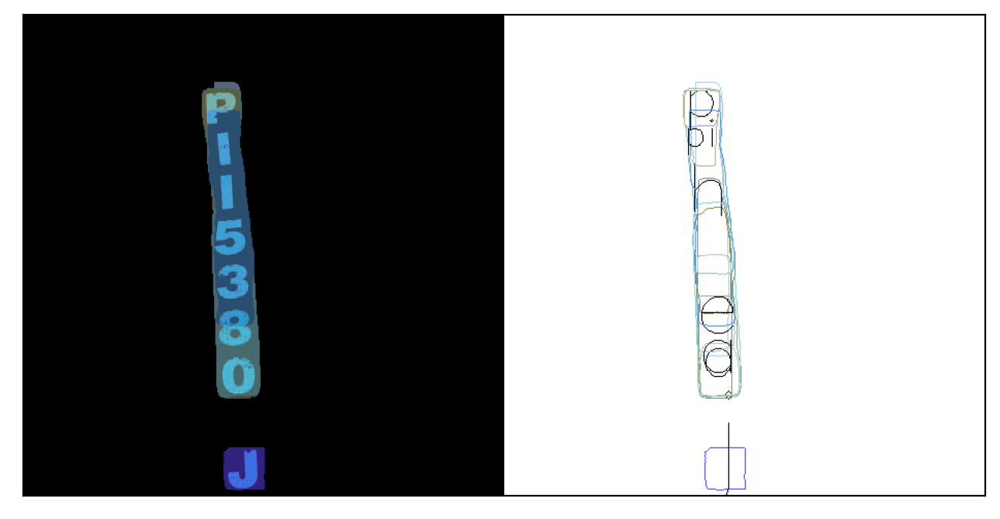

Use load_from_http loader
Use load_from_http loader
MaskRCNN_CTW CRNN_TPS text: [{'filename': '0', 'text': ['j', 'p', 'g', '', 'o', 'z', 'e', 's', 'e', 't', 'e', 'e']}]


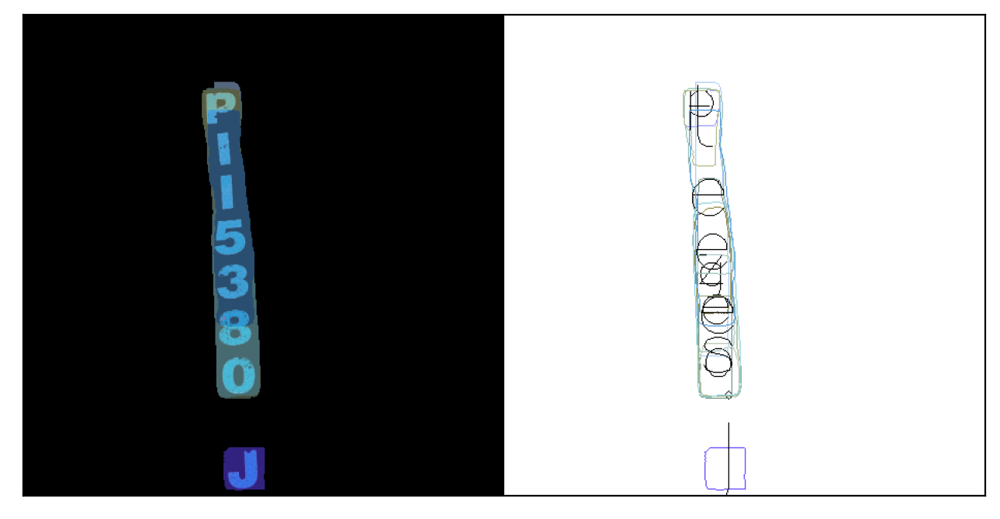

Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC15 CRNN text: [{'filename': '0', 'text': ['p']}]


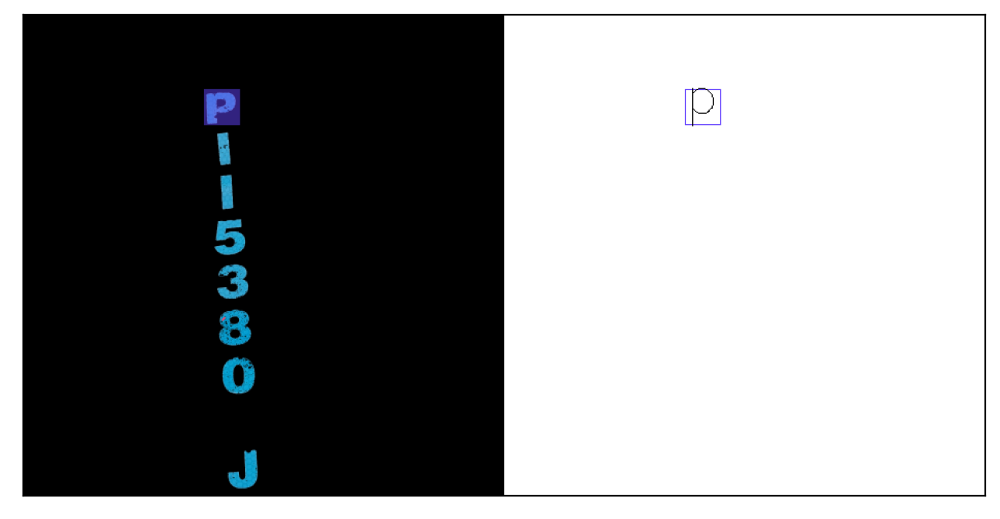

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_IC15 SAR text: [{'filename': '0', 'text': ['IP']}]


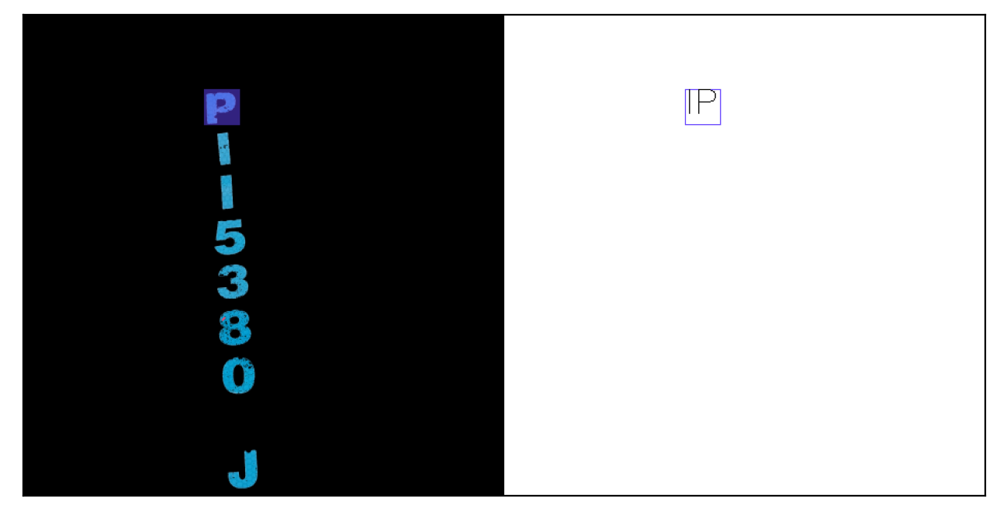

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(


Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC15 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['P']}]


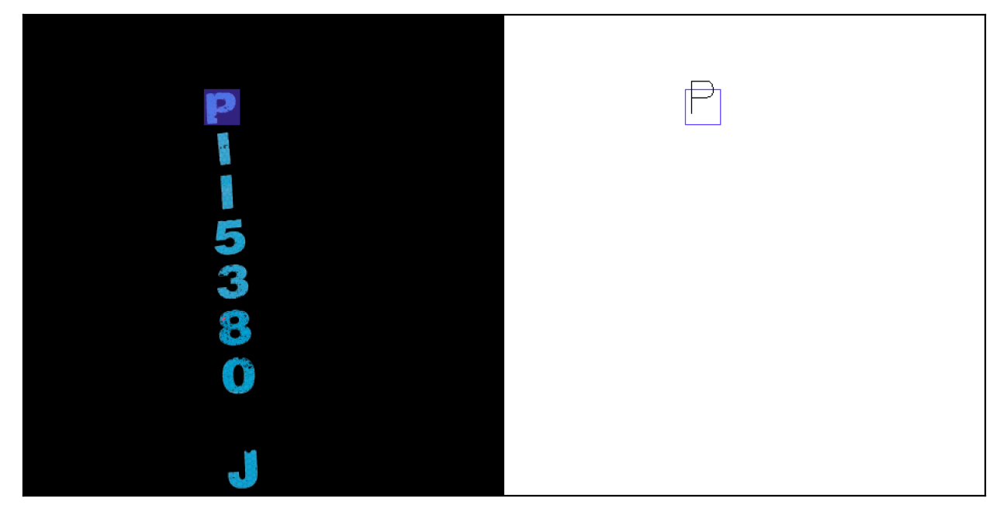

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_IC15 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['P']}]


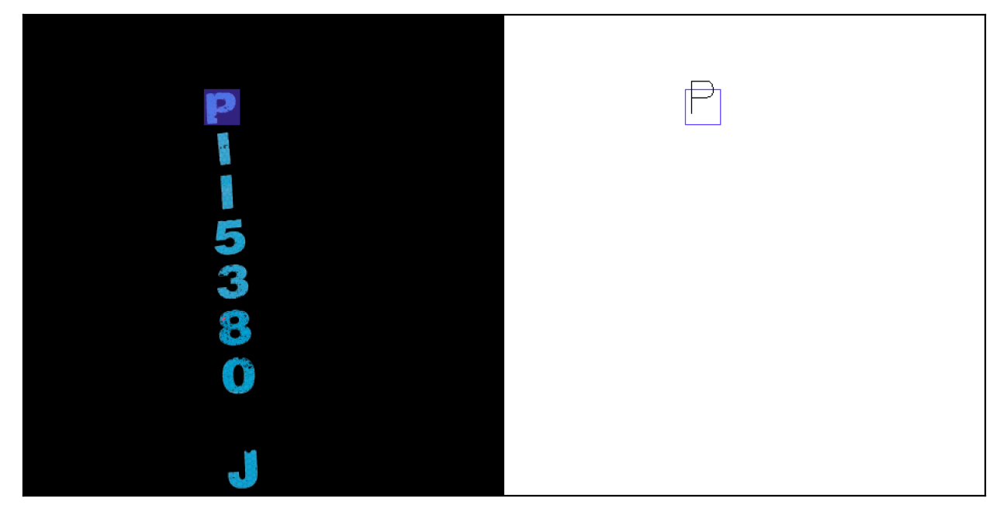

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(


Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC15 SEG text: [{'filename': '0', 'text': ['p']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


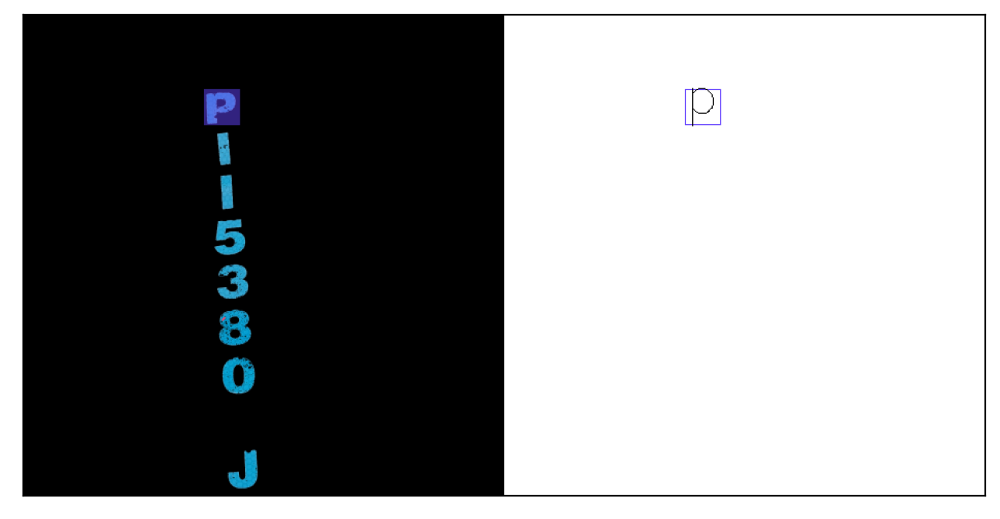

Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC15 CRNN_TPS text: [{'filename': '0', 'text': ['r']}]


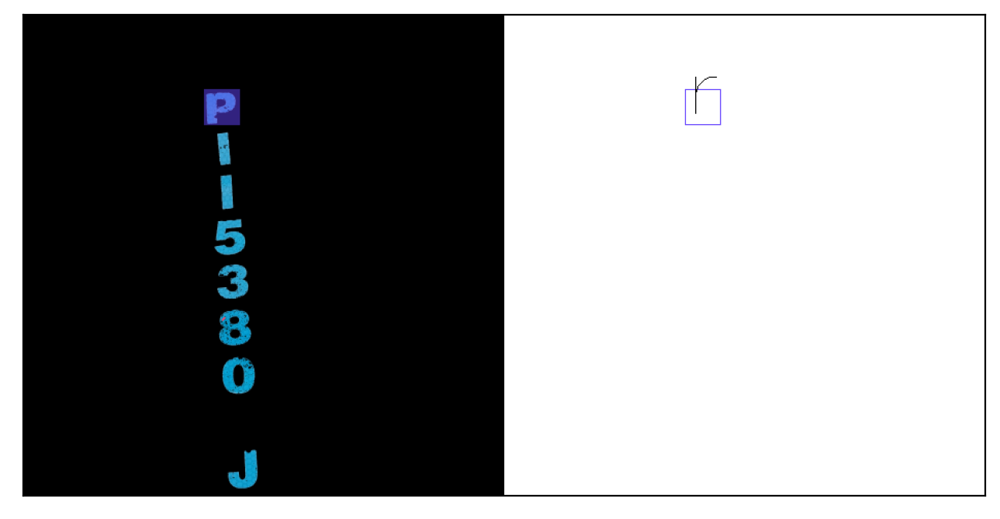

Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC17 CRNN text: [{'filename': '0', 'text': ['o', '', '5', 'j', '', 's', 'p', '3', '8', '', 's', 'j', 'j']}]


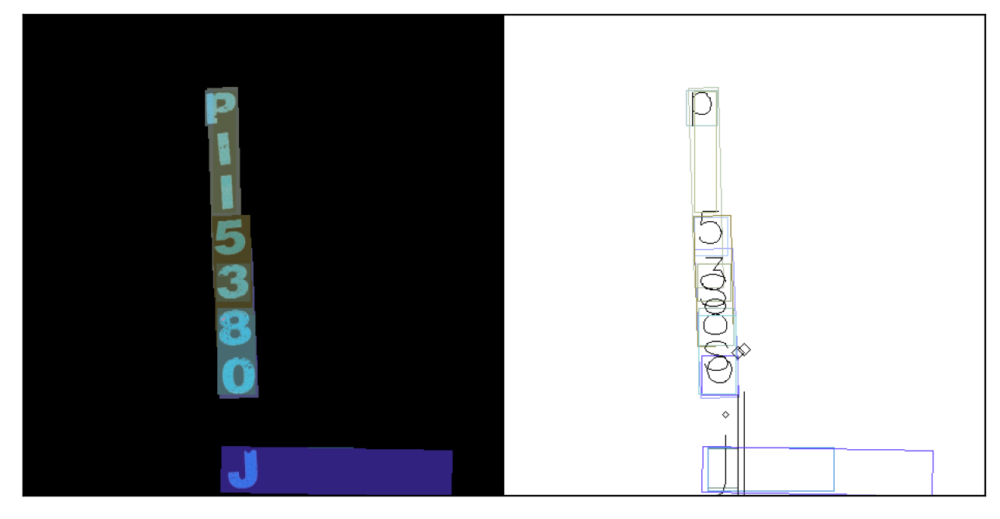

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_IC17 SAR text: [{'filename': '0', 'text': ['O', '@WWU', '5', 'J', 'cartland', 'ann', 'P', '3', 'CO', 'many', 'on', 'Just', 'Jason']}]


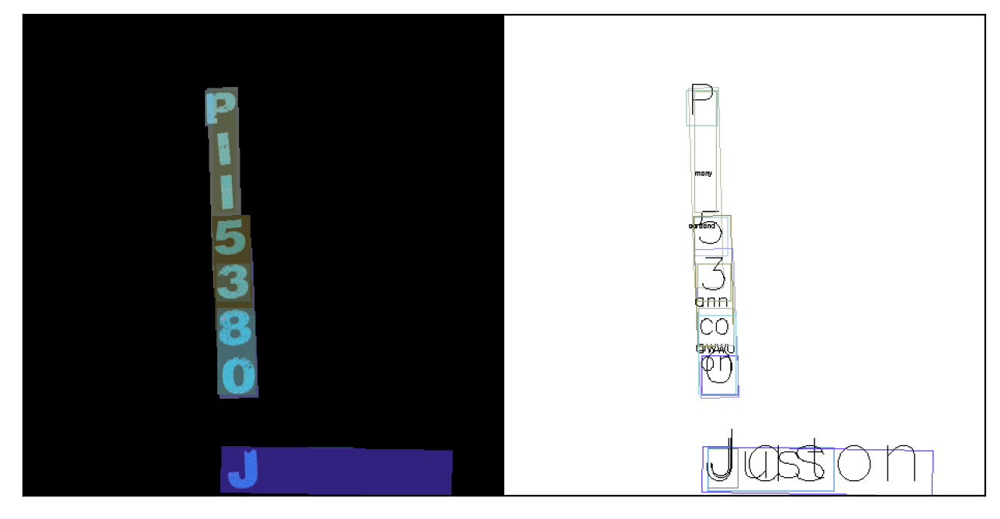

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(


Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC17 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['a', '1993', '5', 'J', 'Anny', '1993', 'Q,', '3', '8', 'Apr', '8', 'Jews', 'Jews']}]


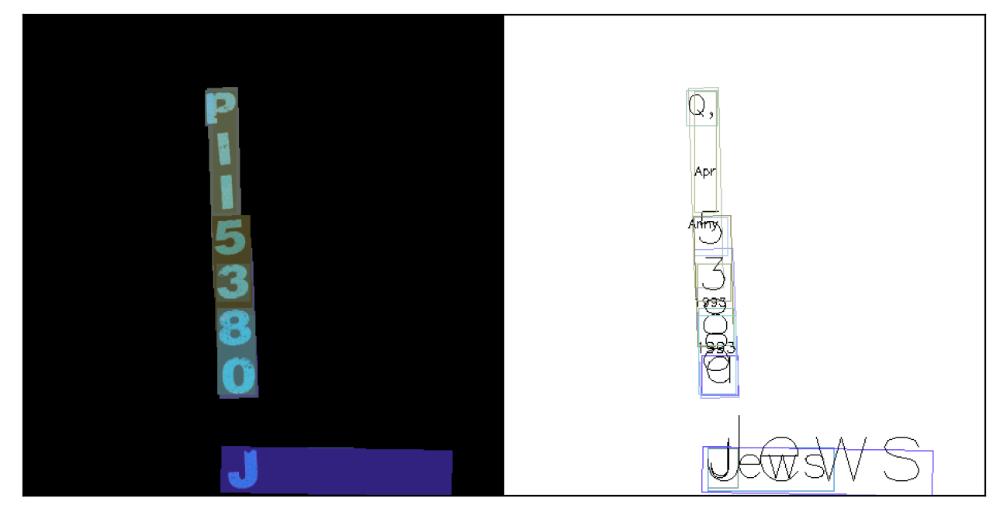

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level

MaskRCNN_IC17 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['a', '1980', '5', 'J', 'Lines:', 'own', 'Q', '3', '8', 'may', '8', 'J.', 'I']}]


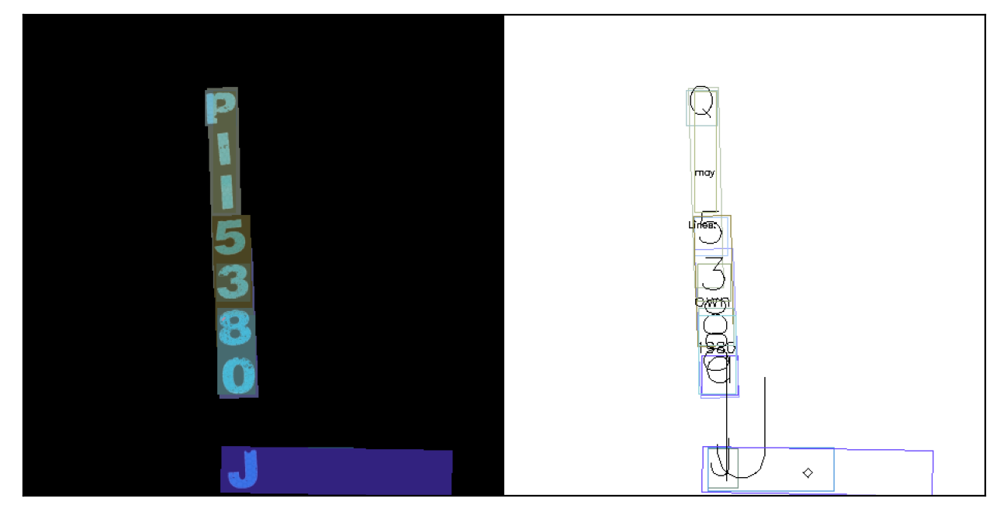

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(


Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


MaskRCNN_IC17 SEG text: [{'filename': '0', 'text': ['o', '', '5', 'jj', '', '', 'p', '3', '8', 'ff', '8', 'jni', 'jeun']}]


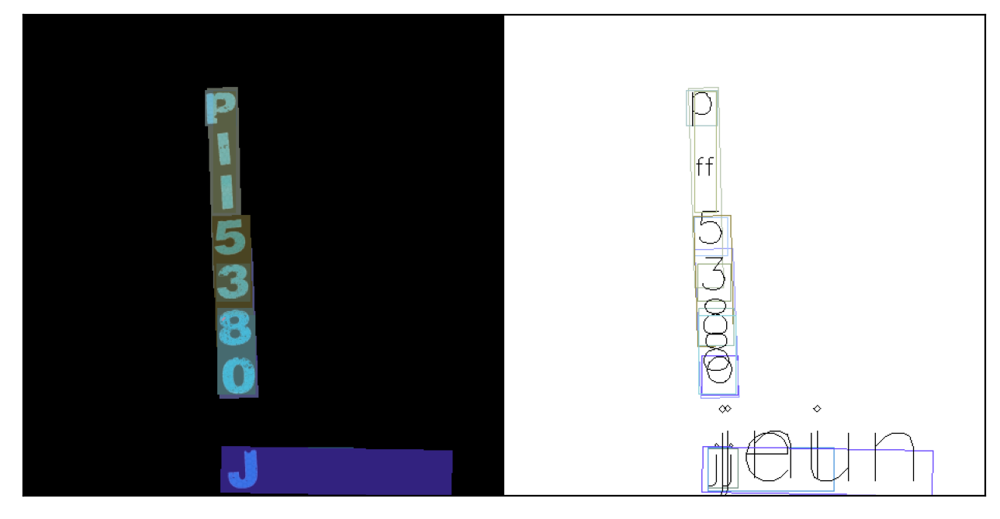

Use load_from_http loader
Use load_from_http loader
MaskRCNN_IC17 CRNN_TPS text: [{'filename': '0', 'text': ['0', 'g', '5', 'ws', 'e', 'e', 'e', '3', '8', 'e', 'c', 'j', 'j']}]


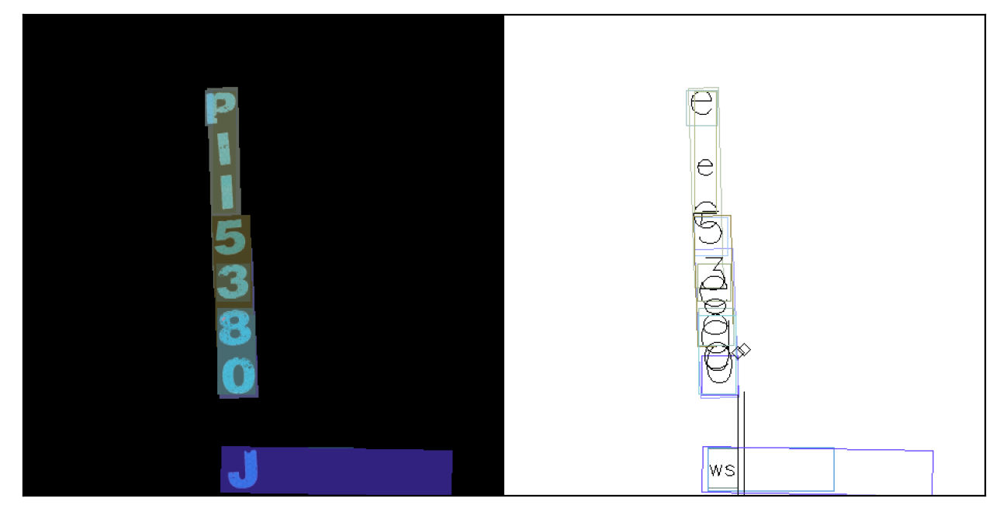

Use load_from_http loader


Downloading: "https://download.openmmlab.com/mmocr/textdet/panet/panet_r18_fpem_ffm_sbn_600e_ctw1500_20210219-3b3a9aa3.pth" to /home/dusty/.cache/torch/hub/checkpoints/panet_r18_fpem_ffm_sbn_600e_ctw1500_20210219-3b3a9aa3.pth


  0%|          | 0.00/44.0M [00:00<?, ?B/s]

Use load_from_http loader
PANet_CTW CRNN text: [{'filename': '0', 'text': ['p', '']}]


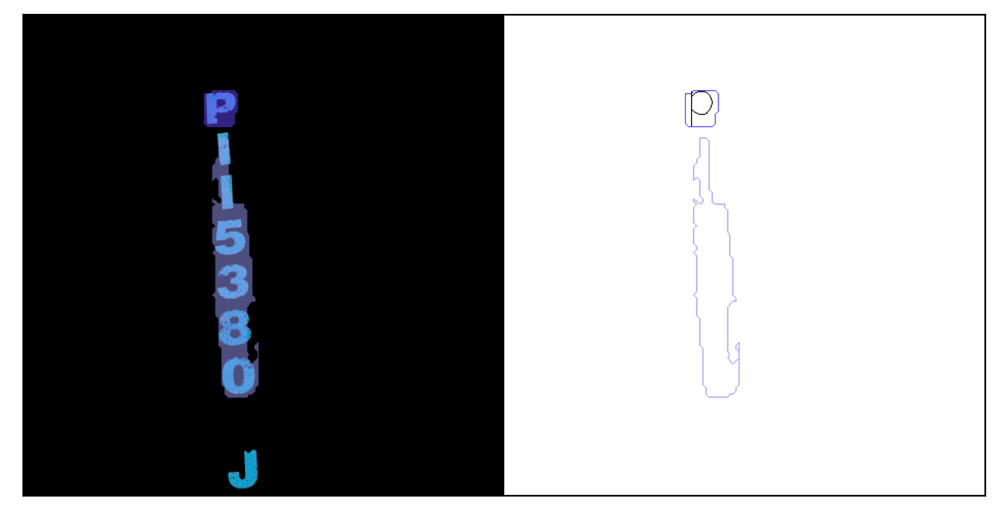

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PANet_CTW SAR text: [{'filename': '0', 'text': ['IP', 'Organization:']}]


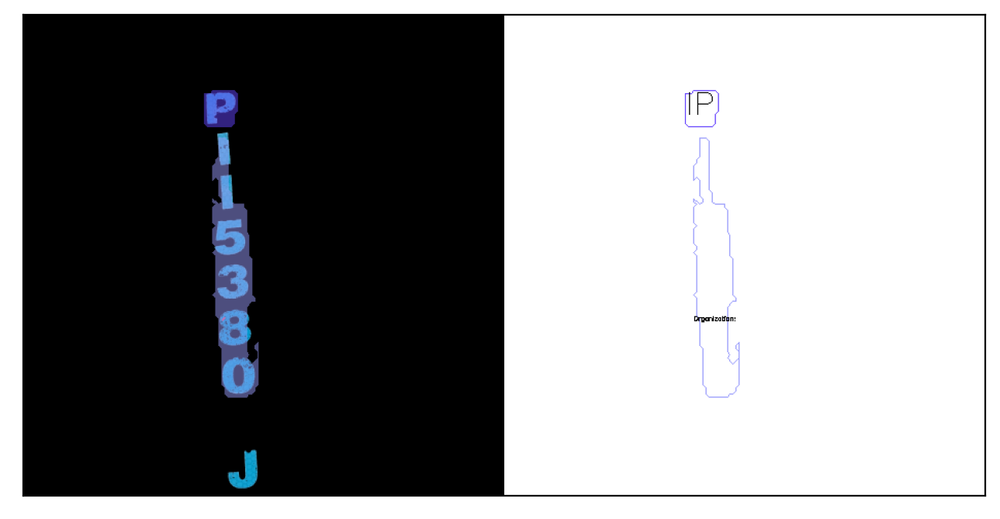

Use load_from_http loader
Use load_from_http loader
PANet_CTW NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['Q', 'Message-ID:']}]


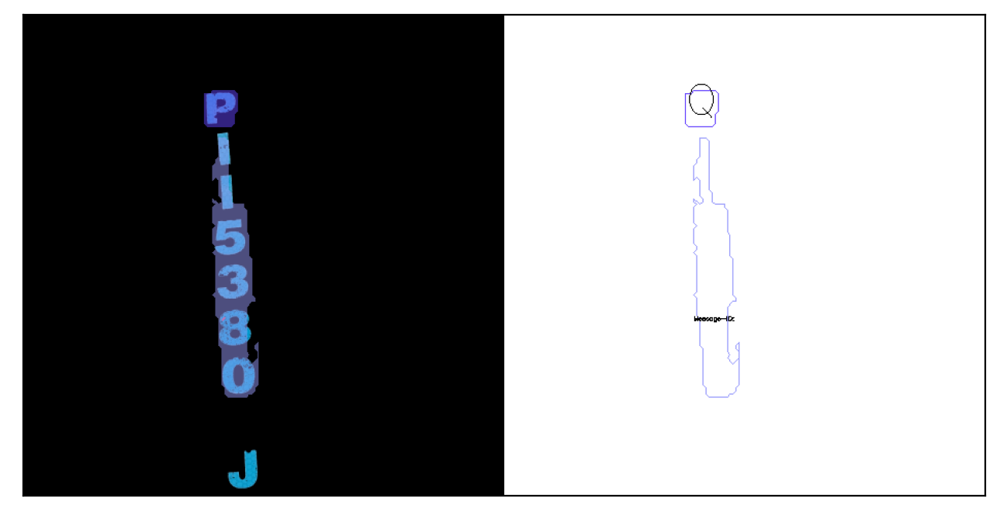

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PANet_CTW NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['P', 'Message-ID:']}]


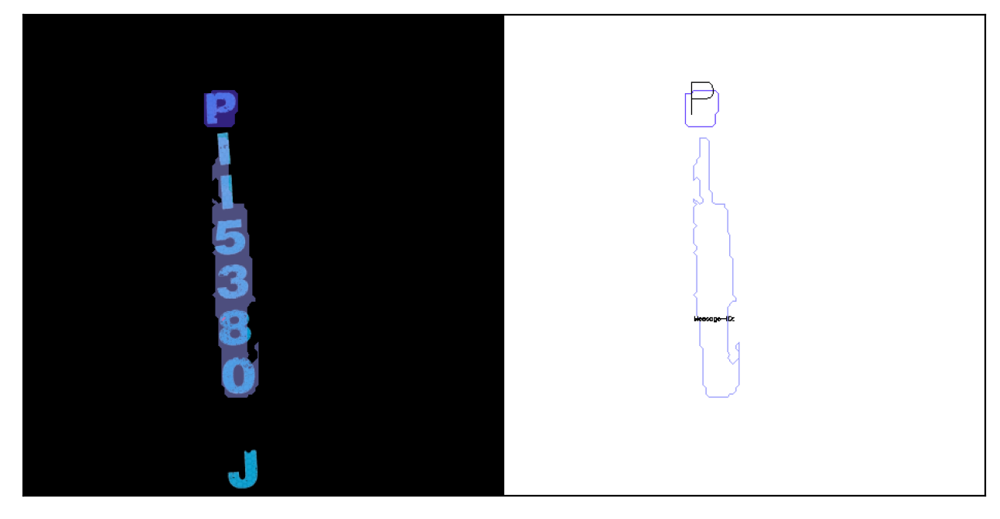

Use load_from_http loader
Use load_from_http loader
PANet_CTW SEG text: [{'filename': '0', 'text': ['p', 'e']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


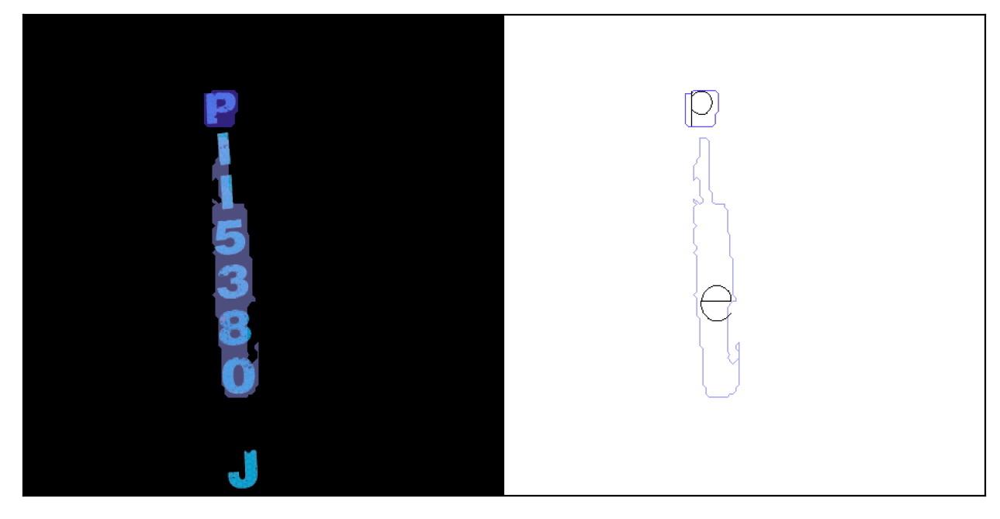

Use load_from_http loader
Use load_from_http loader
PANet_CTW CRNN_TPS text: [{'filename': '0', 'text': ['e', '']}]


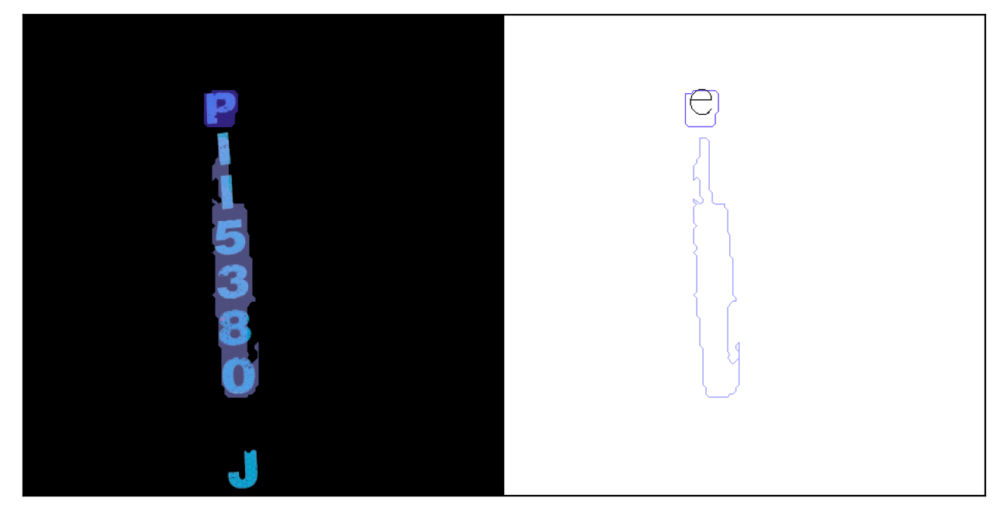

Use load_from_http loader
Use load_from_http loader
PANet_IC15 CRNN text: [{'filename': '0', 'text': ['a', 'o']}]


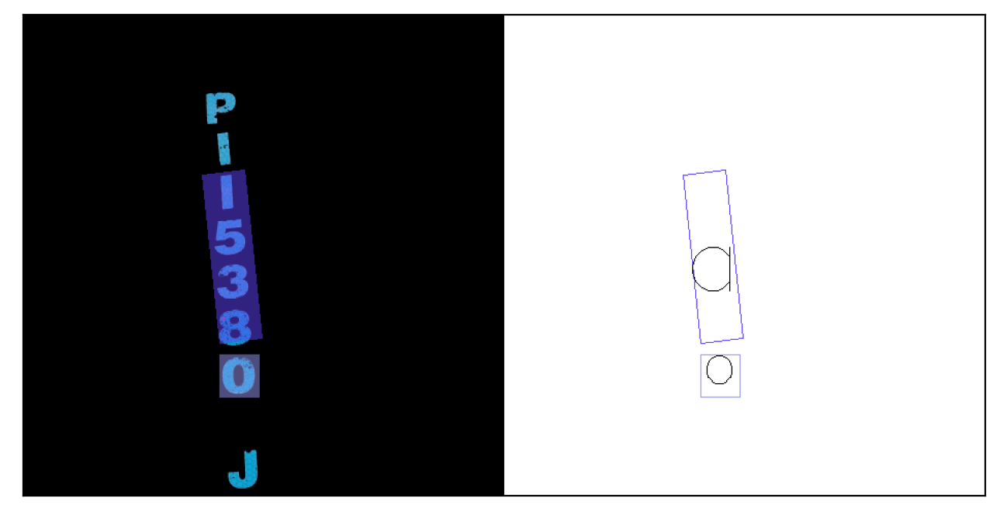

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PANet_IC15 SAR text: [{'filename': '0', 'text': ['Dandy', 'O']}]


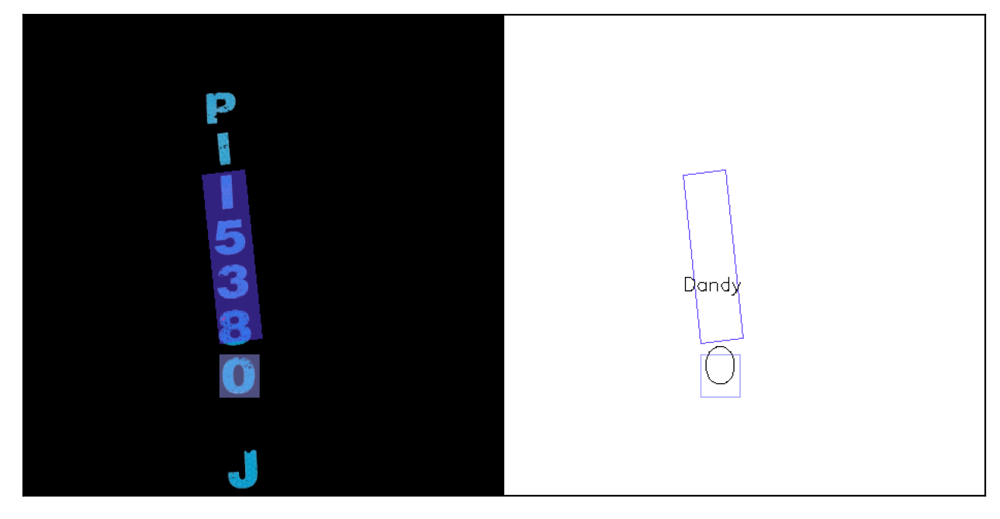

Use load_from_http loader
Use load_from_http loader
PANet_IC15 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['>>Hillo', 'a']}]


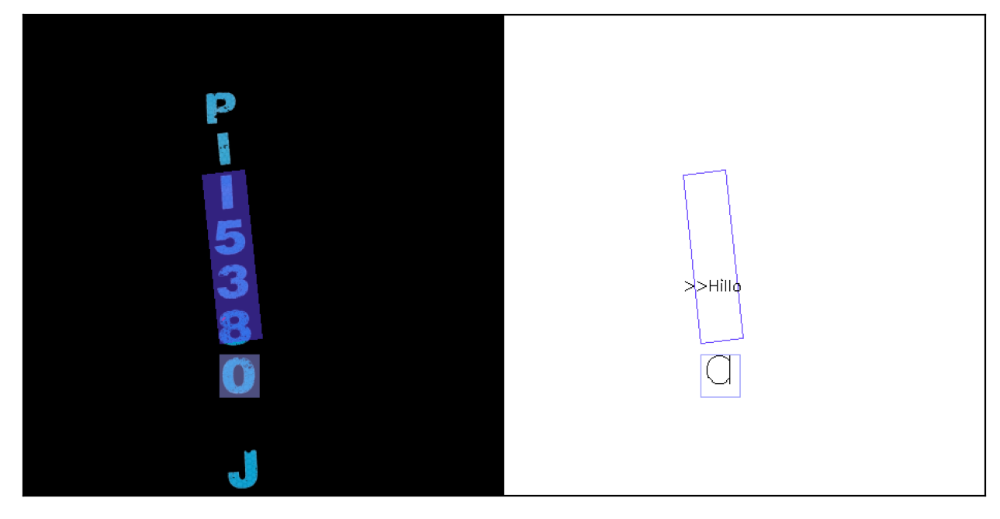

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PANet_IC15 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['--GMD', 'to']}]


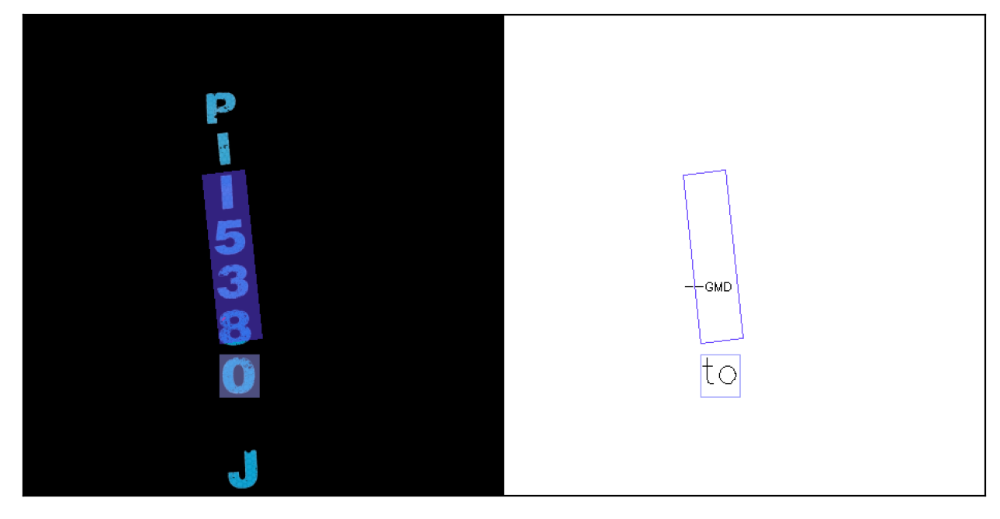

Use load_from_http loader
Use load_from_http loader
PANet_IC15 SEG text: [{'filename': '0', 'text': ['', 'af']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


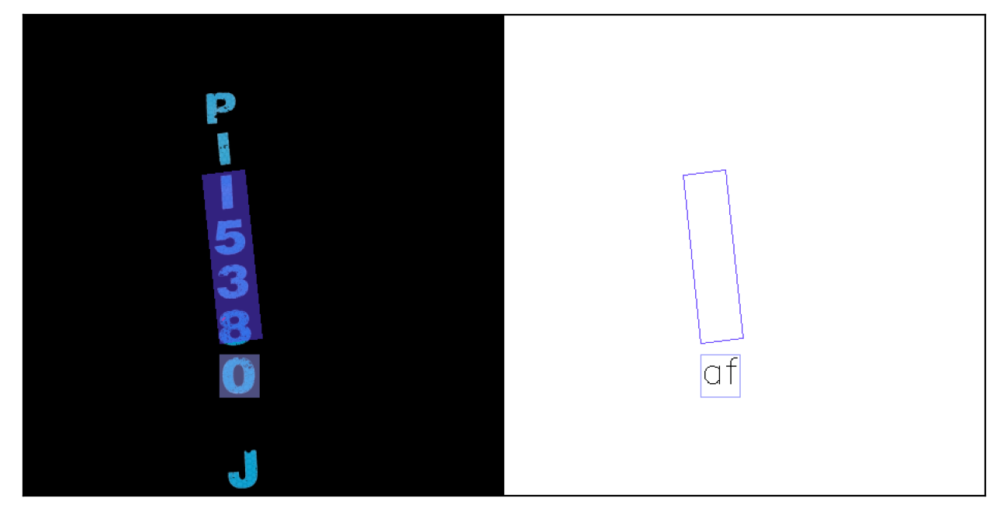

Use load_from_http loader
Use load_from_http loader
PANet_IC15 CRNN_TPS text: [{'filename': '0', 'text': ['e', 'o']}]


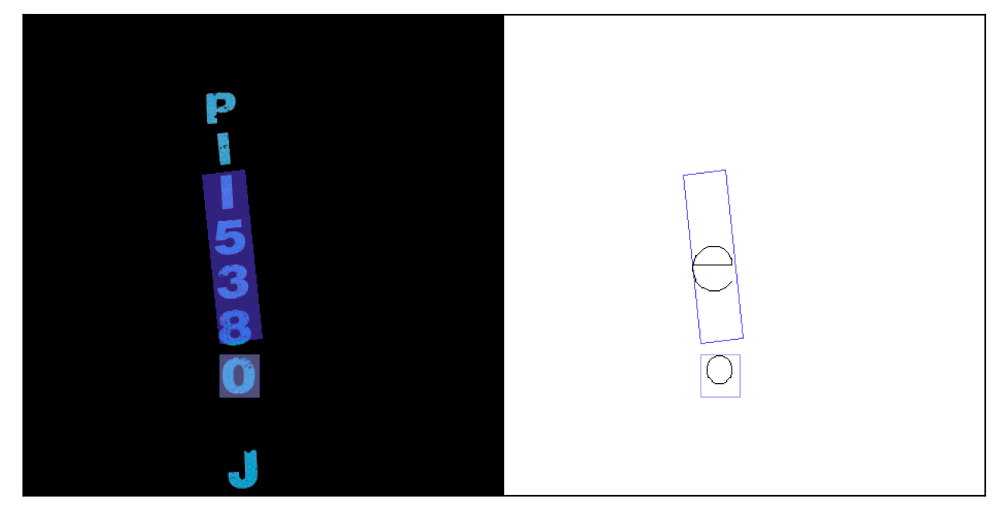

Use load_from_http loader


Downloading: "https://download.openmmlab.com/mmocr/textdet/psenet/psenet_r50_fpnf_600e_ctw1500_20210401-216fed50.pth" to /home/dusty/.cache/torch/hub/checkpoints/psenet_r50_fpnf_600e_ctw1500_20210401-216fed50.pth


  0%|          | 0.00/109M [00:00<?, ?B/s]

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


Use load_from_http loader
PS_CTW CRNN text: [{'filename': '0', 'text': ['p', '']}]


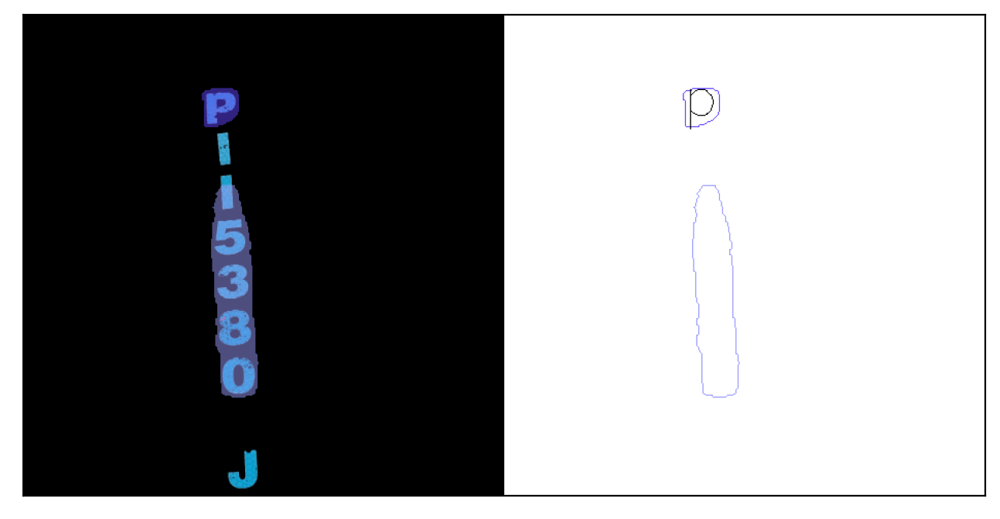

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_CTW SAR text: [{'filename': '0', 'text': ['Q', 'oam']}]


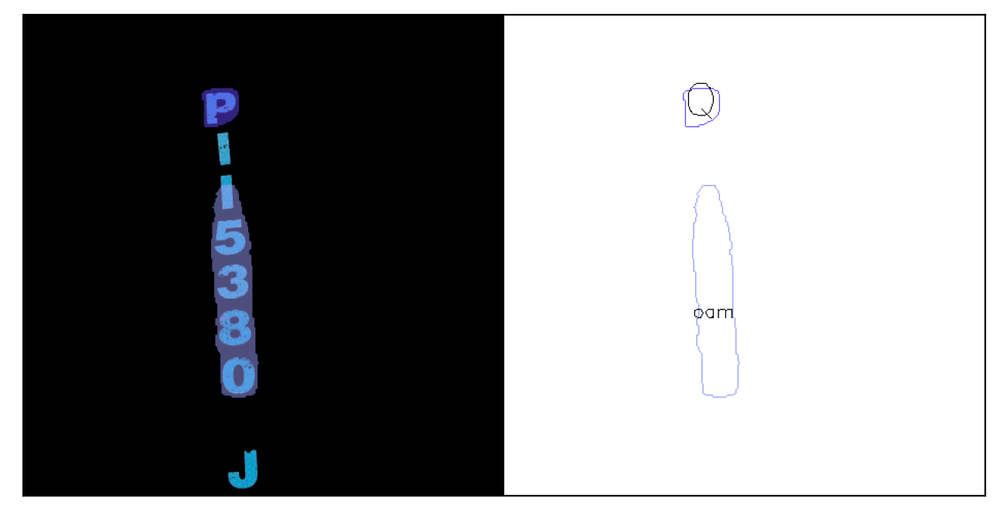

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_CTW NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['Q', 'Message-ID:']}]


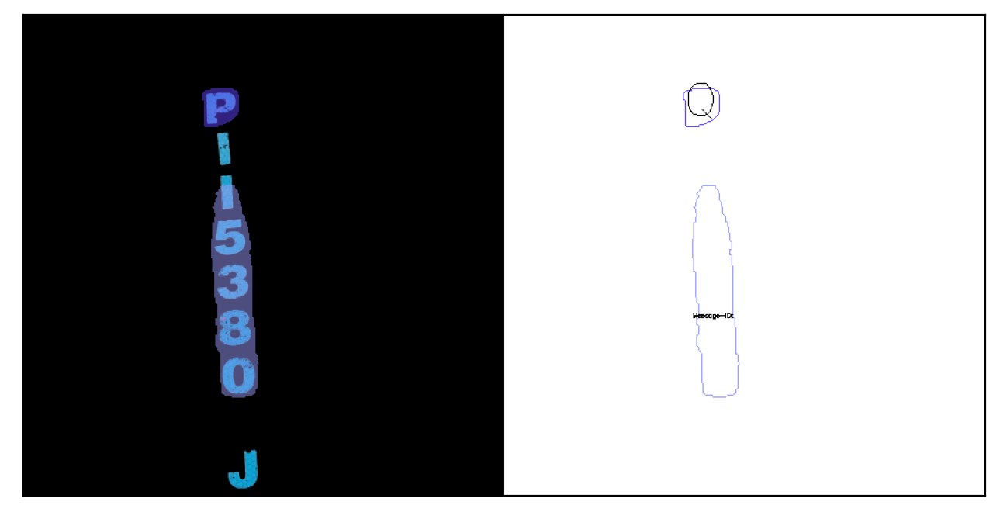

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_CTW NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['P', '-071100']}]


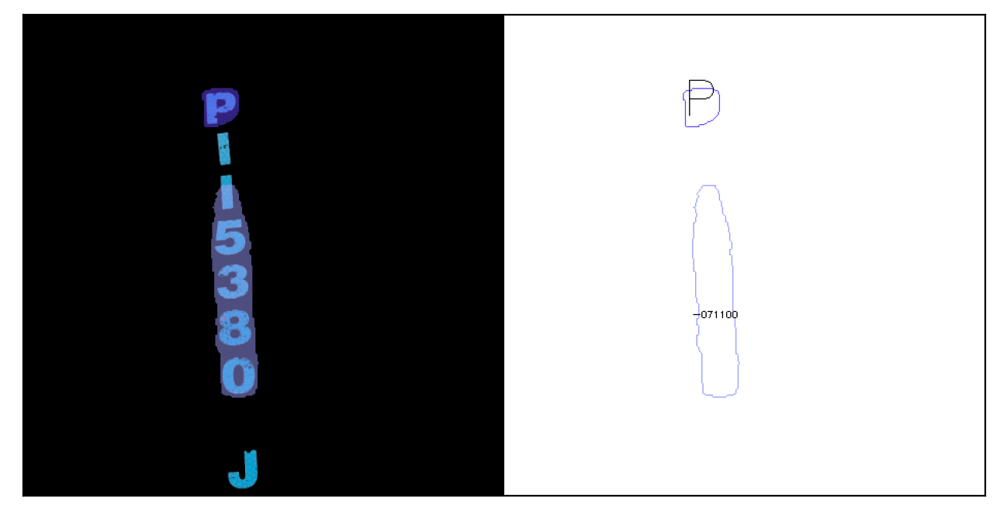

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


PS_CTW SEG text: [{'filename': '0', 'text': ['p', 'e']}]


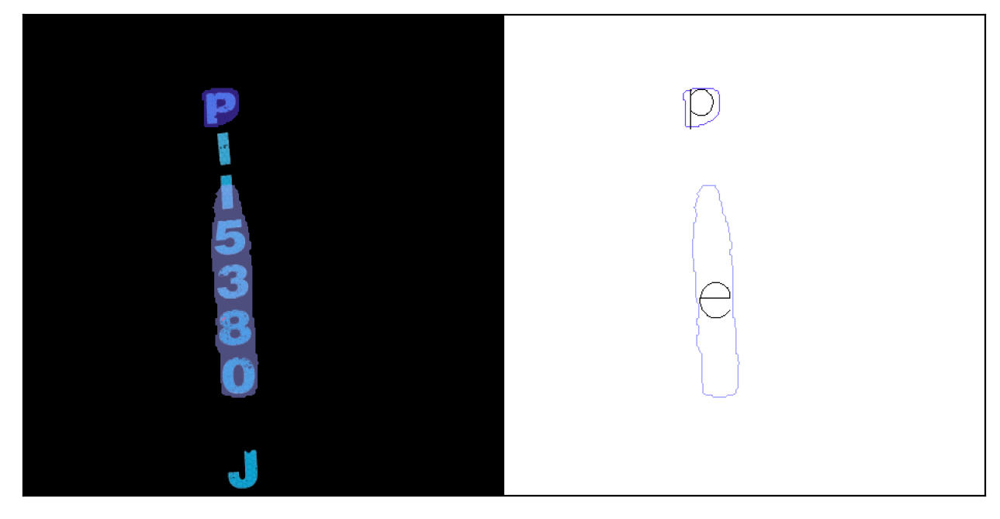

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_CTW CRNN_TPS text: [{'filename': '0', 'text': ['p', '']}]


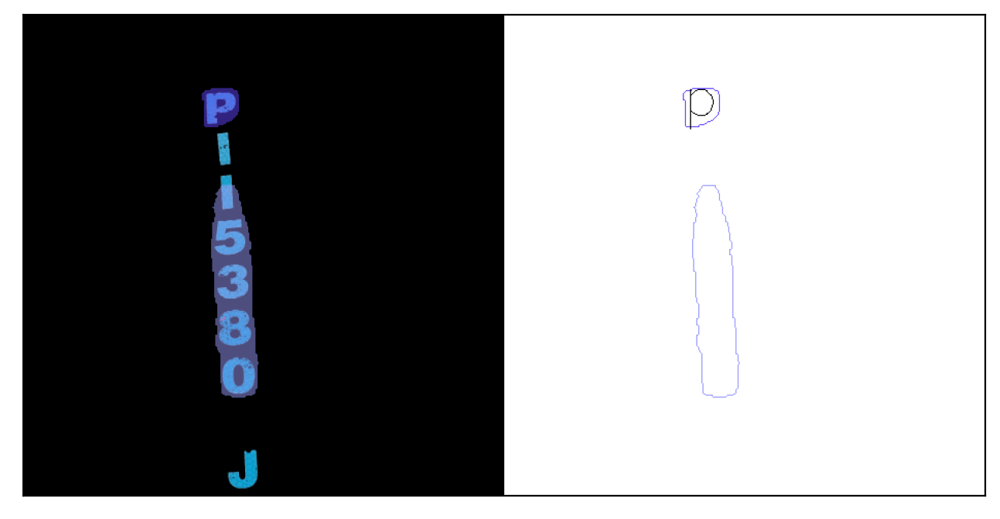

Use load_from_http loader


Downloading: "https://download.openmmlab.com/mmocr/textdet/psenet/psenet_r50_fpnf_600e_icdar2015_pretrain-eefd8fe6.pth" to /home/dusty/.cache/torch/hub/checkpoints/psenet_r50_fpnf_600e_icdar2015_pretrain-eefd8fe6.pth


  0%|          | 0.00/109M [00:00<?, ?B/s]

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


Use load_from_http loader
PS_IC15 CRNN text: [{'filename': '0', 'text': ['p', 's', 'o', 'j']}]


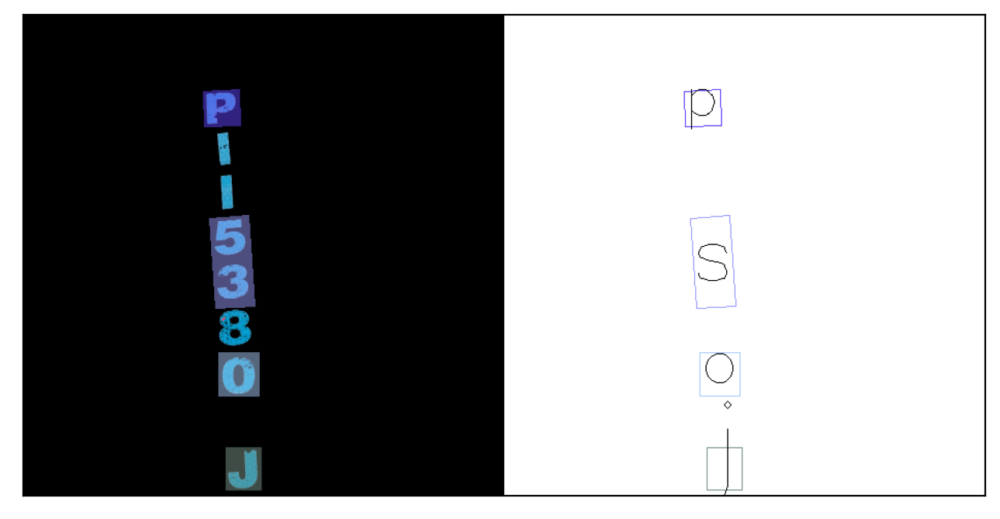

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_IC15 SAR text: [{'filename': '0', 'text': ['P', 'and', 'POPPY', 'J']}]


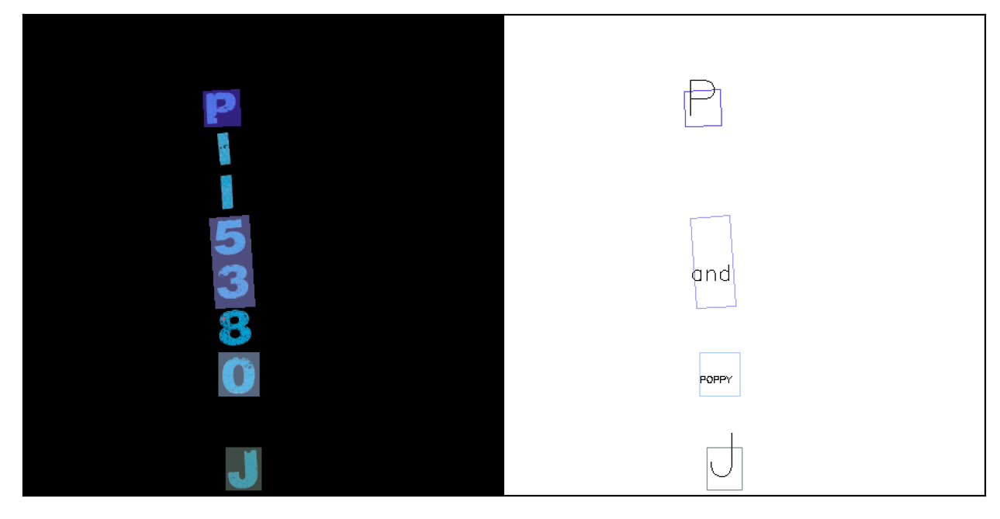

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_IC15 NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['P', '1993', 'a', 'J']}]


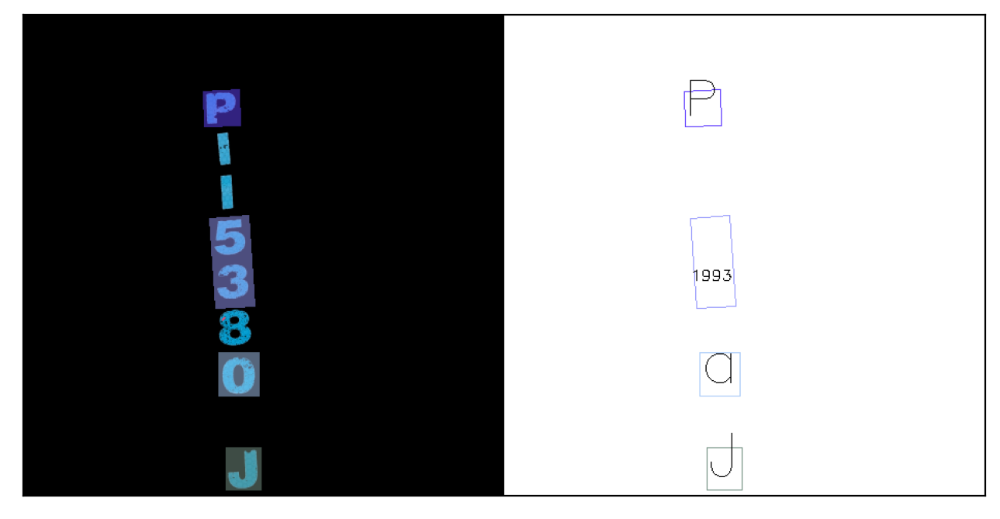

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_IC15 NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['P', '1993', 'a', 'J']}]


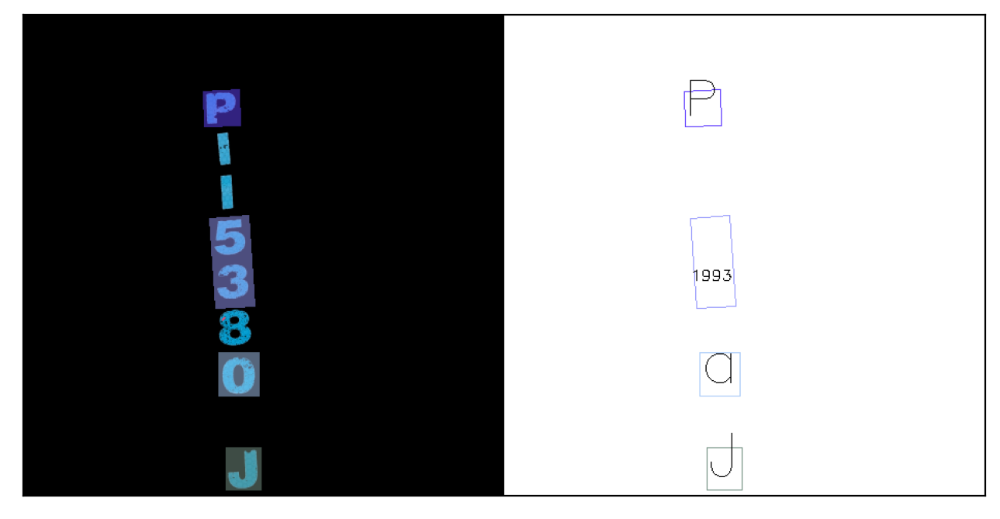

Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


PS_IC15 SEG text: [{'filename': '0', 'text': ['p', '', 'oi', 'j']}]


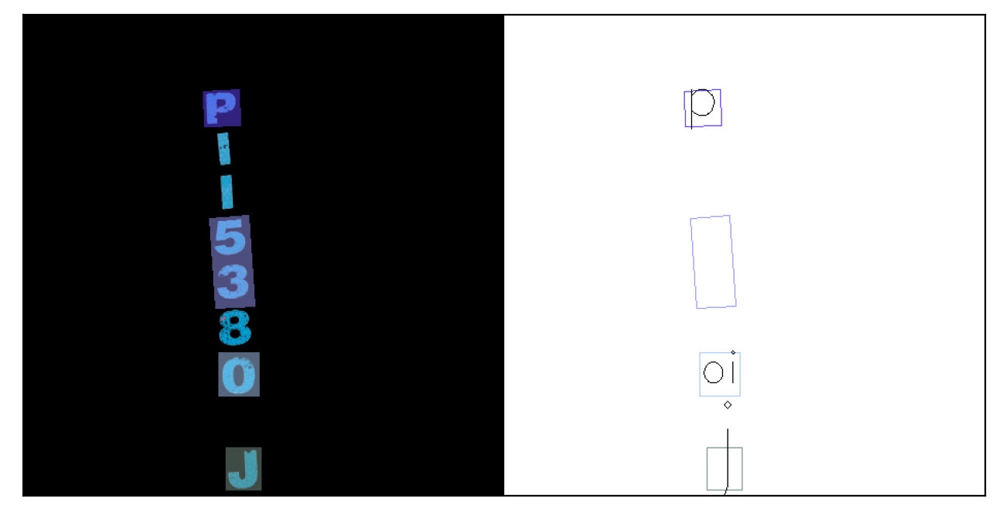

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


PS_IC15 CRNN_TPS text: [{'filename': '0', 'text': ['p', 'z', '0', 'j']}]


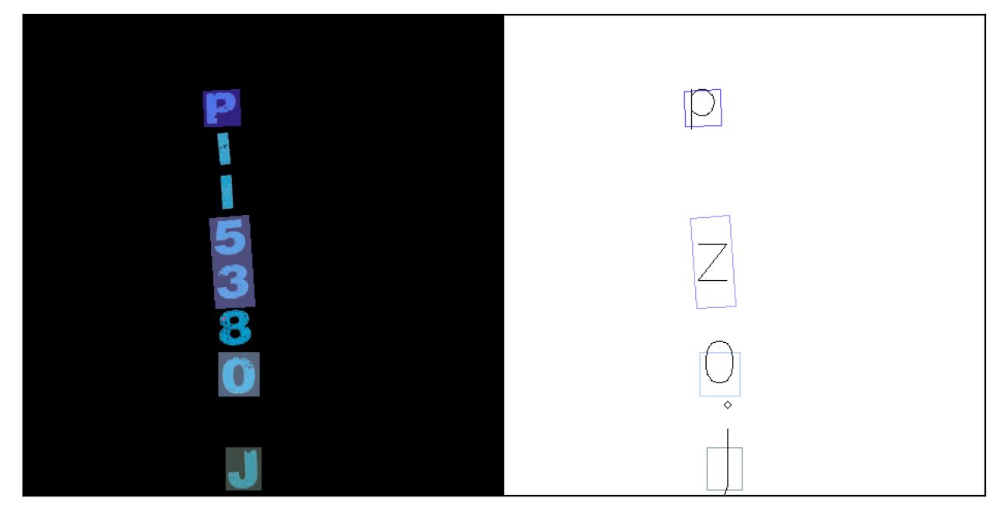

Use load_from_http loader
Use load_from_http loader


/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = canvas[1:h + 1, 1:w + 1].astype(np.bool)


TextSnake CRNN text: [{'filename': '0', 'text': ['']}]


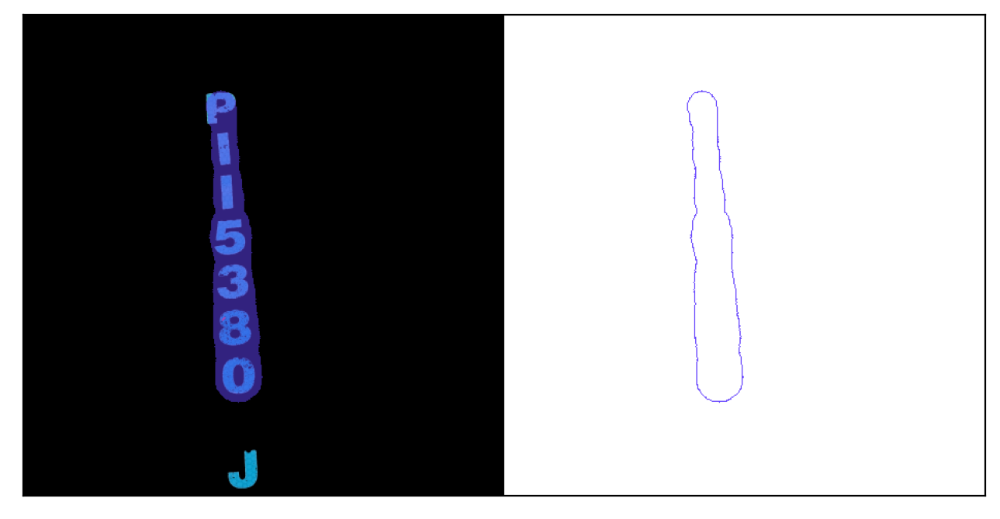

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

TextSnake SAR text: [{'filename': '0', 'text': ['during']}]


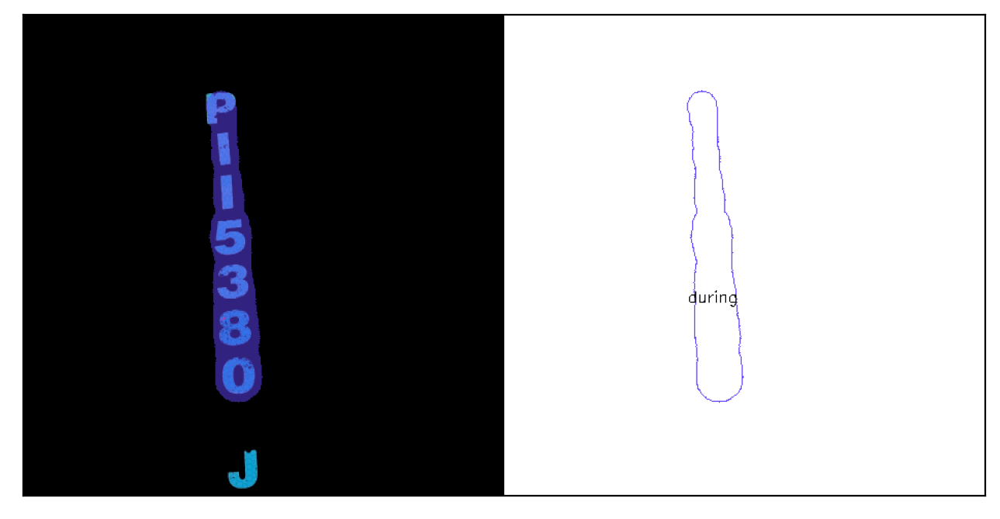

Use load_from_http loader
Use load_from_http loader
TextSnake NRTR_1/16-1/8 text: [{'filename': '0', 'text': ['Lanthing']}]


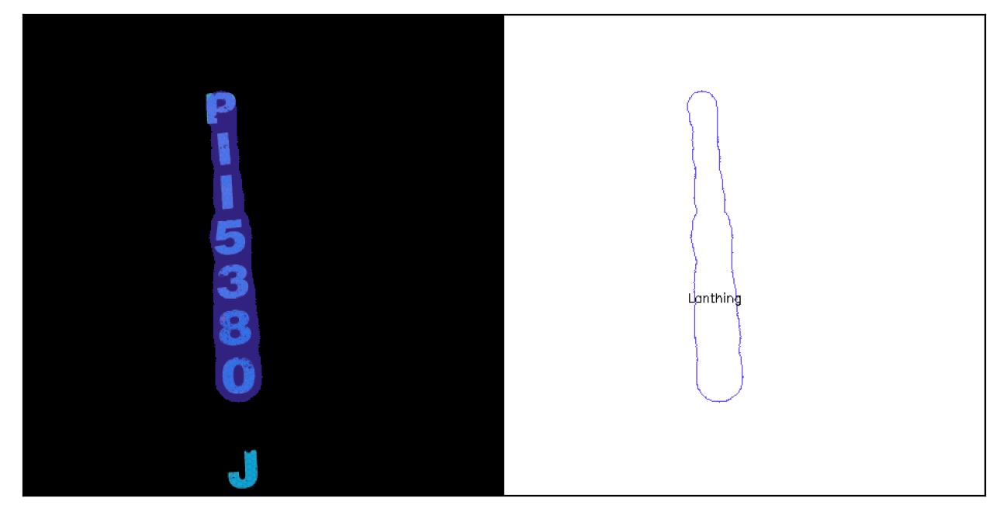

Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/apis/inference.py:47: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/datasets/utils.py:64: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
/home/dusty/work/mmocr/mmocr/models/textdet/postprocess/wrapper.py:240: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  canvas = 

TextSnake NRTR_1/8-1/4 text: [{'filename': '0', 'text': ['Message-ID:']}]


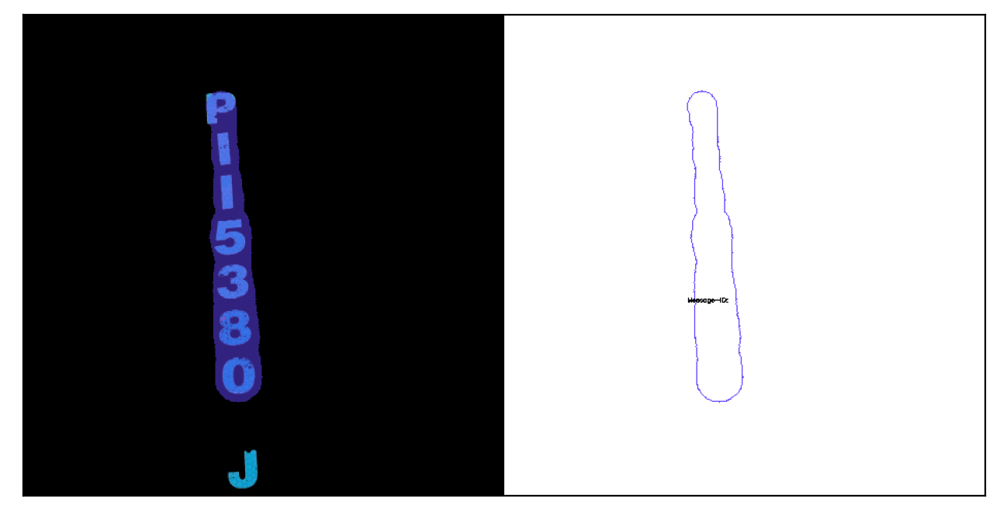

Use load_from_http loader
Use load_from_http loader
TextSnake SEG text: [{'filename': '0', 'text': ['']}]


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/torch/nn/functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "


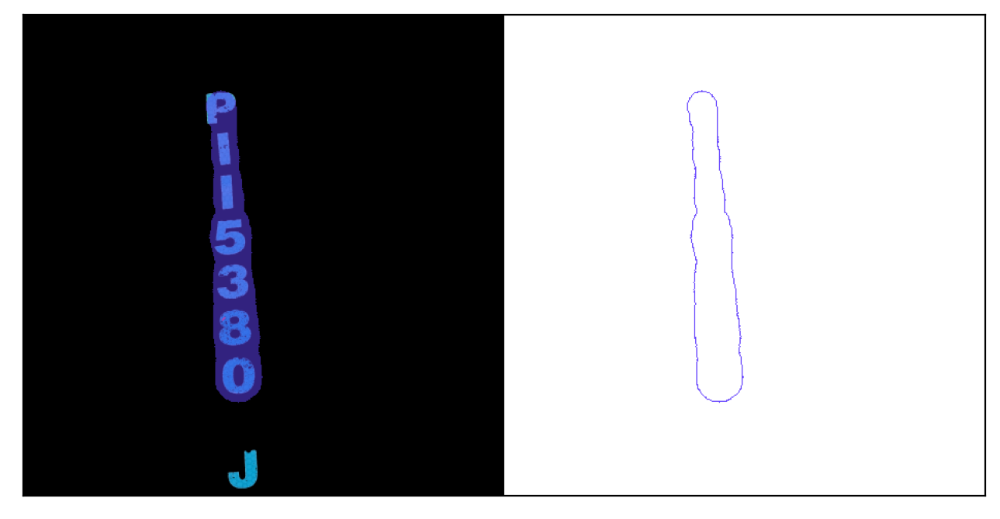

Use load_from_http loader
Use load_from_http loader
TextSnake CRNN_TPS text: [{'filename': '0', 'text': ['z']}]


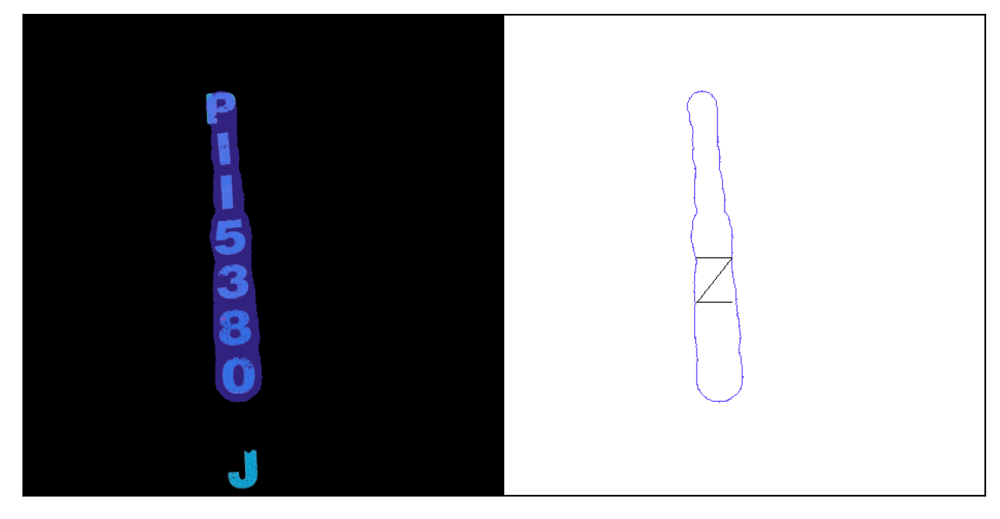

In [445]:
from itertools import combinations

detectors = ["DB_r18", "DB_r50", "DRRG", "FCE_IC15", "FCE_CTW_DCNv2", "MaskRCNN_CTW",
			 "MaskRCNN_IC15", "MaskRCNN_IC17", "PANet_CTW", "PANet_IC15", "PS_CTW", "PS_IC15", "TextSnake"]
recognizers = ["CRNN", "SAR", "NRTR_1/16-1/8", "NRTR_1/8-1/4", "SEG", "CRNN_TPS"] # "RobustScanner" broken


for detector in detectors:
	for recognizer in recognizers:
		det_image = colored_portion.copy()
		det_image = cv2.cvtColor(det_image, cv2.COLOR_RGB2BGR)

		scale_percent = 20 # percent of original size
		width = int(img.shape[1] * scale_percent / 100)
		height = int(img.shape[0] * scale_percent / 100)
		dim = (width, height)
		det_image = cv2.resize(det_image, dim, interpolation = cv2.INTER_AREA)
		# show_image(det_image)

		ocr = MMOCR(det=detector, recog=recognizer)
		text = ocr.readtext(det_image, output = "./")
		print(f"{detector} {recognizer} text: {text}")
		resulting = cv2.imread("out_0.png")
		show_image(resulting)

/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/builder.py:15: UserWarning: ``build_anchor_generator`` would be deprecated soon, please use ``build_prior_generator`` 
  warnings.warn(


Use load_from_http loader
Use load_from_http loader


/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:323: UserWarning: ``grid_anchors`` would be deprecated soon. Please use ``grid_priors`` 
  warnings.warn('``grid_anchors`` would be deprecated soon. '
/home/dusty/anaconda3/envs/chamber/lib/python3.8/site-packages/mmdet/core/anchor/anchor_generator.py:359: UserWarning: ``single_level_grid_anchors`` would be deprecated soon. Please use ``single_level_grid_priors`` 
  warnings.warn(


MaskRCNN_IC17 CRNN text: [{'filename': '0', 'text': ['o', '', '5', 'j', '', 's', 'p', '3', '8', '', 's', 'j', 'j']}]


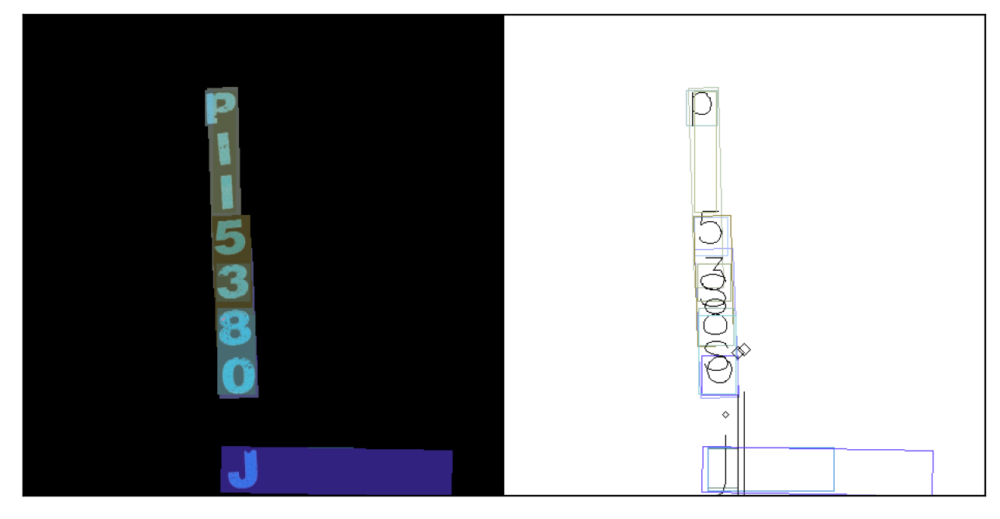

In [446]:
det_image = colored_portion.copy()
det_image = cv2.cvtColor(det_image, cv2.COLOR_RGB2BGR)

scale_percent = 20 # percent of original size
width = int(img.shape[1] * scale_percent / 100)
height = int(img.shape[0] * scale_percent / 100)
dim = (width, height)
det_image = cv2.resize(det_image, dim, interpolation = cv2.INTER_AREA)
# show_image(det_image)

ocr = MMOCR(det="MaskRCNN_IC17", recog="CRNN")
text = ocr.readtext(det_image, output = "./")
print(f"MaskRCNN_IC17 CRNN text: {text}")
resulting = cv2.imread("out_0.png")
show_image(resulting)